<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_10_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [ ]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [ ]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [ ]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [ ]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [ ]:
%cd '/dataset unzipped'

/dataset unzipped


In [ ]:
def crop_brain_contour(image, plot=False):
    
    # Add brightness to images
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)

    # Convert the image to grayscale, and blur it slightly
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
   
    return new_image,extLeft,extRight,extTop,extBot

In [ ]:
#Hyperparameters 
image_size = 224
BATCH_SIZE = 32
hyper_channels = 3

In [ ]:
#Bounding box with one tumor
#Define the name of the 3 classes of MRI
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
#Define the list of images for the training
X_train = []
count = 0;
#Lists of coordinates for resizing bounding box
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

#Loading training images
for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_train.append(image)

#Load train bounding box labels
image_index = 0
#Define the list of bb coordinates for the training images
bb_list = []
#List used to duplicate images with two bounding box
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count]
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the train list before image duplication:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimension of the list after image duplication:
print('Dimension of the train list after image duplication:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

#Load test images
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_test.append(image_test)

#Load the bounding box labels for testing
image_index = 0
count_test = 0;
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                
                #rescaling the bounding box to the correct position after crop
                temp_array[0] = temp_array[0]*images_width_test[count_test] 
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the test list before image duplication:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

print('Dimension of the test list after image duplication:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))  


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [ ]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [ ]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [ ]:
#Shuffle of the train dataset
X_train, bb_train = shuffle(X_train, bb_train)

In [ ]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [ ]:
tf.keras.backend.set_image_data_format('channels_last')
#Creation of the three data generator datasets to feed the model with batches of data during the training process
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [ ]:
#Function to define the IoU metrics
def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):

        #define the true and predicted coordinates (height and width)
        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
        #Define the bb true area 
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height 


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)

        results.append(iou)
    return np.mean(results)

# metric creation
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [ ]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in red the real bounding box
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in green the predicted bounding box
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [ ]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [ ]:
#change folder to create the folder for saving the model
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [ ]:
#list of callbacks
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [ ]:
input_ = Input(shape=[image_size,image_size, hyper_channels])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

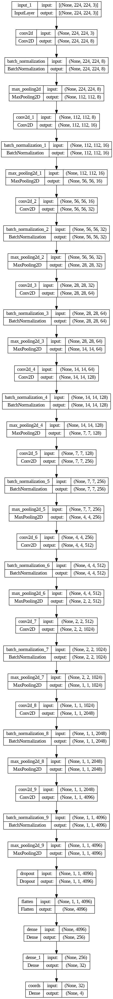

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True)

In [ ]:
%cd '../../..'
%cd '/dataset unzipped'

In [ ]:
#plot the feature extraction for the first 10 layers of the neural network
from keras.models import Model
img_path='./axial_t1wce_2_class/images/train/00095_224.jpg' 
# Output= intermediate representations for all layers in the  
# previous model after the first.
successive_outputs = [layer.output for layer in model.layers[1:10]]
visualization_model = Model(inputs = model.input, outputs = successive_outputs)
#Load the input image
img = tf.keras.utils.load_img(img_path, target_size=(224, 224))
# Convert ht image to Array of dimension (image_size,image_size,hyper_channels)
x   = tf.keras.utils.img_to_array(img)
np.dot(x, [0.299, 0.587, 0.144])
print(x.shape)                         
x   = x.reshape((1,) + x.shape)# Rescale by 1/255
x /= 255.0
# Let's run input image through our visualization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  #print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    #tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be better visualized
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

In [ ]:
#Compilation of the model
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 41.9324 - IoU: 0.0402
Epoch 1: val_IoU improved from -inf to 0.00292, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 95ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


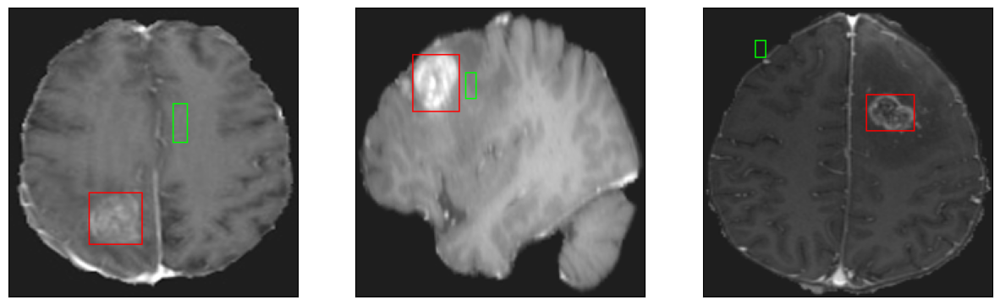

26/26 [==============================] - 47s 1s/step - loss: 41.9324 - IoU: 0.0402 - val_loss: 44.5952 - val_IoU: 0.0029
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 26.4234 - IoU: 0.0668
Epoch 2: val_IoU improved from 0.00292 to 0.01813, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


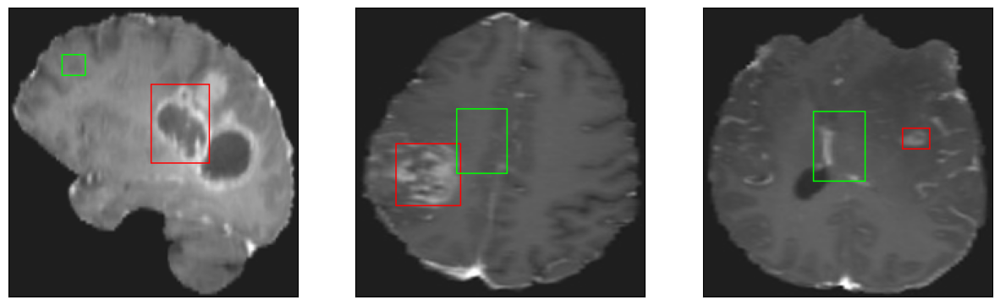

26/26 [==============================] - 23s 913ms/step - loss: 26.4234 - IoU: 0.0668 - val_loss: 41.7194 - val_IoU: 0.0181
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 25.5838 - IoU: 0.0744
Epoch 3: val_IoU improved from 0.01813 to 0.02408, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


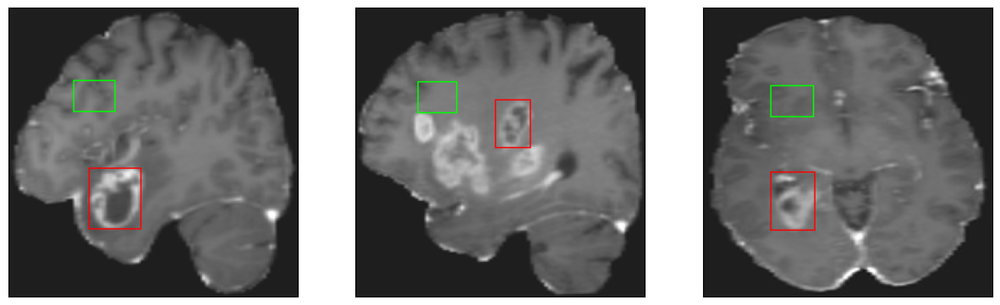

26/26 [==============================] - 19s 739ms/step - loss: 25.5838 - IoU: 0.0744 - val_loss: 34.5845 - val_IoU: 0.0241
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 24.7716 - IoU: 0.0870
Epoch 4: val_IoU improved from 0.02408 to 0.03141, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


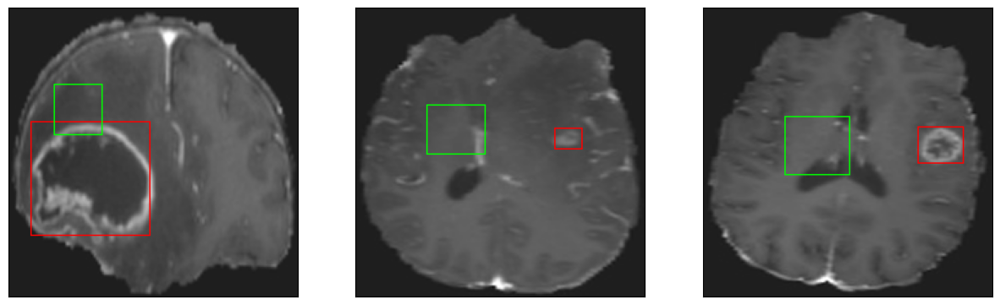

26/26 [==============================] - 13s 507ms/step - loss: 24.7716 - IoU: 0.0870 - val_loss: 33.3740 - val_IoU: 0.0314
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 21.9962 - IoU: 0.1392
Epoch 5: val_IoU improved from 0.03141 to 0.06855, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


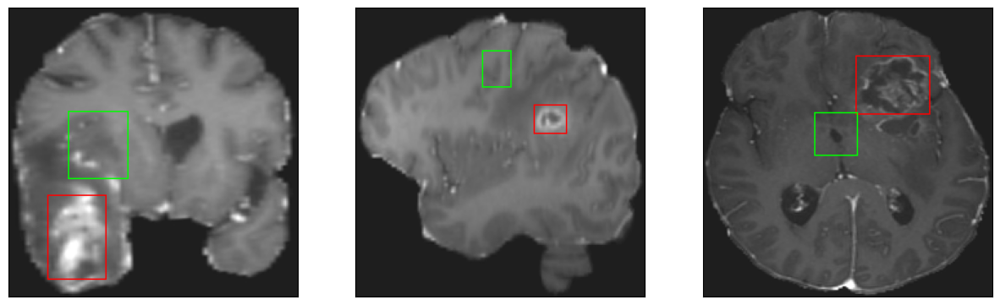

26/26 [==============================] - 14s 564ms/step - loss: 21.9962 - IoU: 0.1392 - val_loss: 26.9494 - val_IoU: 0.0685
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 21.5977 - IoU: 0.1512
Epoch 6: val_IoU improved from 0.06855 to 0.11111, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


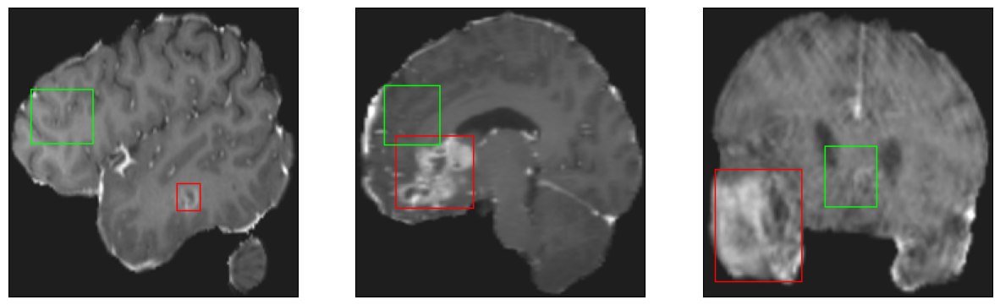

26/26 [==============================] - 13s 515ms/step - loss: 21.5977 - IoU: 0.1512 - val_loss: 24.2499 - val_IoU: 0.1111
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 18.8299 - IoU: 0.2063
Epoch 7: val_IoU did not improve from 0.11111
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


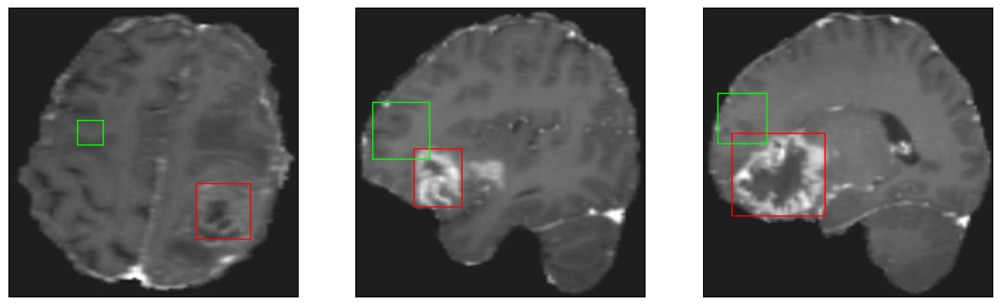

26/26 [==============================] - 7s 270ms/step - loss: 18.8299 - IoU: 0.2063 - val_loss: 27.2140 - val_IoU: 0.0708
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 17.6840 - IoU: 0.2189
Epoch 8: val_IoU improved from 0.11111 to 0.11266, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


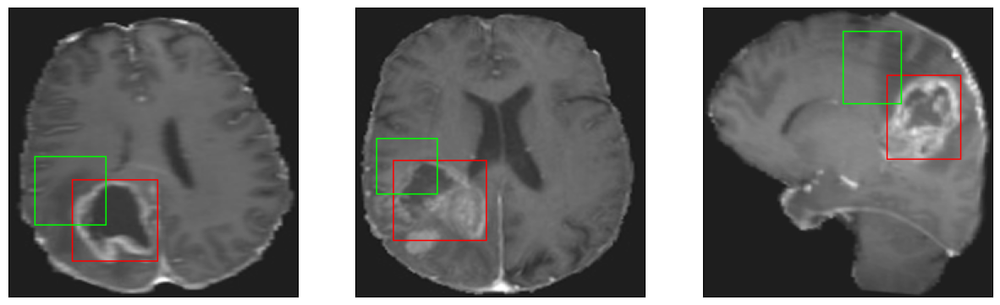

26/26 [==============================] - 14s 543ms/step - loss: 17.6840 - IoU: 0.2189 - val_loss: 23.3020 - val_IoU: 0.1127
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 16.4529 - IoU: 0.2675
Epoch 9: val_IoU improved from 0.11266 to 0.25471, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


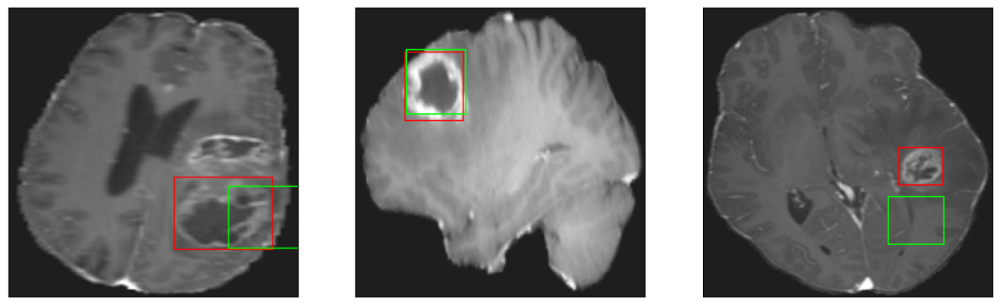

26/26 [==============================] - 29s 1s/step - loss: 16.4529 - IoU: 0.2675 - val_loss: 16.5713 - val_IoU: 0.2547
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 15.3720 - IoU: 0.2724
Epoch 10: val_IoU did not improve from 0.25471
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


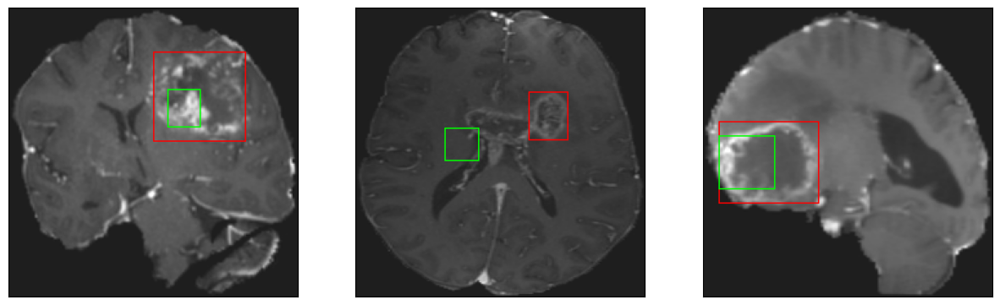

26/26 [==============================] - 7s 284ms/step - loss: 15.3720 - IoU: 0.2724 - val_loss: 18.8333 - val_IoU: 0.1818
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 14.8424 - IoU: 0.2751
Epoch 11: val_IoU did not improve from 0.25471
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4


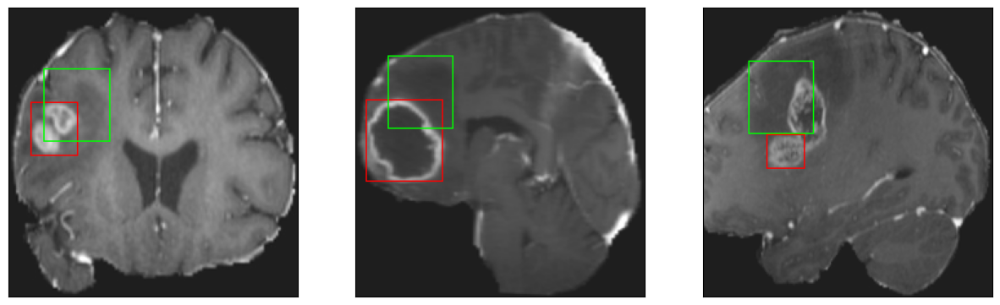

26/26 [==============================] - 8s 323ms/step - loss: 14.8424 - IoU: 0.2751 - val_loss: 21.4989 - val_IoU: 0.1493
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 14.2326 - IoU: 0.2973
Epoch 12: val_IoU did not improve from 0.25471
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


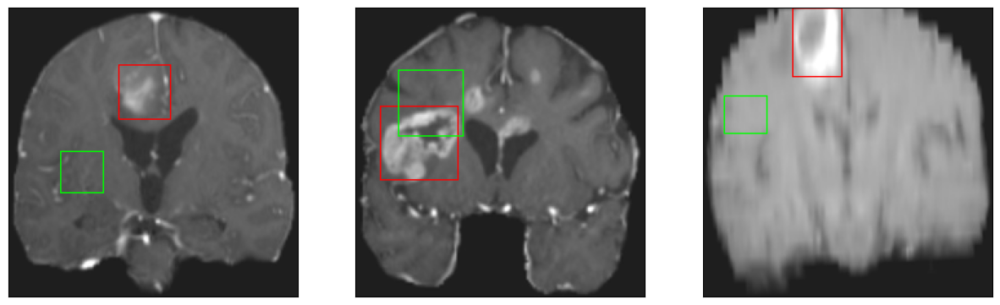

26/26 [==============================] - 7s 259ms/step - loss: 14.2326 - IoU: 0.2973 - val_loss: 15.0095 - val_IoU: 0.2499
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 13.6378 - IoU: 0.3125
Epoch 13: val_IoU did not improve from 0.25471
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


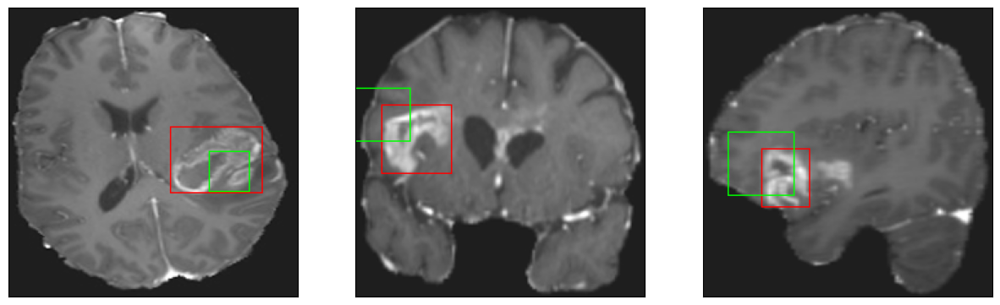

26/26 [==============================] - 7s 287ms/step - loss: 13.6378 - IoU: 0.3125 - val_loss: 16.6206 - val_IoU: 0.1953
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 13.0874 - IoU: 0.3180
Epoch 14: val_IoU improved from 0.25471 to 0.31711, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


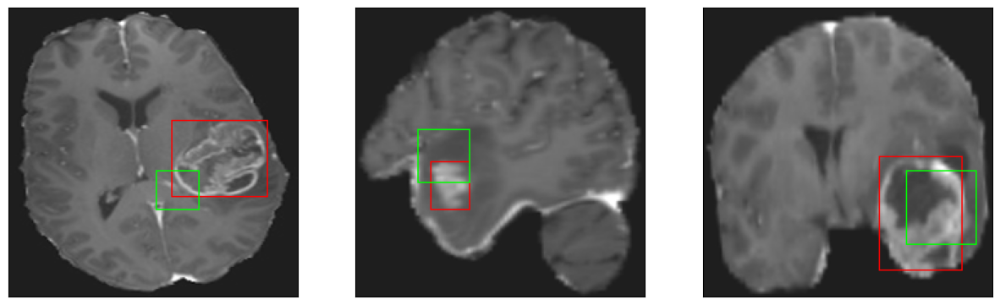

26/26 [==============================] - 29s 1s/step - loss: 13.0874 - IoU: 0.3180 - val_loss: 13.7950 - val_IoU: 0.3171
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 12.8382 - IoU: 0.3383
Epoch 15: val_IoU did not improve from 0.31711
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 44ms/step
4


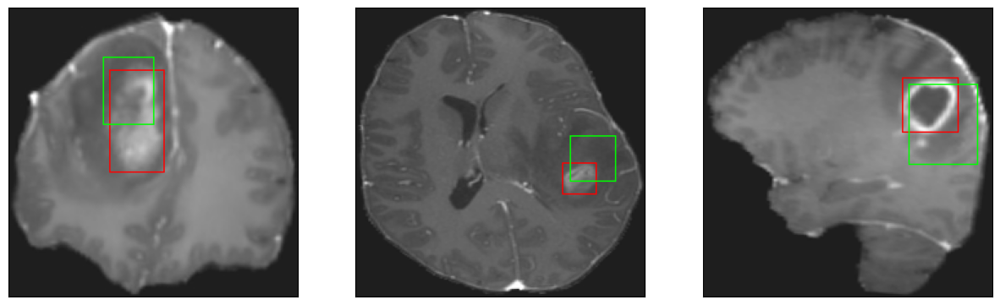

26/26 [==============================] - 8s 298ms/step - loss: 12.8382 - IoU: 0.3383 - val_loss: 14.8759 - val_IoU: 0.3091
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 12.6871 - IoU: 0.3260
Epoch 16: val_IoU improved from 0.31711 to 0.36157, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


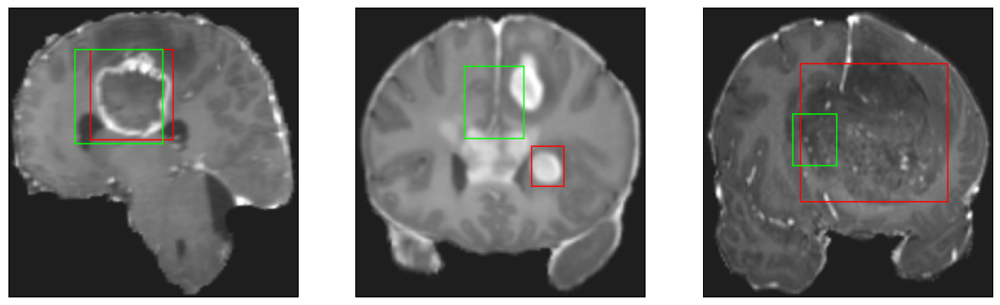

26/26 [==============================] - 13s 525ms/step - loss: 12.6871 - IoU: 0.3260 - val_loss: 12.1659 - val_IoU: 0.3616
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 12.0474 - IoU: 0.3477
Epoch 17: val_IoU did not improve from 0.36157
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


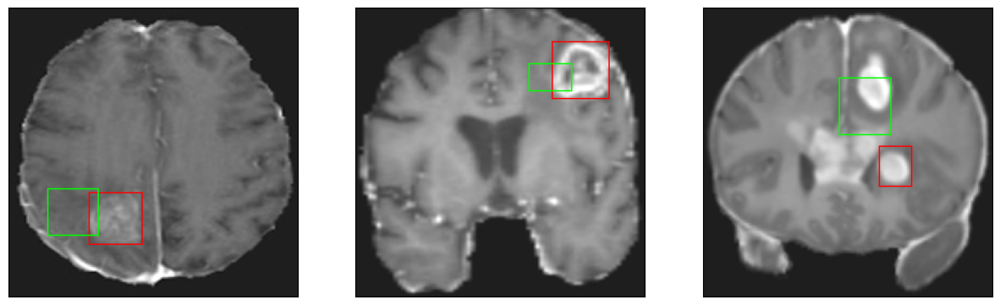

26/26 [==============================] - 8s 296ms/step - loss: 12.0474 - IoU: 0.3477 - val_loss: 15.3565 - val_IoU: 0.2589
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 12.0360 - IoU: 0.3495
Epoch 18: val_IoU did not improve from 0.36157
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


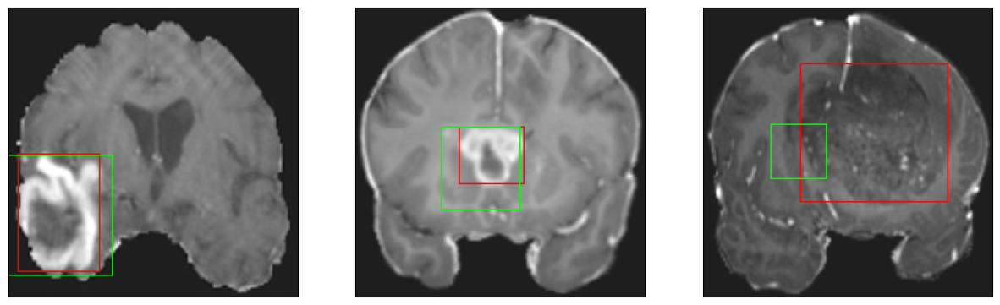

26/26 [==============================] - 7s 281ms/step - loss: 12.0360 - IoU: 0.3495 - val_loss: 15.8002 - val_IoU: 0.3238
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 11.4808 - IoU: 0.3628
Epoch 19: val_IoU improved from 0.36157 to 0.41468, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


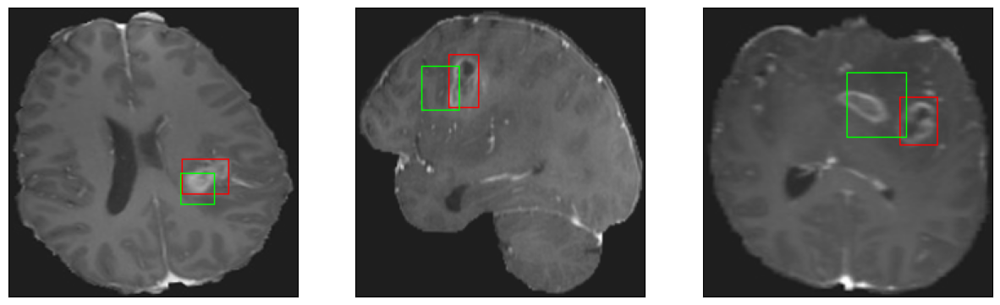

26/26 [==============================] - 23s 925ms/step - loss: 11.4808 - IoU: 0.3628 - val_loss: 11.2415 - val_IoU: 0.4147
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 11.9478 - IoU: 0.3482
Epoch 20: val_IoU did not improve from 0.41468
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


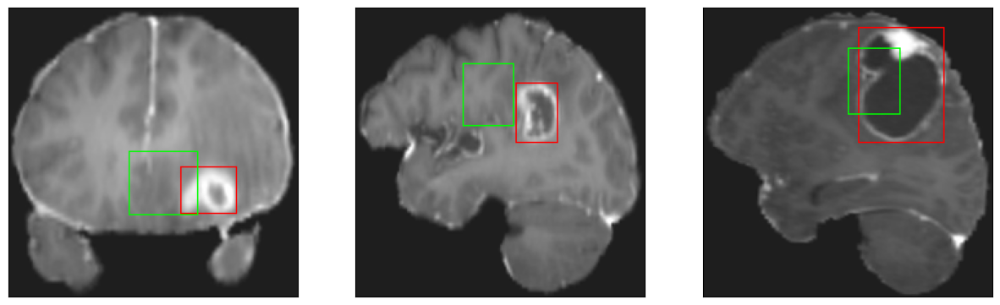

26/26 [==============================] - 7s 287ms/step - loss: 11.9478 - IoU: 0.3482 - val_loss: 15.0228 - val_IoU: 0.3319
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 11.1258 - IoU: 0.3725
Epoch 21: val_IoU did not improve from 0.41468
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


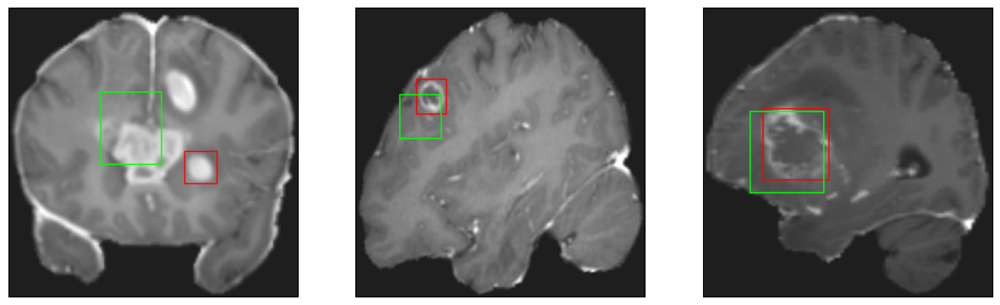

26/26 [==============================] - 7s 272ms/step - loss: 11.1258 - IoU: 0.3725 - val_loss: 13.5936 - val_IoU: 0.3359
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 10.5092 - IoU: 0.3892
Epoch 22: val_IoU did not improve from 0.41468
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


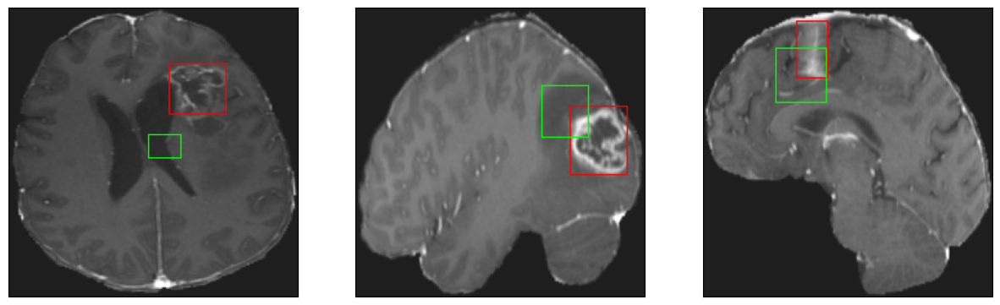

26/26 [==============================] - 7s 284ms/step - loss: 10.5092 - IoU: 0.3892 - val_loss: 12.8831 - val_IoU: 0.3428
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 10.1651 - IoU: 0.3941
Epoch 23: val_IoU did not improve from 0.41468
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


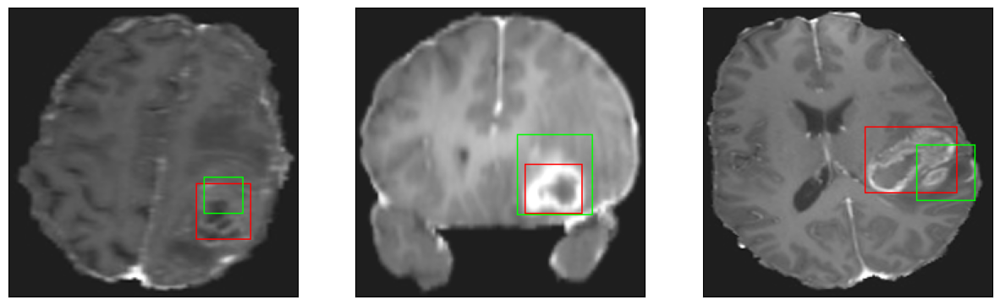

26/26 [==============================] - 8s 295ms/step - loss: 10.1651 - IoU: 0.3941 - val_loss: 12.8271 - val_IoU: 0.3212
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 10.4237 - IoU: 0.4045
Epoch 24: val_IoU improved from 0.41468 to 0.42174, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


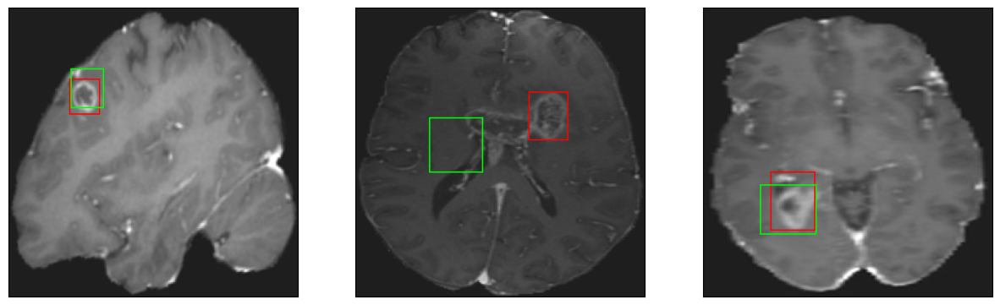

26/26 [==============================] - 30s 1s/step - loss: 10.4237 - IoU: 0.4045 - val_loss: 11.3743 - val_IoU: 0.4217
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 10.1492 - IoU: 0.4074
Epoch 25: val_IoU did not improve from 0.42174
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


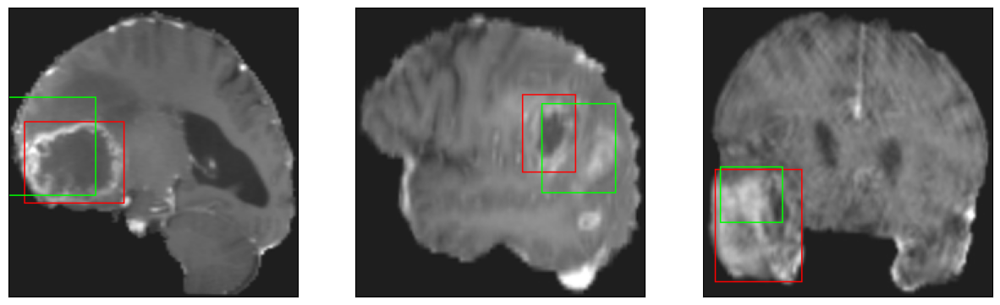

26/26 [==============================] - 9s 336ms/step - loss: 10.1492 - IoU: 0.4074 - val_loss: 11.6064 - val_IoU: 0.4003
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 10.1610 - IoU: 0.4127
Epoch 26: val_IoU did not improve from 0.42174
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


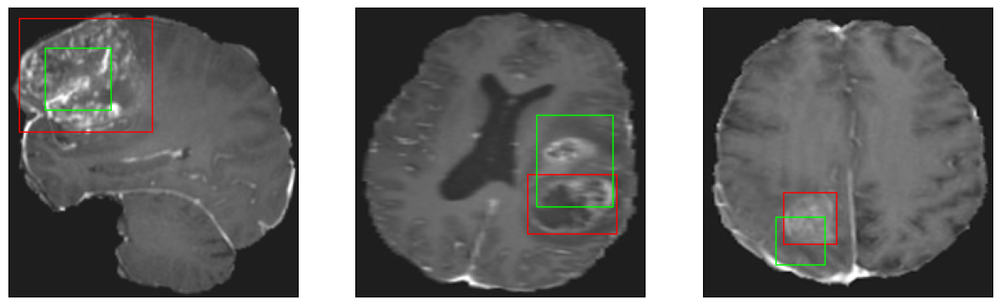

26/26 [==============================] - 8s 304ms/step - loss: 10.1610 - IoU: 0.4127 - val_loss: 11.8078 - val_IoU: 0.3765
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 9.9643 - IoU: 0.4056
Epoch 27: val_IoU improved from 0.42174 to 0.43318, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4


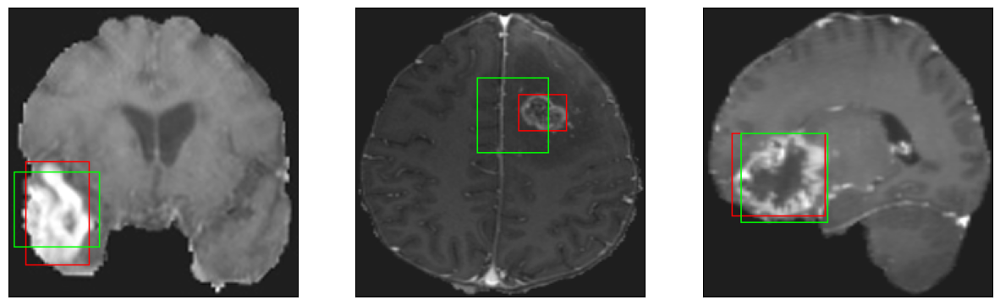

26/26 [==============================] - 30s 1s/step - loss: 9.9643 - IoU: 0.4056 - val_loss: 10.7122 - val_IoU: 0.4332
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 9.8386 - IoU: 0.4114
Epoch 28: val_IoU did not improve from 0.43318
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


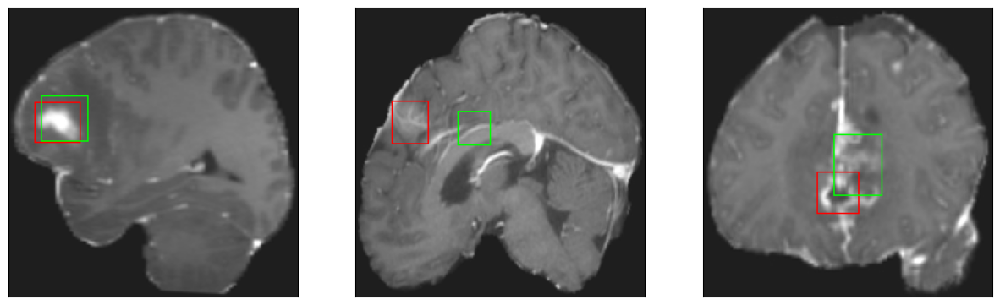

26/26 [==============================] - 8s 319ms/step - loss: 9.8386 - IoU: 0.4114 - val_loss: 11.6459 - val_IoU: 0.3668
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 9.7824 - IoU: 0.4086
Epoch 29: val_IoU did not improve from 0.43318
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


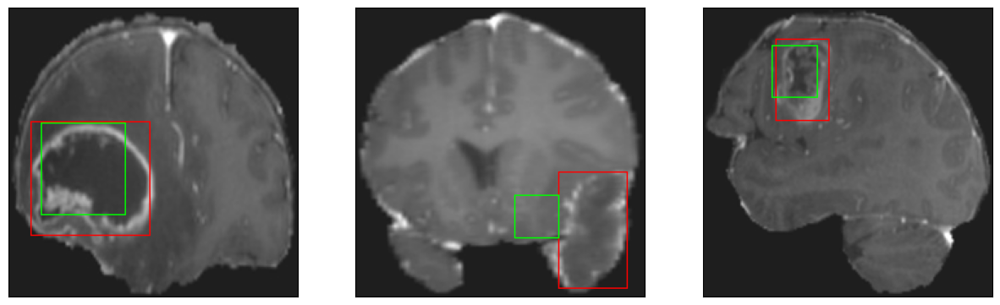

26/26 [==============================] - 7s 268ms/step - loss: 9.7824 - IoU: 0.4086 - val_loss: 11.6111 - val_IoU: 0.3862
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 9.5086 - IoU: 0.4330
Epoch 30: val_IoU did not improve from 0.43318
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


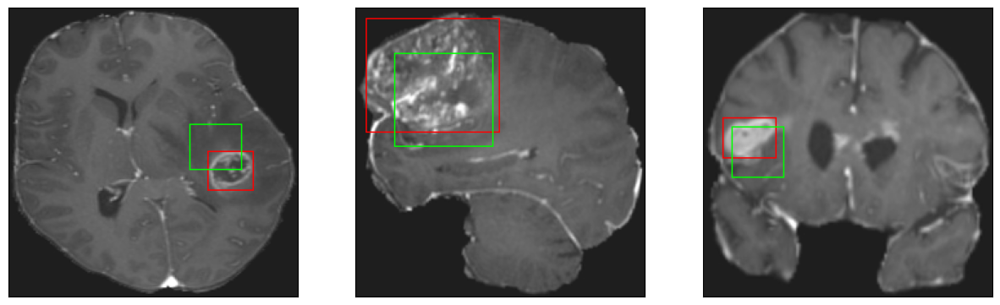

26/26 [==============================] - 7s 286ms/step - loss: 9.5086 - IoU: 0.4330 - val_loss: 12.3757 - val_IoU: 0.3751
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 9.6102 - IoU: 0.4129
Epoch 31: val_IoU did not improve from 0.43318
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


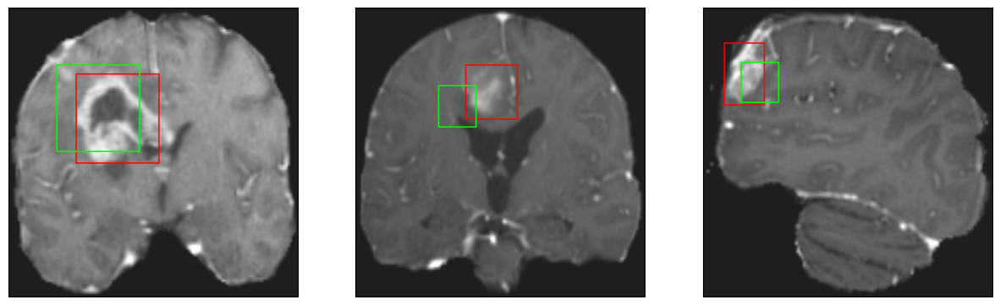

26/26 [==============================] - 8s 299ms/step - loss: 9.6102 - IoU: 0.4129 - val_loss: 11.9519 - val_IoU: 0.3549
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.2352 - IoU: 0.4309
Epoch 32: val_IoU improved from 0.43318 to 0.43964, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


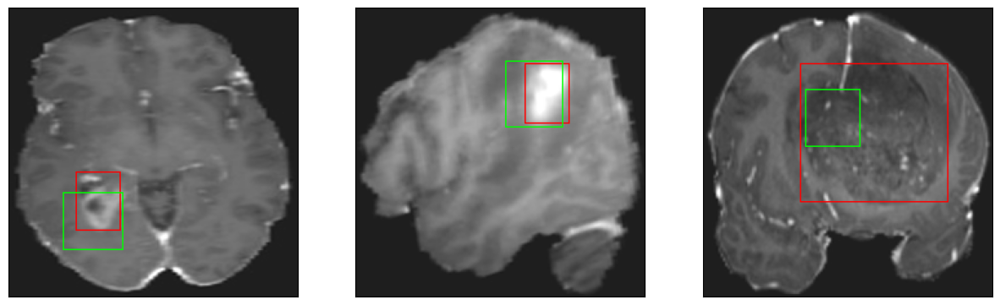

26/26 [==============================] - 26s 1s/step - loss: 9.2352 - IoU: 0.4309 - val_loss: 10.6884 - val_IoU: 0.4396
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.0968 - IoU: 0.4332
Epoch 33: val_IoU did not improve from 0.43964
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


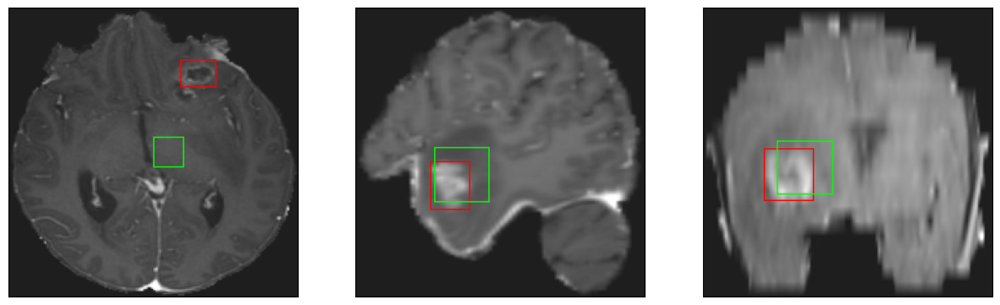

26/26 [==============================] - 8s 291ms/step - loss: 9.0968 - IoU: 0.4332 - val_loss: 11.2099 - val_IoU: 0.3944
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 8.9172 - IoU: 0.4464
Epoch 34: val_IoU did not improve from 0.43964
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


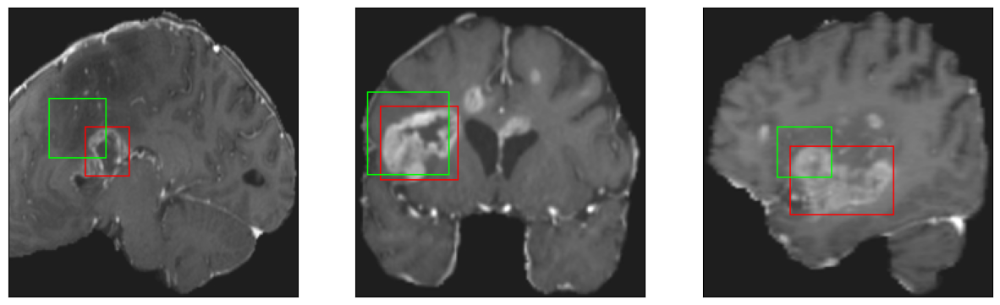

26/26 [==============================] - 8s 314ms/step - loss: 8.9172 - IoU: 0.4464 - val_loss: 11.9979 - val_IoU: 0.3551
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 9.2653 - IoU: 0.4228
Epoch 35: val_IoU did not improve from 0.43964
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


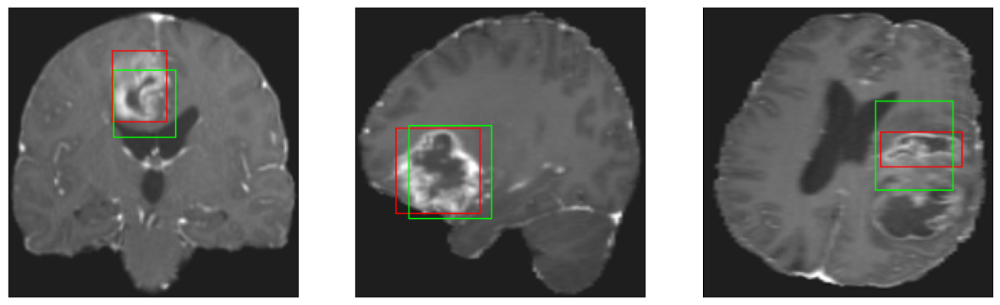

26/26 [==============================] - 8s 293ms/step - loss: 9.2653 - IoU: 0.4228 - val_loss: 10.6762 - val_IoU: 0.4248
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 8.5487 - IoU: 0.4558
Epoch 36: val_IoU did not improve from 0.43964
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


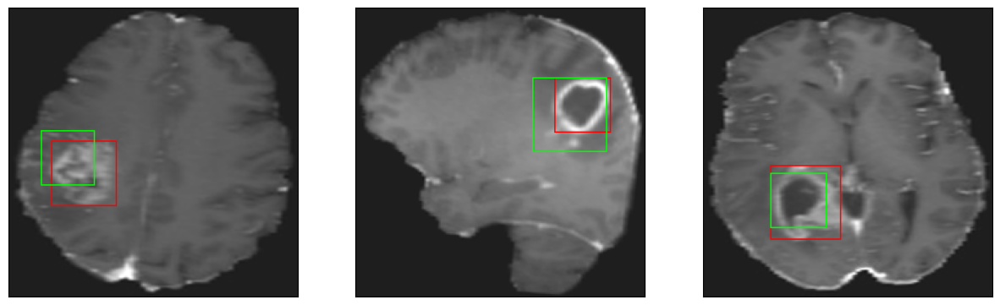

26/26 [==============================] - 7s 280ms/step - loss: 8.5487 - IoU: 0.4558 - val_loss: 11.4742 - val_IoU: 0.3835
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 8.8095 - IoU: 0.4441
Epoch 37: val_IoU improved from 0.43964 to 0.46887, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


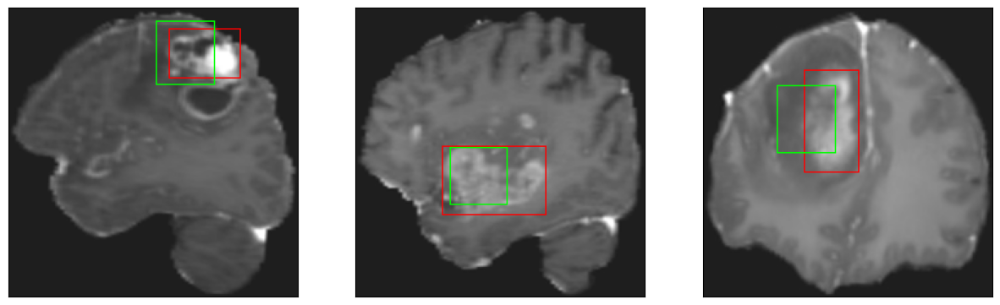

26/26 [==============================] - 25s 990ms/step - loss: 8.8095 - IoU: 0.4441 - val_loss: 9.5549 - val_IoU: 0.4689
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 8.3950 - IoU: 0.4607
Epoch 38: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 47ms/step
4


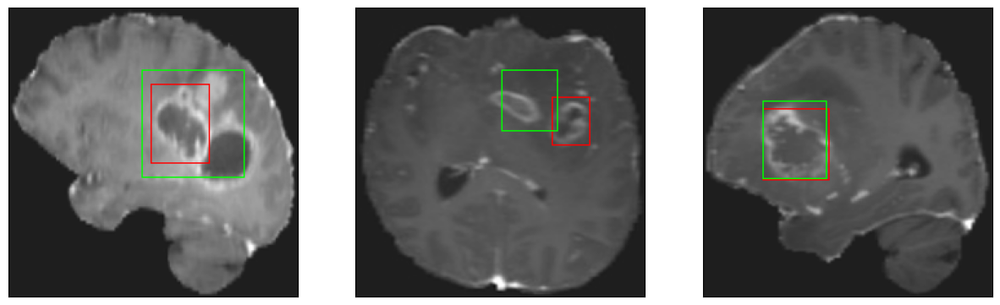

26/26 [==============================] - 8s 325ms/step - loss: 8.3950 - IoU: 0.4607 - val_loss: 10.5369 - val_IoU: 0.4317
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 8.4665 - IoU: 0.4406
Epoch 39: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


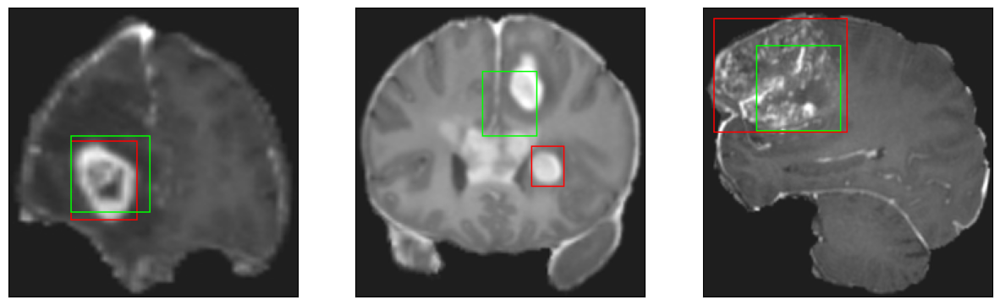

26/26 [==============================] - 8s 306ms/step - loss: 8.4665 - IoU: 0.4406 - val_loss: 10.9716 - val_IoU: 0.4149
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 8.6002 - IoU: 0.4435
Epoch 40: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


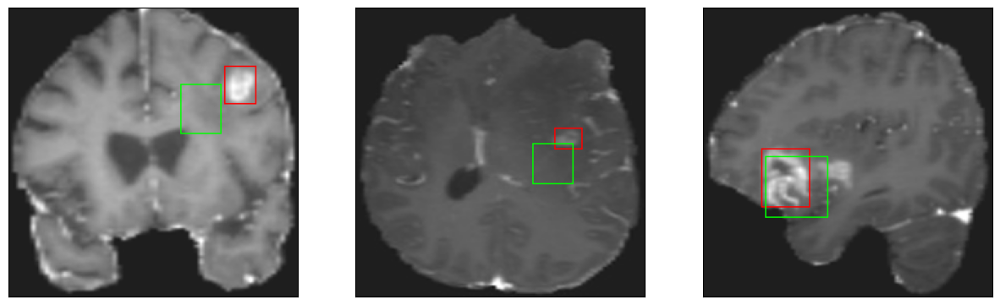

26/26 [==============================] - 8s 301ms/step - loss: 8.6002 - IoU: 0.4435 - val_loss: 9.8867 - val_IoU: 0.4508
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.1897 - IoU: 0.4682
Epoch 41: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


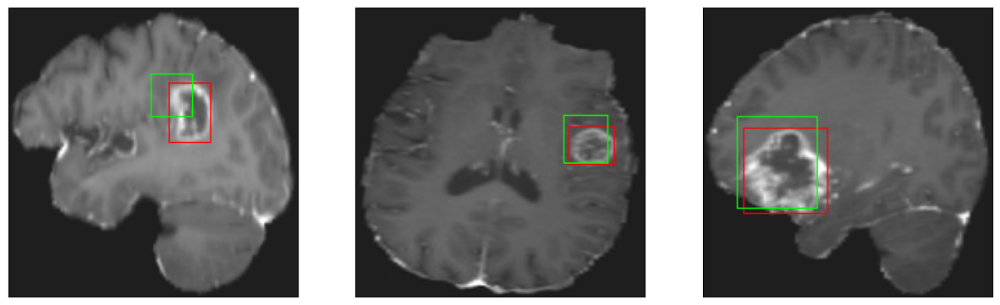

26/26 [==============================] - 8s 296ms/step - loss: 8.1897 - IoU: 0.4682 - val_loss: 10.8362 - val_IoU: 0.3907
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 8.6286 - IoU: 0.4502
Epoch 42: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


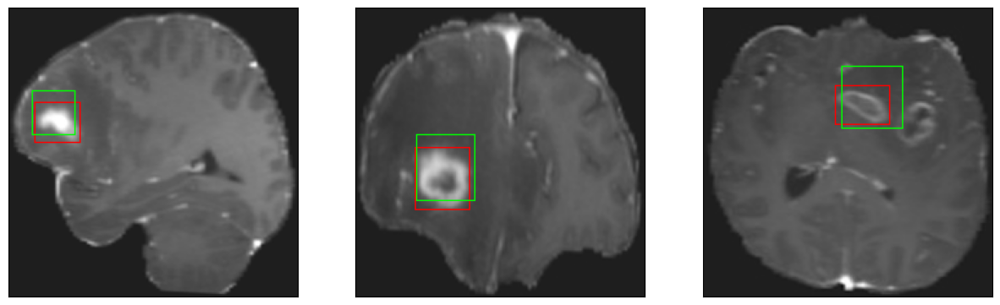

26/26 [==============================] - 7s 279ms/step - loss: 8.6286 - IoU: 0.4502 - val_loss: 10.6071 - val_IoU: 0.4013
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.4738 - IoU: 0.4502
Epoch 43: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


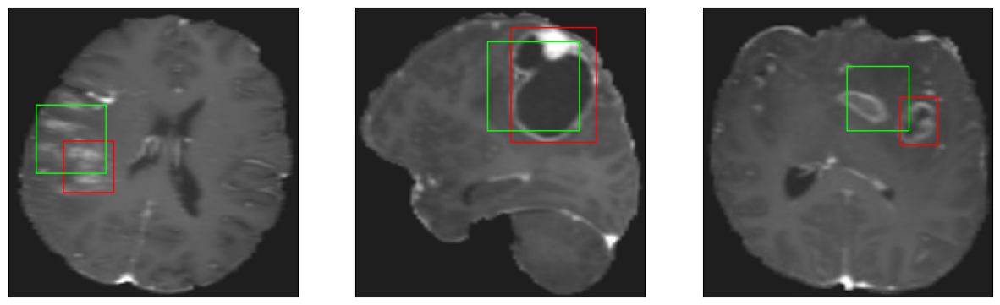

26/26 [==============================] - 7s 288ms/step - loss: 8.4738 - IoU: 0.4502 - val_loss: 10.7797 - val_IoU: 0.4104
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.8431 - IoU: 0.4338
Epoch 44: val_IoU did not improve from 0.46887
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


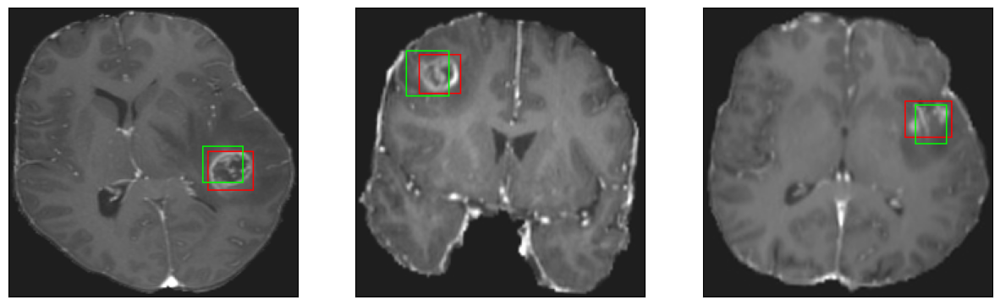

26/26 [==============================] - 8s 307ms/step - loss: 8.8431 - IoU: 0.4338 - val_loss: 9.9756 - val_IoU: 0.4566
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.6941 - IoU: 0.4428
Epoch 45: val_IoU improved from 0.46887 to 0.47276, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


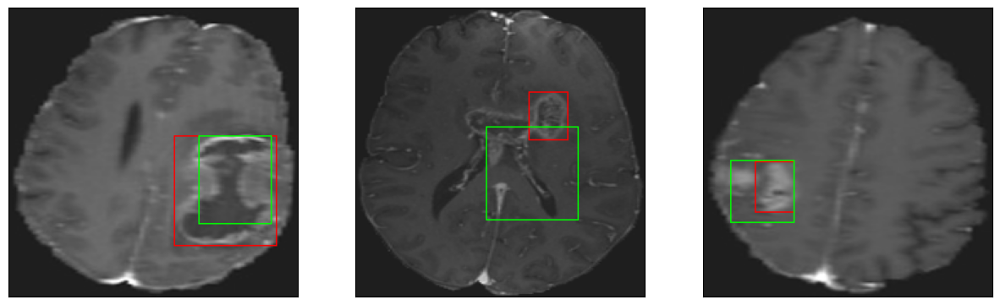

26/26 [==============================] - 22s 880ms/step - loss: 8.6941 - IoU: 0.4428 - val_loss: 9.4482 - val_IoU: 0.4728
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.0662 - IoU: 0.4617
Epoch 46: val_IoU did not improve from 0.47276
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4


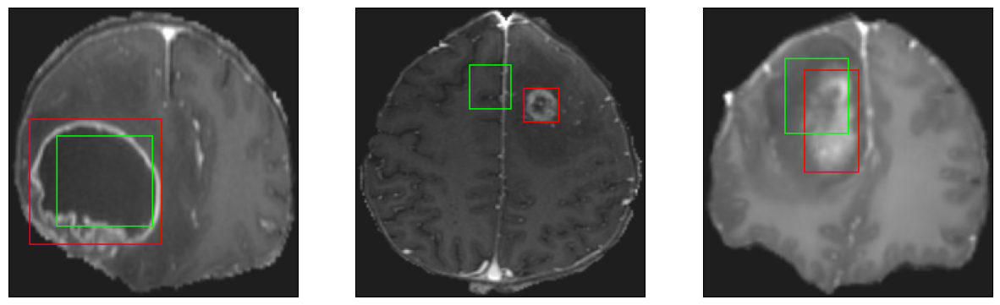

26/26 [==============================] - 7s 277ms/step - loss: 8.0662 - IoU: 0.4617 - val_loss: 10.8082 - val_IoU: 0.3833
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.1385 - IoU: 0.4693
Epoch 47: val_IoU did not improve from 0.47276
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


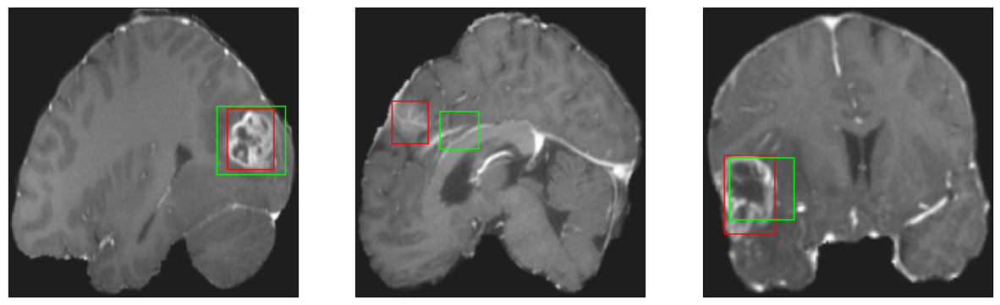

26/26 [==============================] - 8s 292ms/step - loss: 8.1385 - IoU: 0.4693 - val_loss: 9.9825 - val_IoU: 0.4604
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 7.8457 - IoU: 0.4849
Epoch 48: val_IoU did not improve from 0.47276
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


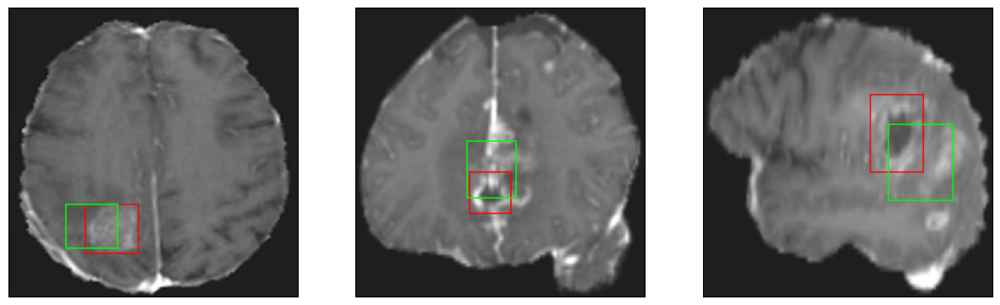

26/26 [==============================] - 8s 312ms/step - loss: 7.8457 - IoU: 0.4849 - val_loss: 10.2836 - val_IoU: 0.4346
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 7.8105 - IoU: 0.4840
Epoch 49: val_IoU did not improve from 0.47276
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


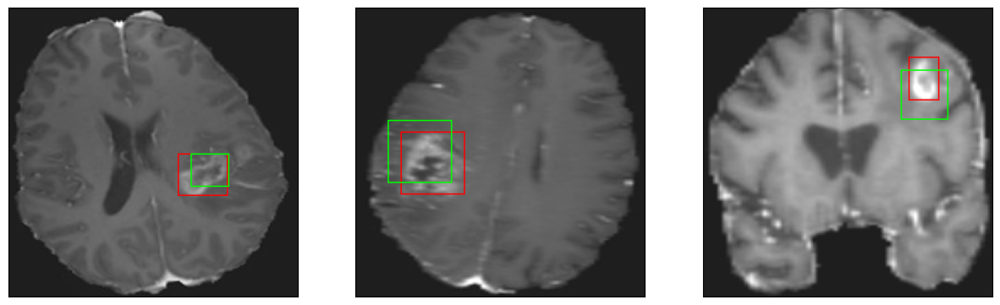

26/26 [==============================] - 8s 291ms/step - loss: 7.8105 - IoU: 0.4840 - val_loss: 10.6611 - val_IoU: 0.4112
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.1609 - IoU: 0.4632
Epoch 50: val_IoU improved from 0.47276 to 0.51250, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


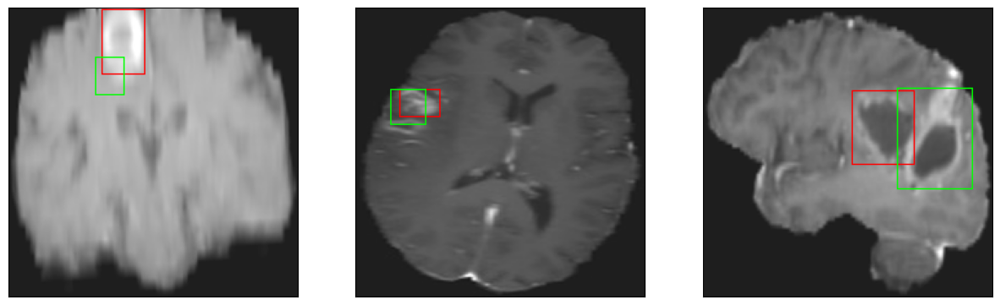

26/26 [==============================] - 26s 1s/step - loss: 8.1609 - IoU: 0.4632 - val_loss: 8.7841 - val_IoU: 0.5125
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.3353 - IoU: 0.4627
Epoch 51: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


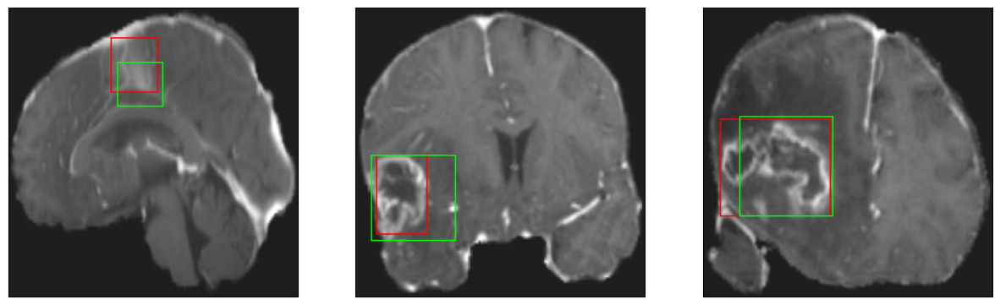

26/26 [==============================] - 8s 289ms/step - loss: 8.3353 - IoU: 0.4627 - val_loss: 10.0810 - val_IoU: 0.4299
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 8.0377 - IoU: 0.4700
Epoch 52: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


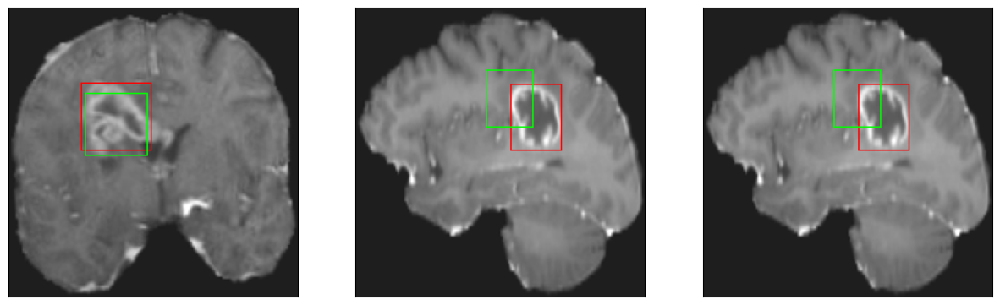

26/26 [==============================] - 8s 294ms/step - loss: 8.0377 - IoU: 0.4700 - val_loss: 10.9154 - val_IoU: 0.4083
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 8.1287 - IoU: 0.4685
Epoch 53: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


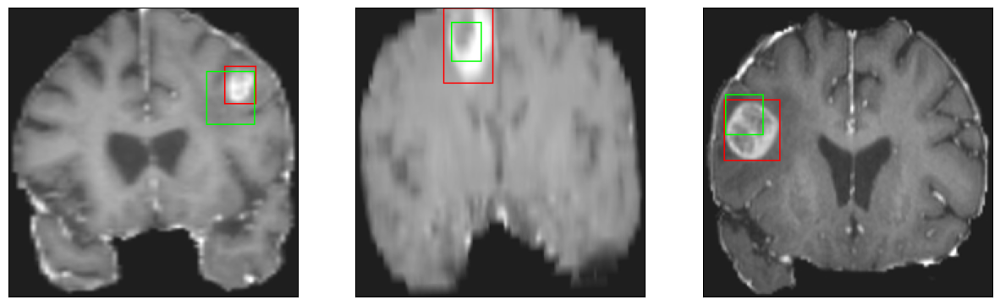

26/26 [==============================] - 8s 303ms/step - loss: 8.1287 - IoU: 0.4685 - val_loss: 10.6258 - val_IoU: 0.4146
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 8.5607 - IoU: 0.4397
Epoch 54: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


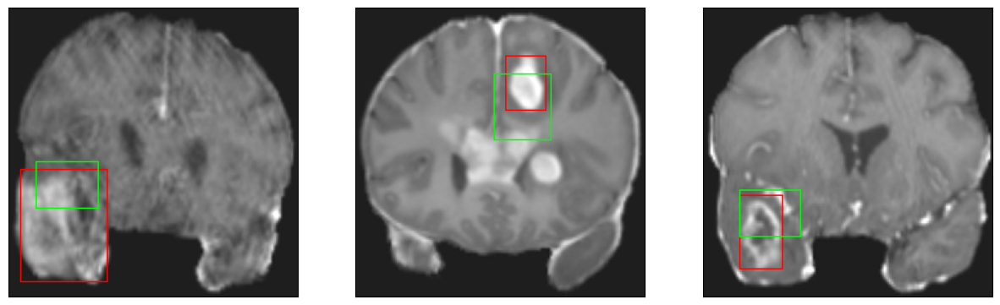

26/26 [==============================] - 7s 277ms/step - loss: 8.5607 - IoU: 0.4397 - val_loss: 11.0598 - val_IoU: 0.3887
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 8.0878 - IoU: 0.4586
Epoch 55: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


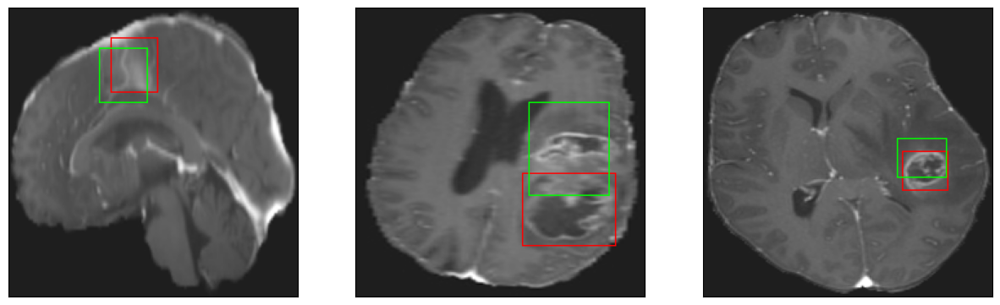

26/26 [==============================] - 8s 293ms/step - loss: 8.0878 - IoU: 0.4586 - val_loss: 9.6070 - val_IoU: 0.4689
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 7.8102 - IoU: 0.4858
Epoch 56: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


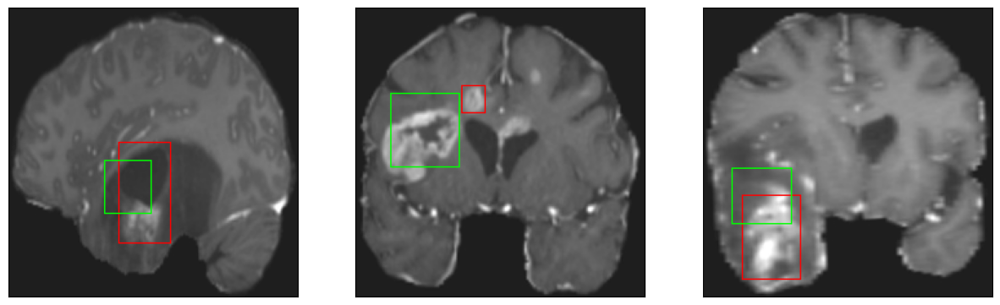

26/26 [==============================] - 8s 293ms/step - loss: 7.8102 - IoU: 0.4858 - val_loss: 11.8375 - val_IoU: 0.3395
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.4475 - IoU: 0.4990
Epoch 57: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


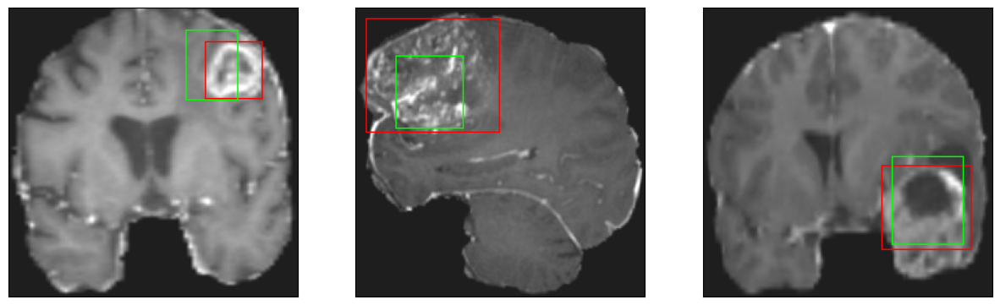

26/26 [==============================] - 8s 308ms/step - loss: 7.4475 - IoU: 0.4990 - val_loss: 9.8097 - val_IoU: 0.4583
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.6819 - IoU: 0.4857
Epoch 58: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


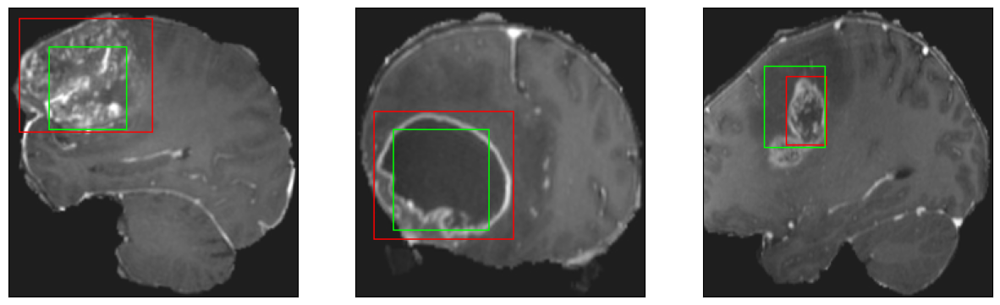

26/26 [==============================] - 8s 301ms/step - loss: 7.6819 - IoU: 0.4857 - val_loss: 9.1751 - val_IoU: 0.4827
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.5887 - IoU: 0.4953
Epoch 59: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


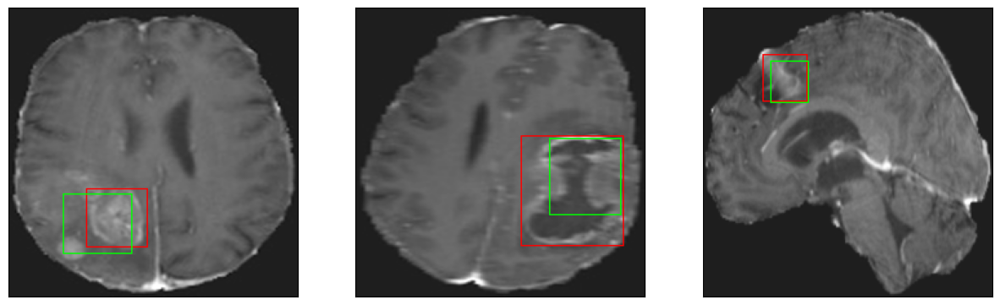

26/26 [==============================] - 7s 282ms/step - loss: 7.5887 - IoU: 0.4953 - val_loss: 9.1228 - val_IoU: 0.4842
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.2630 - IoU: 0.5104
Epoch 60: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


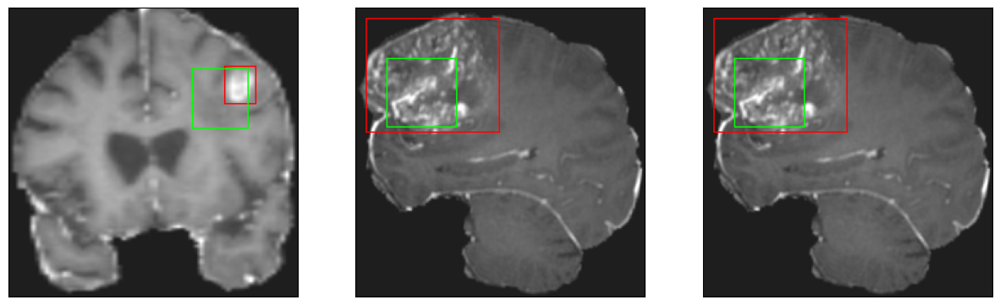

26/26 [==============================] - 8s 303ms/step - loss: 7.2630 - IoU: 0.5104 - val_loss: 9.2732 - val_IoU: 0.4900
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.4099 - IoU: 0.5045
Epoch 61: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


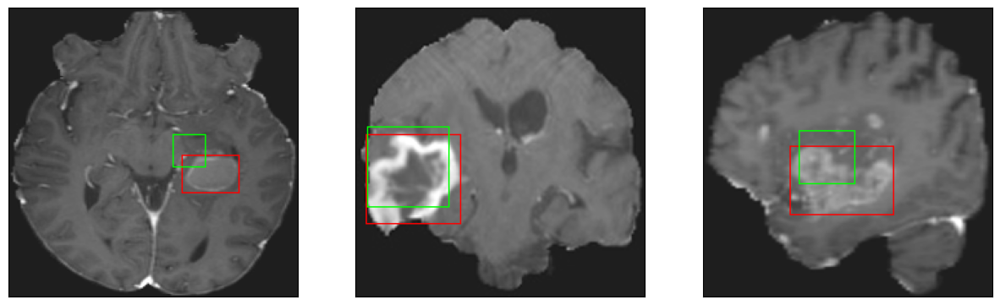

26/26 [==============================] - 7s 275ms/step - loss: 7.4099 - IoU: 0.5045 - val_loss: 9.4701 - val_IoU: 0.4778
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.5167 - IoU: 0.4931
Epoch 62: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


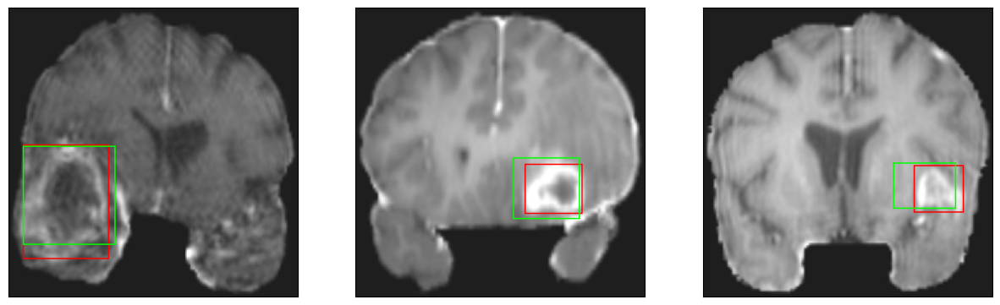

26/26 [==============================] - 7s 282ms/step - loss: 7.5167 - IoU: 0.4931 - val_loss: 8.8226 - val_IoU: 0.4970
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.5903 - IoU: 0.4912
Epoch 63: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


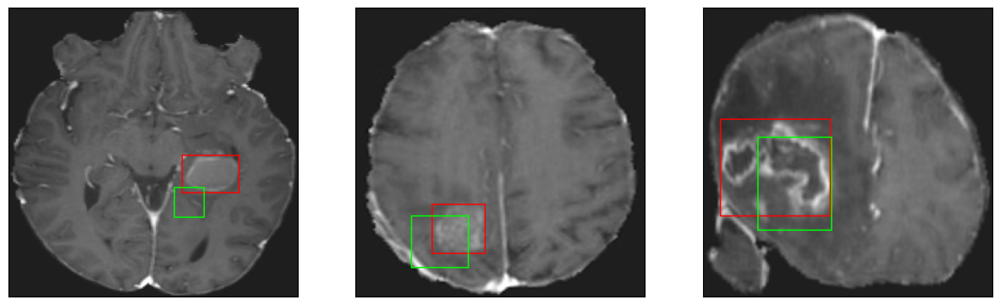

26/26 [==============================] - 7s 289ms/step - loss: 7.5903 - IoU: 0.4912 - val_loss: 9.4855 - val_IoU: 0.4859
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.8875 - IoU: 0.4796
Epoch 64: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


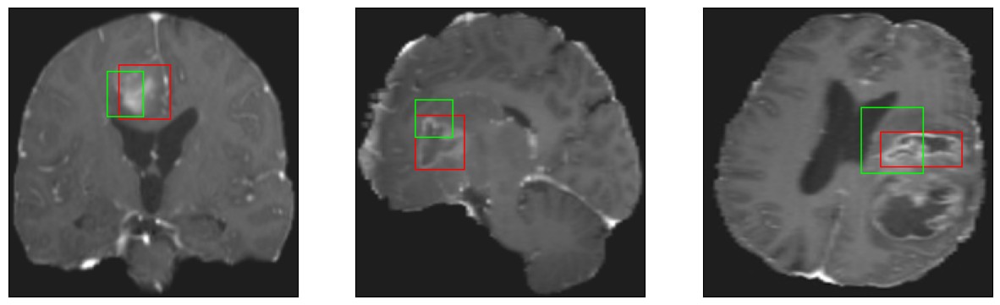

26/26 [==============================] - 8s 303ms/step - loss: 7.8875 - IoU: 0.4796 - val_loss: 10.3663 - val_IoU: 0.4366
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.2108 - IoU: 0.5153
Epoch 65: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


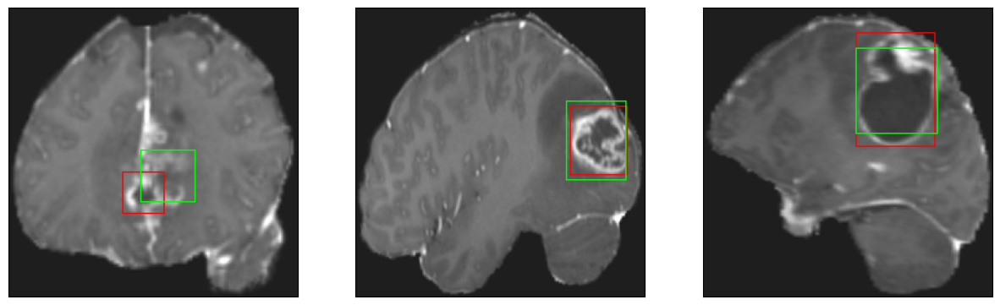

26/26 [==============================] - 8s 294ms/step - loss: 7.2108 - IoU: 0.5153 - val_loss: 9.3178 - val_IoU: 0.4706
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.5007 - IoU: 0.5075
Epoch 66: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


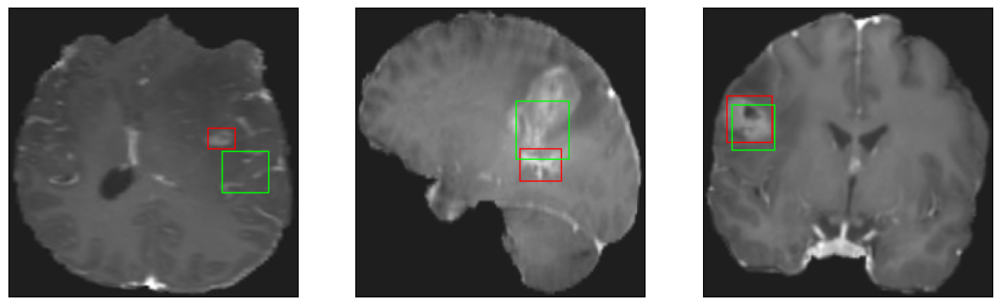

26/26 [==============================] - 8s 291ms/step - loss: 7.5007 - IoU: 0.5075 - val_loss: 9.2828 - val_IoU: 0.4842
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.0246 - IoU: 0.5148
Epoch 67: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


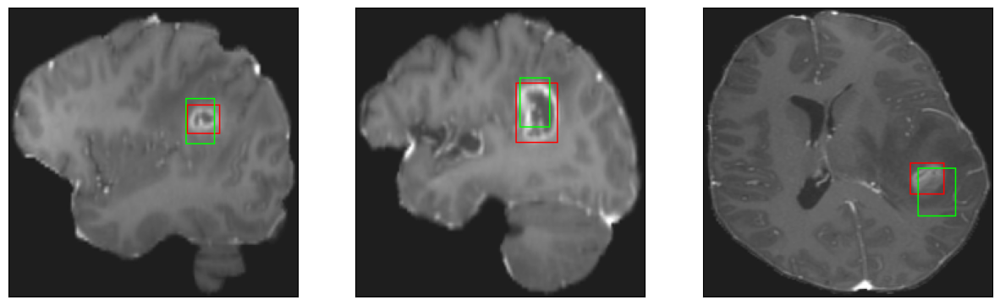

26/26 [==============================] - 8s 311ms/step - loss: 7.0246 - IoU: 0.5148 - val_loss: 9.9560 - val_IoU: 0.4686
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.2030 - IoU: 0.5011
Epoch 68: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


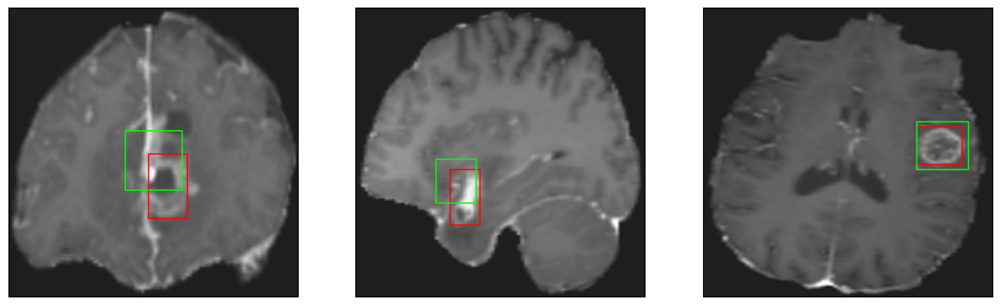

26/26 [==============================] - 7s 272ms/step - loss: 7.2030 - IoU: 0.5011 - val_loss: 8.9136 - val_IoU: 0.4929
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.2234 - IoU: 0.5035
Epoch 69: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


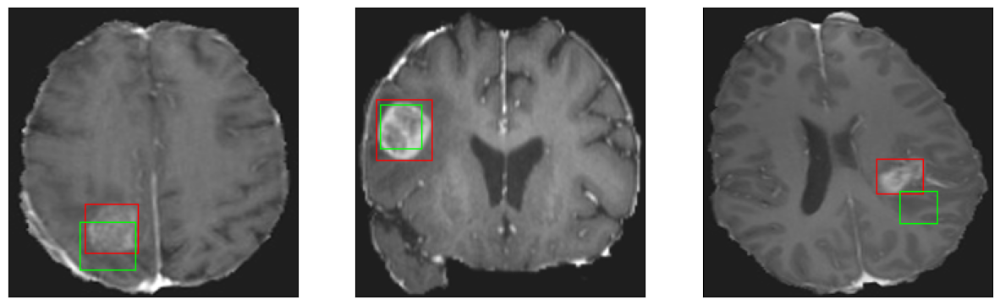

26/26 [==============================] - 8s 310ms/step - loss: 7.2234 - IoU: 0.5035 - val_loss: 9.0791 - val_IoU: 0.4848
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 7.3513 - IoU: 0.5004
Epoch 70: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


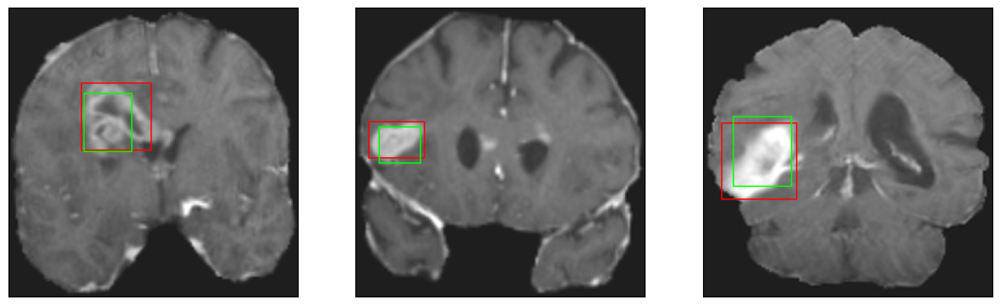

26/26 [==============================] - 8s 307ms/step - loss: 7.3513 - IoU: 0.5004 - val_loss: 9.3671 - val_IoU: 0.4680
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 6.9628 - IoU: 0.5172
Epoch 71: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


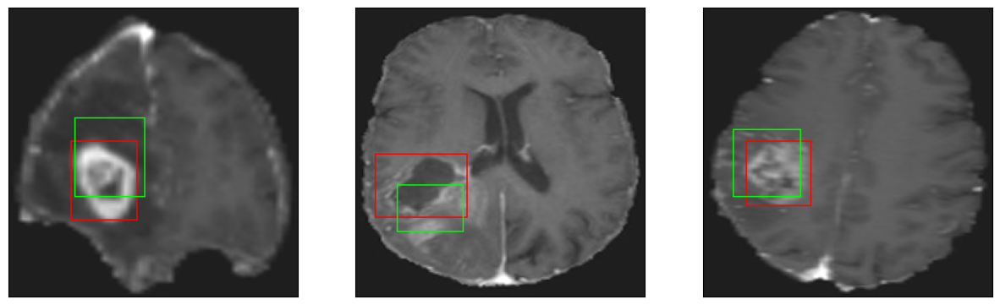

26/26 [==============================] - 8s 306ms/step - loss: 6.9628 - IoU: 0.5172 - val_loss: 9.9581 - val_IoU: 0.4246
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 6.9782 - IoU: 0.5107
Epoch 72: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


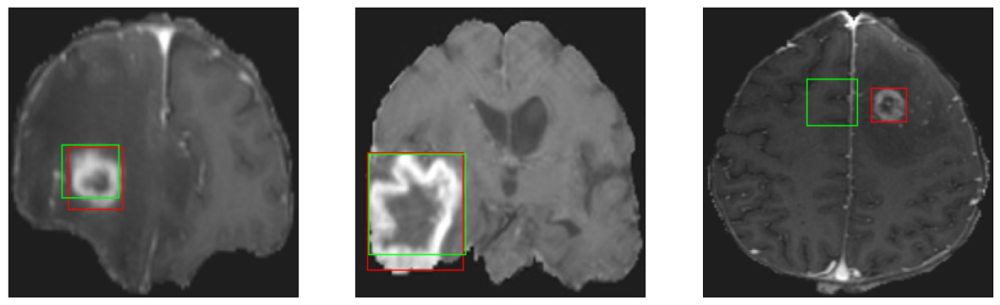

26/26 [==============================] - 7s 278ms/step - loss: 6.9782 - IoU: 0.5107 - val_loss: 8.3682 - val_IoU: 0.5065
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 6.9638 - IoU: 0.5021
Epoch 73: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


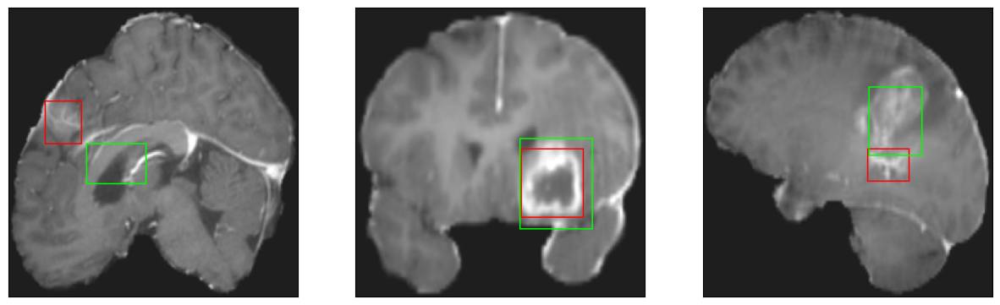

26/26 [==============================] - 8s 304ms/step - loss: 6.9638 - IoU: 0.5021 - val_loss: 9.0617 - val_IoU: 0.4766
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.3321 - IoU: 0.5008
Epoch 74: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


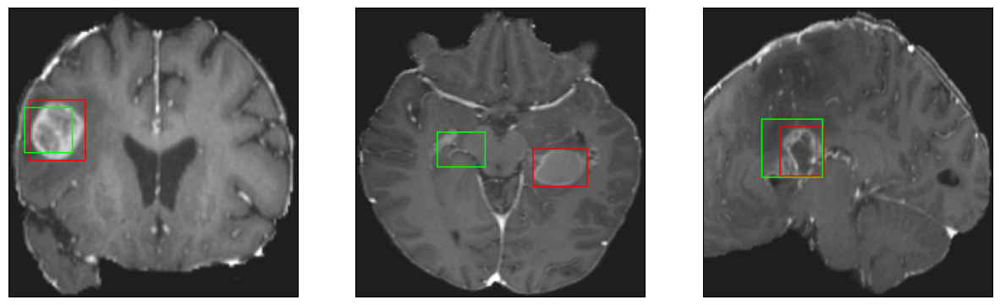

26/26 [==============================] - 7s 281ms/step - loss: 7.3321 - IoU: 0.5008 - val_loss: 9.3368 - val_IoU: 0.4583
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 6.8797 - IoU: 0.5188
Epoch 75: val_IoU did not improve from 0.51250
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


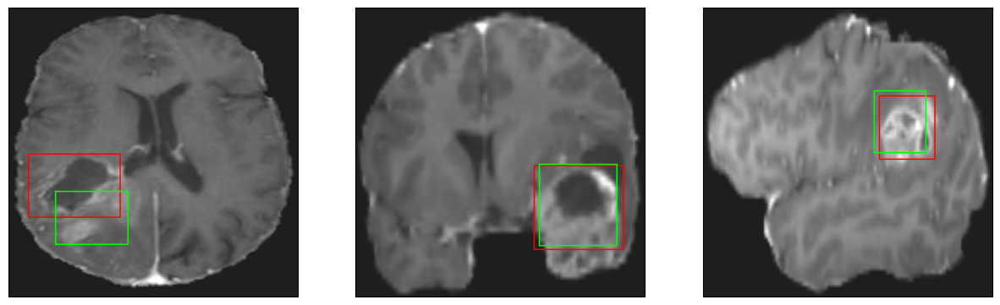

26/26 [==============================] - 7s 289ms/step - loss: 6.8797 - IoU: 0.5188 - val_loss: 9.1976 - val_IoU: 0.4704
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 6.9369 - IoU: 0.5190
Epoch 76: val_IoU improved from 0.51250 to 0.53305, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


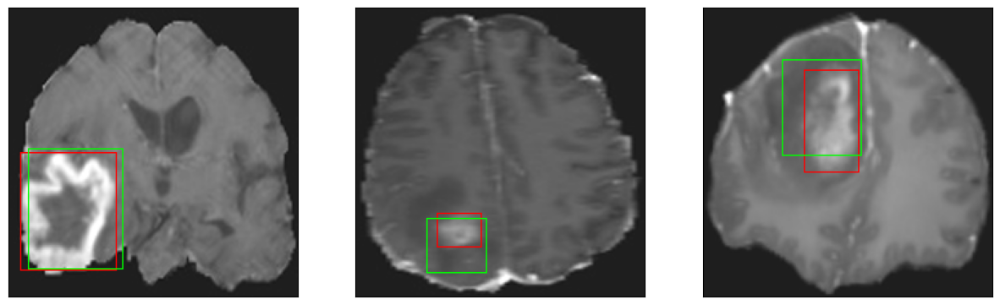

26/26 [==============================] - 26s 1s/step - loss: 6.9369 - IoU: 0.5190 - val_loss: 8.7260 - val_IoU: 0.5330
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 7.0051 - IoU: 0.5115
Epoch 77: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 42ms/step
4


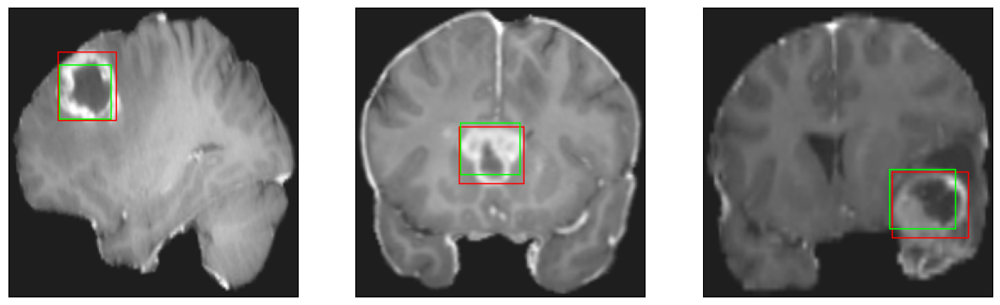

26/26 [==============================] - 8s 309ms/step - loss: 7.0051 - IoU: 0.5115 - val_loss: 9.8708 - val_IoU: 0.4451
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 7.0038 - IoU: 0.5028
Epoch 78: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


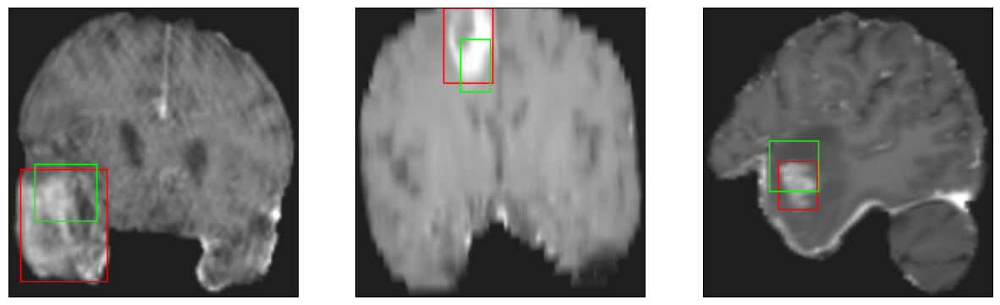

26/26 [==============================] - 8s 299ms/step - loss: 7.0038 - IoU: 0.5028 - val_loss: 9.3360 - val_IoU: 0.4705
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 6.8644 - IoU: 0.5200
Epoch 79: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


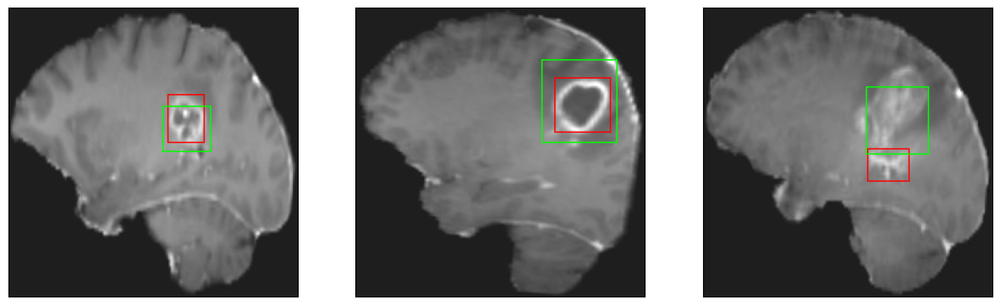

26/26 [==============================] - 7s 277ms/step - loss: 6.8644 - IoU: 0.5200 - val_loss: 8.9586 - val_IoU: 0.4906
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 7.0685 - IoU: 0.5138
Epoch 80: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


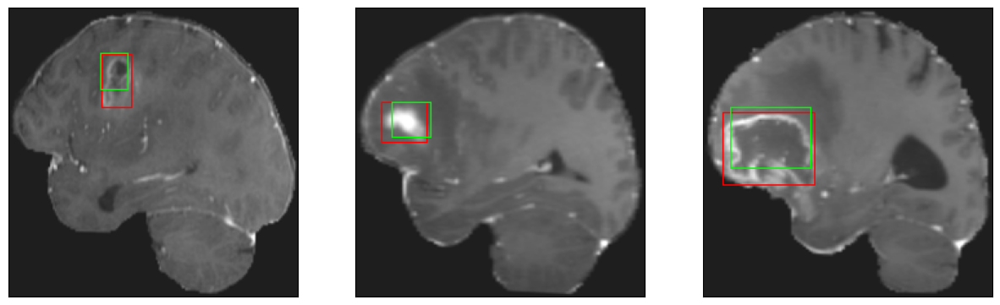

26/26 [==============================] - 9s 333ms/step - loss: 7.0685 - IoU: 0.5138 - val_loss: 9.4715 - val_IoU: 0.4711
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 6.8862 - IoU: 0.5218
Epoch 81: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


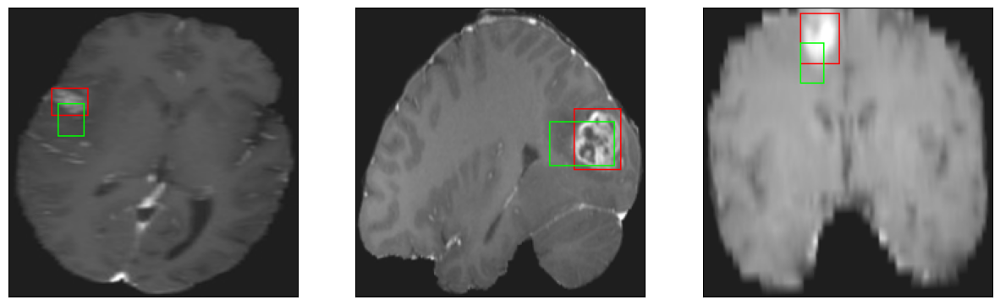

26/26 [==============================] - 7s 288ms/step - loss: 6.8862 - IoU: 0.5218 - val_loss: 9.6014 - val_IoU: 0.4305
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.7359 - IoU: 0.5240
Epoch 82: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


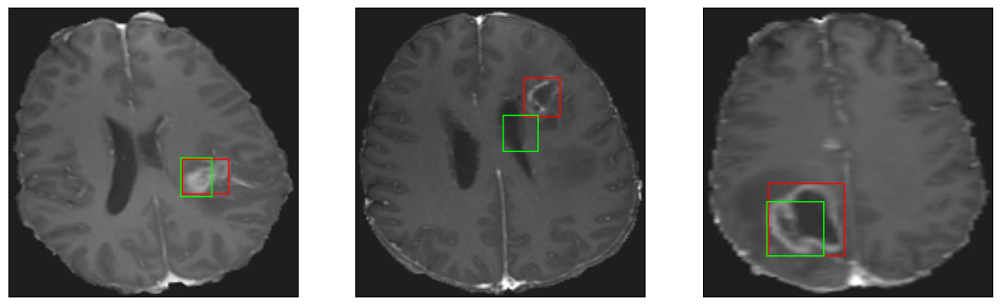

26/26 [==============================] - 8s 315ms/step - loss: 6.7359 - IoU: 0.5240 - val_loss: 9.5551 - val_IoU: 0.4688
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.7167 - IoU: 0.5296
Epoch 83: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


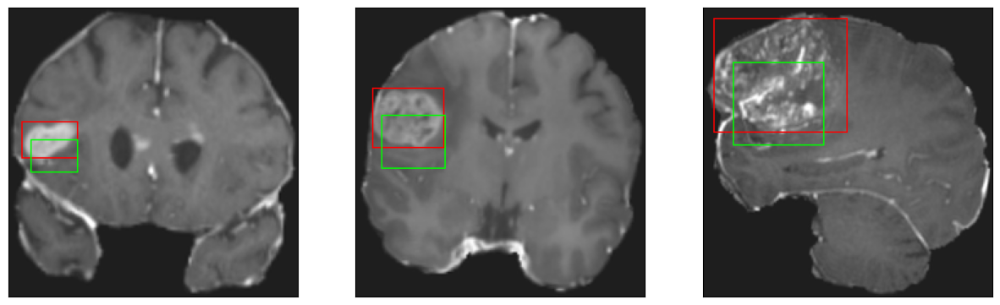

26/26 [==============================] - 7s 276ms/step - loss: 6.7167 - IoU: 0.5296 - val_loss: 9.0647 - val_IoU: 0.4821
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.7681 - IoU: 0.5200
Epoch 84: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


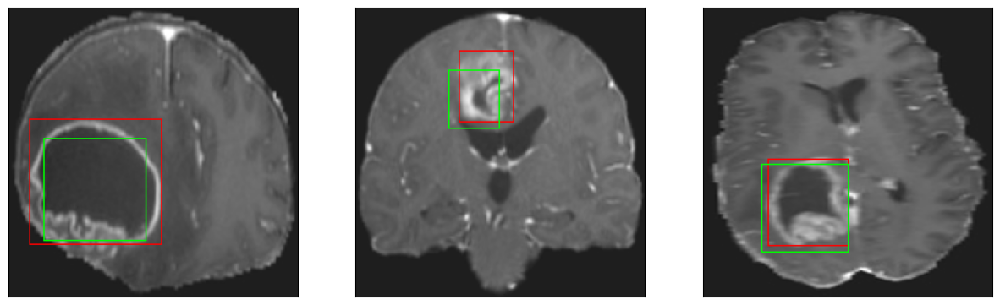

26/26 [==============================] - 8s 291ms/step - loss: 6.7681 - IoU: 0.5200 - val_loss: 8.9338 - val_IoU: 0.4812
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.9388 - IoU: 0.5125
Epoch 85: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


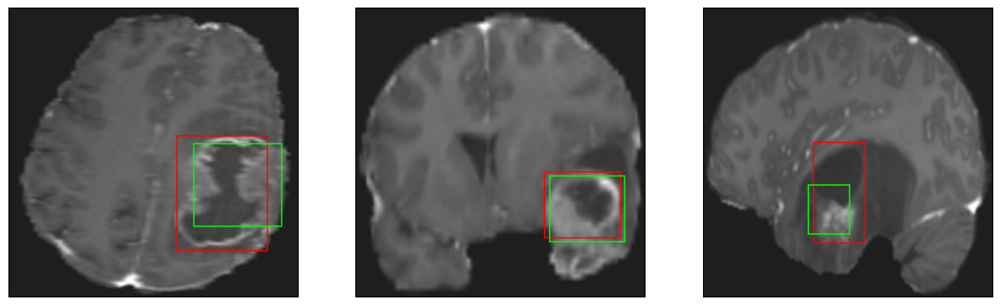

26/26 [==============================] - 8s 311ms/step - loss: 6.9388 - IoU: 0.5125 - val_loss: 9.4476 - val_IoU: 0.4919
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.7070 - IoU: 0.5299
Epoch 86: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


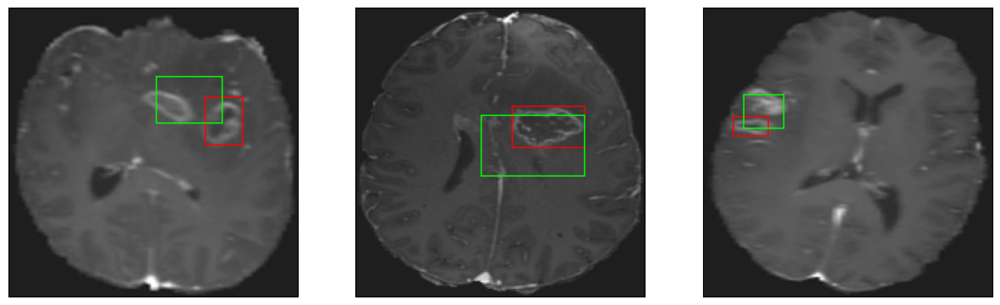

26/26 [==============================] - 8s 293ms/step - loss: 6.7070 - IoU: 0.5299 - val_loss: 9.9296 - val_IoU: 0.4486
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.8177 - IoU: 0.5206
Epoch 87: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


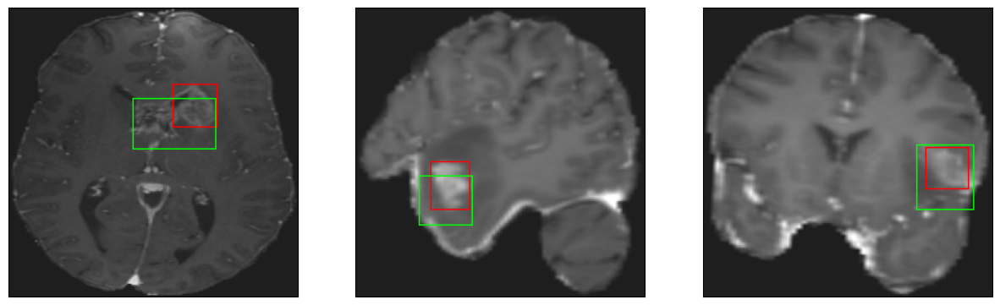

26/26 [==============================] - 8s 305ms/step - loss: 6.8177 - IoU: 0.5206 - val_loss: 8.9104 - val_IoU: 0.5024
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.5439 - IoU: 0.5426
Epoch 88: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


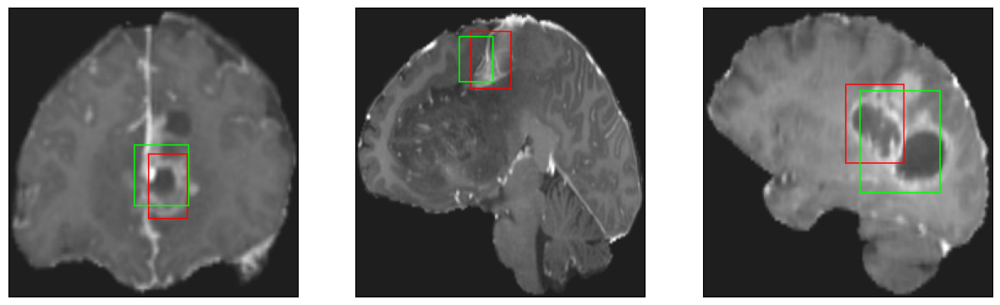

26/26 [==============================] - 8s 299ms/step - loss: 6.5439 - IoU: 0.5426 - val_loss: 8.6910 - val_IoU: 0.5130
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.7990 - IoU: 0.5182
Epoch 89: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


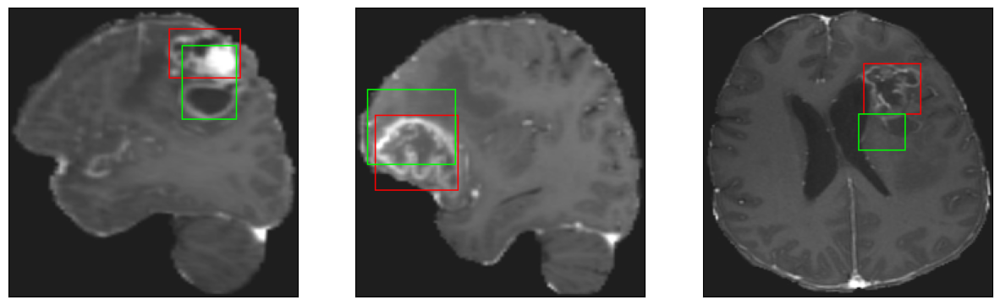

26/26 [==============================] - 8s 311ms/step - loss: 6.7990 - IoU: 0.5182 - val_loss: 9.7768 - val_IoU: 0.4211
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.7586 - IoU: 0.5234
Epoch 90: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


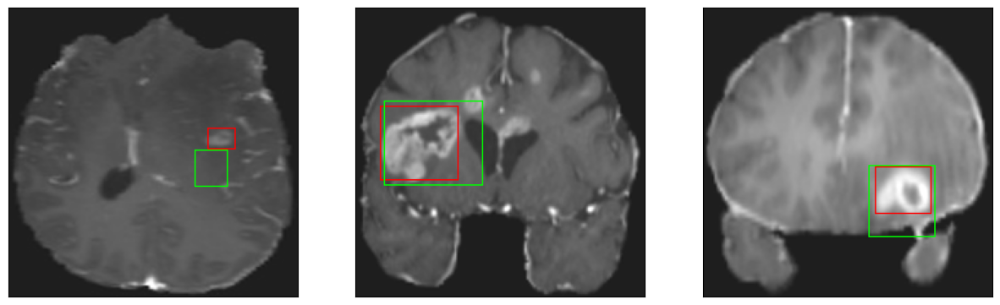

26/26 [==============================] - 8s 302ms/step - loss: 6.7586 - IoU: 0.5234 - val_loss: 8.8863 - val_IoU: 0.4947
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.6256 - IoU: 0.5248
Epoch 91: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


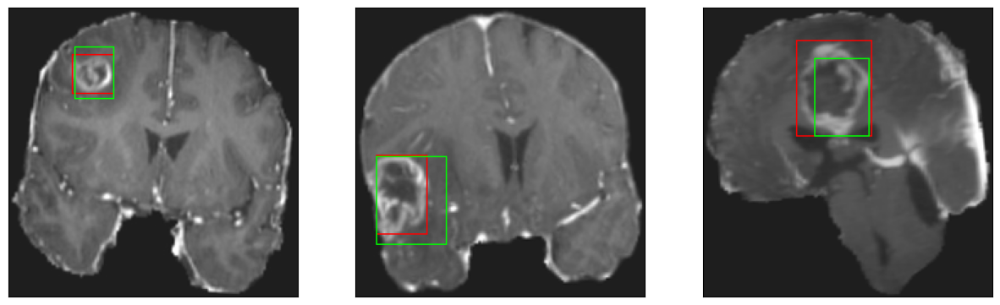

26/26 [==============================] - 8s 300ms/step - loss: 6.6256 - IoU: 0.5248 - val_loss: 9.6284 - val_IoU: 0.4680
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.1688 - IoU: 0.5531
Epoch 92: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


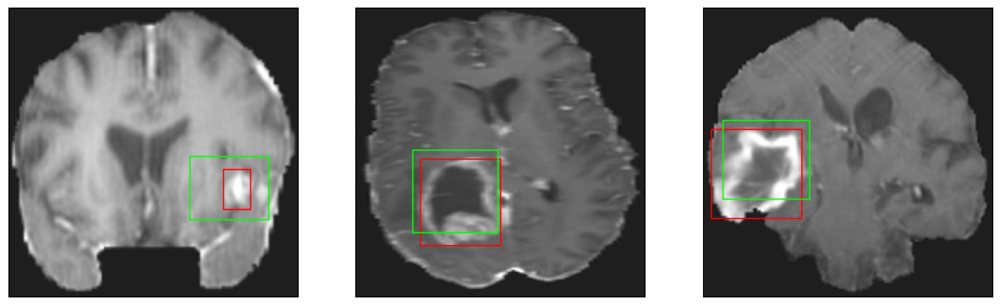

26/26 [==============================] - 8s 296ms/step - loss: 6.1688 - IoU: 0.5531 - val_loss: 9.8588 - val_IoU: 0.4253
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.8302 - IoU: 0.5148
Epoch 93: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


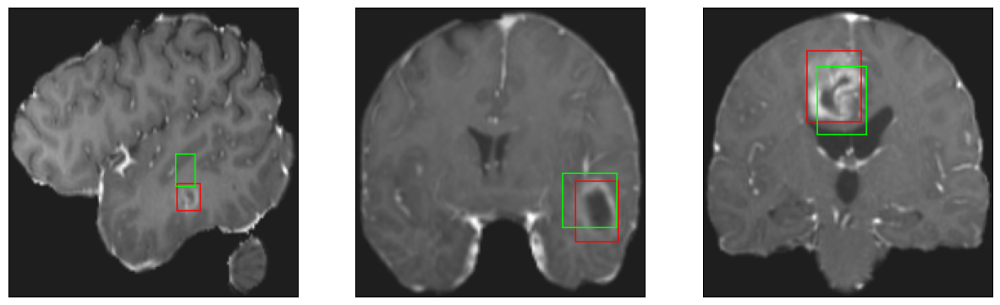

26/26 [==============================] - 8s 299ms/step - loss: 6.8302 - IoU: 0.5148 - val_loss: 8.7712 - val_IoU: 0.4965
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.4010 - IoU: 0.5389
Epoch 94: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


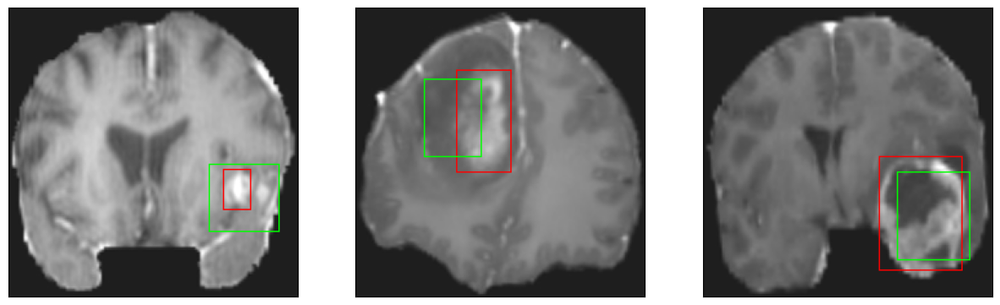

26/26 [==============================] - 8s 301ms/step - loss: 6.4010 - IoU: 0.5389 - val_loss: 8.6672 - val_IoU: 0.4996
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.4106 - IoU: 0.5379
Epoch 95: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


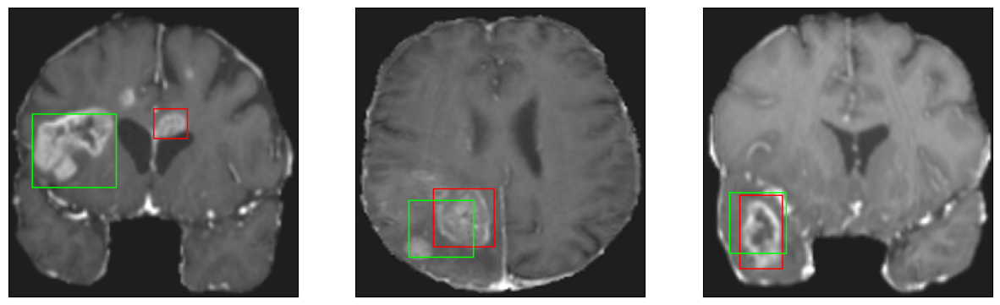

26/26 [==============================] - 7s 287ms/step - loss: 6.4106 - IoU: 0.5379 - val_loss: 8.8178 - val_IoU: 0.4970
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.6069 - IoU: 0.5329
Epoch 96: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


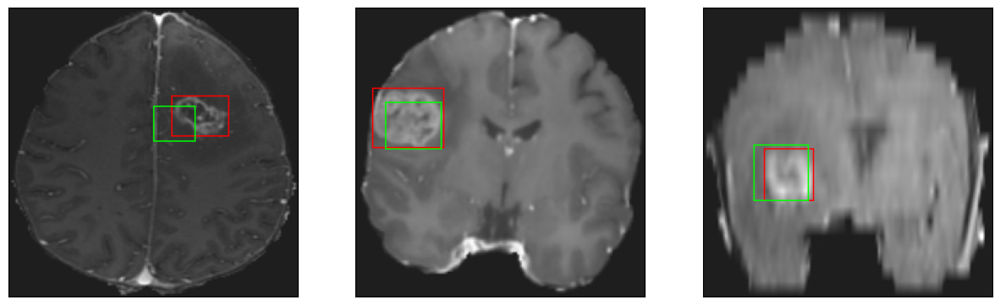

26/26 [==============================] - 8s 290ms/step - loss: 6.6069 - IoU: 0.5329 - val_loss: 8.7915 - val_IoU: 0.4954
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.5486 - IoU: 0.5278
Epoch 97: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


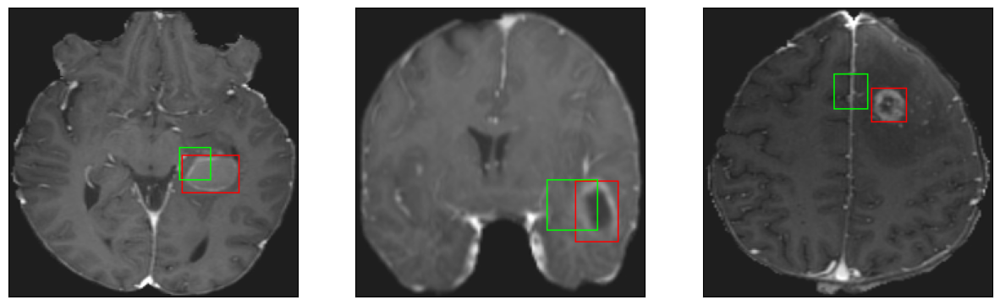

26/26 [==============================] - 8s 295ms/step - loss: 6.5486 - IoU: 0.5278 - val_loss: 8.7835 - val_IoU: 0.5032
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.3553 - IoU: 0.5386
Epoch 98: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


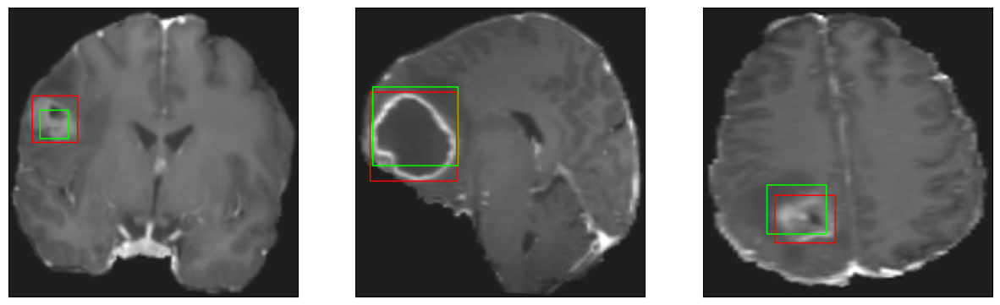

26/26 [==============================] - 7s 272ms/step - loss: 6.3553 - IoU: 0.5386 - val_loss: 9.5845 - val_IoU: 0.4516
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.4832 - IoU: 0.5292
Epoch 99: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


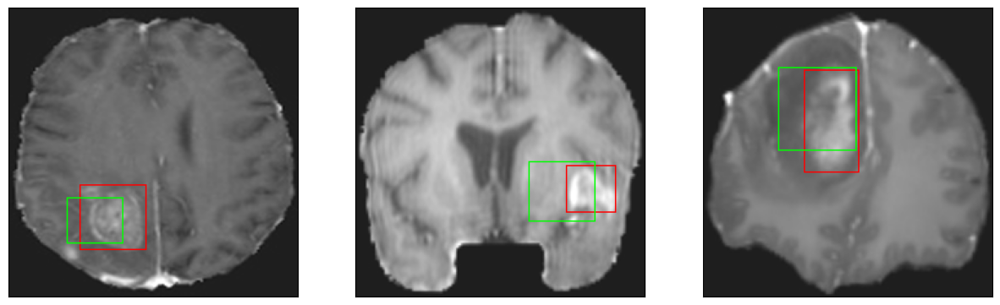

26/26 [==============================] - 8s 299ms/step - loss: 6.4832 - IoU: 0.5292 - val_loss: 9.2613 - val_IoU: 0.4615
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.3405 - IoU: 0.5348
Epoch 100: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


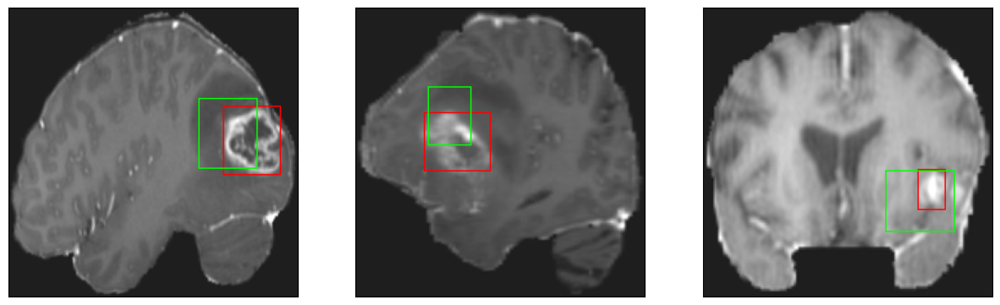

26/26 [==============================] - 7s 288ms/step - loss: 6.3405 - IoU: 0.5348 - val_loss: 9.5491 - val_IoU: 0.4442
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.3330 - IoU: 0.5375
Epoch 101: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


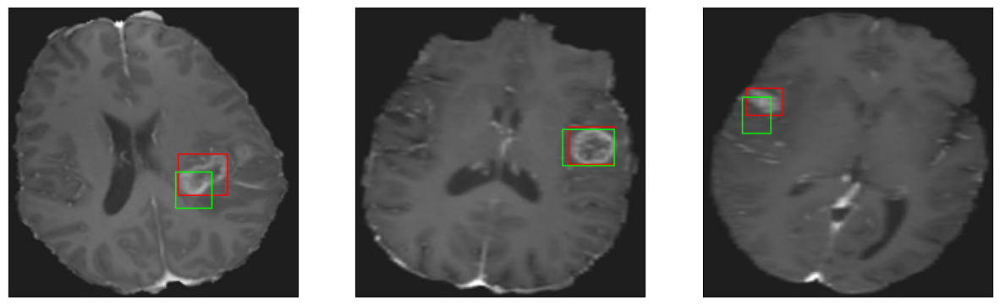

26/26 [==============================] - 8s 300ms/step - loss: 6.3330 - IoU: 0.5375 - val_loss: 8.6466 - val_IoU: 0.5275
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.0263 - IoU: 0.5549
Epoch 102: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


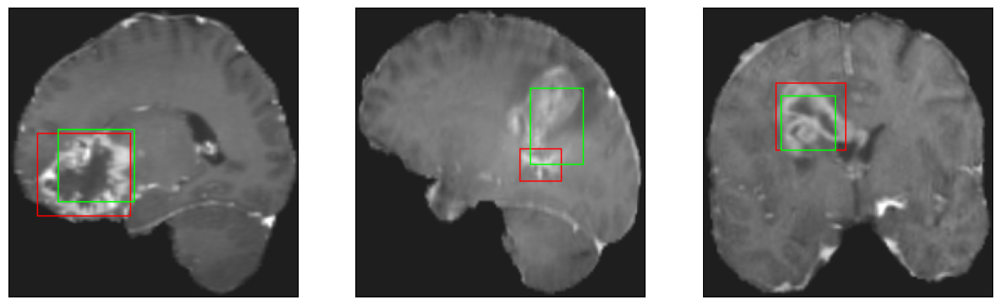

26/26 [==============================] - 8s 310ms/step - loss: 6.0263 - IoU: 0.5549 - val_loss: 8.5501 - val_IoU: 0.5151
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.1967 - IoU: 0.5424
Epoch 103: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


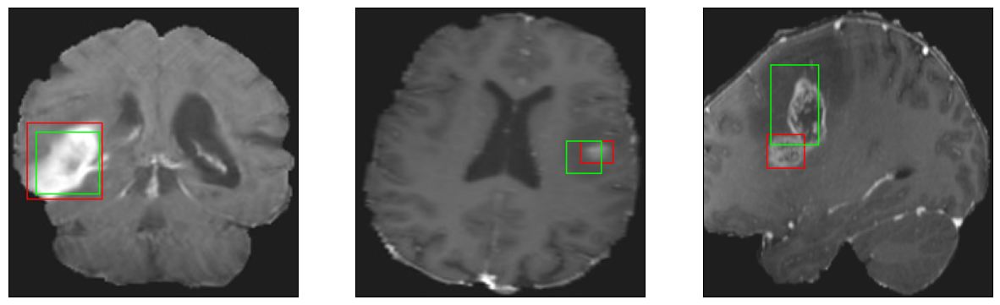

26/26 [==============================] - 8s 298ms/step - loss: 6.1967 - IoU: 0.5424 - val_loss: 8.4825 - val_IoU: 0.5181
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 5.9742 - IoU: 0.5549
Epoch 104: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


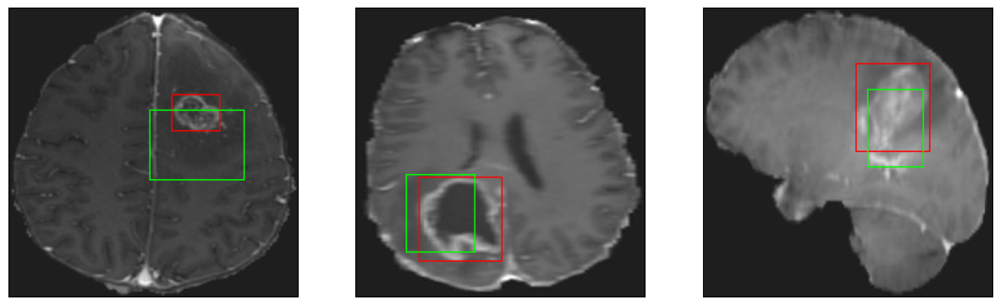

26/26 [==============================] - 7s 288ms/step - loss: 5.9742 - IoU: 0.5549 - val_loss: 8.8453 - val_IoU: 0.5097
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 5.9762 - IoU: 0.5613
Epoch 105: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


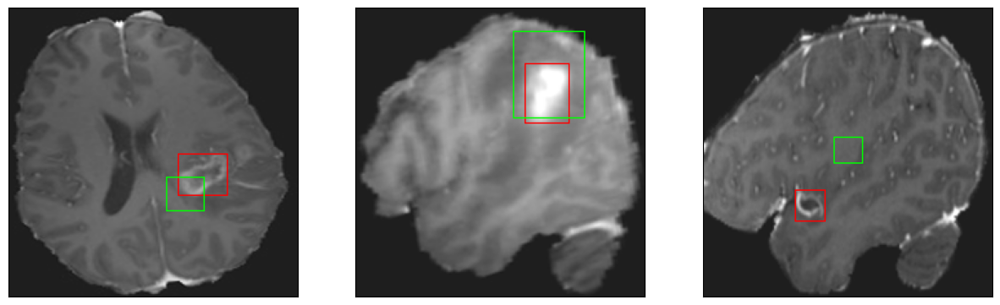

26/26 [==============================] - 8s 315ms/step - loss: 5.9762 - IoU: 0.5613 - val_loss: 9.1262 - val_IoU: 0.4877
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.3220 - IoU: 0.5345
Epoch 106: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


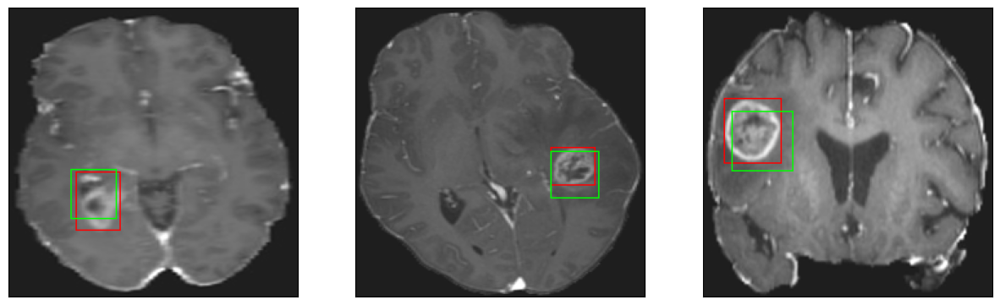

26/26 [==============================] - 8s 311ms/step - loss: 6.3220 - IoU: 0.5345 - val_loss: 9.1389 - val_IoU: 0.4838
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.2621 - IoU: 0.5435
Epoch 107: val_IoU did not improve from 0.53305
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


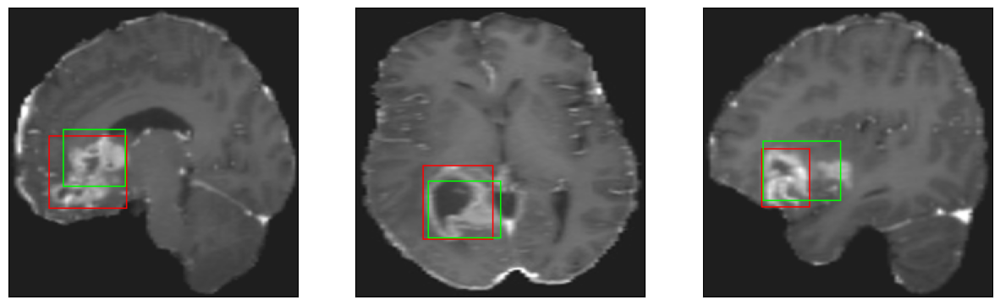

26/26 [==============================] - 7s 282ms/step - loss: 6.2621 - IoU: 0.5435 - val_loss: 8.5721 - val_IoU: 0.5205
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.1660 - IoU: 0.5455
Epoch 108: val_IoU improved from 0.53305 to 0.53437, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


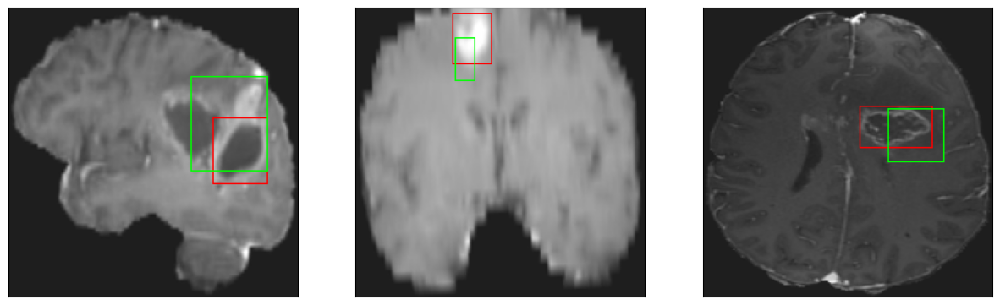

26/26 [==============================] - 33s 1s/step - loss: 6.1660 - IoU: 0.5455 - val_loss: 8.4052 - val_IoU: 0.5344
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 5.9724 - IoU: 0.5626
Epoch 109: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


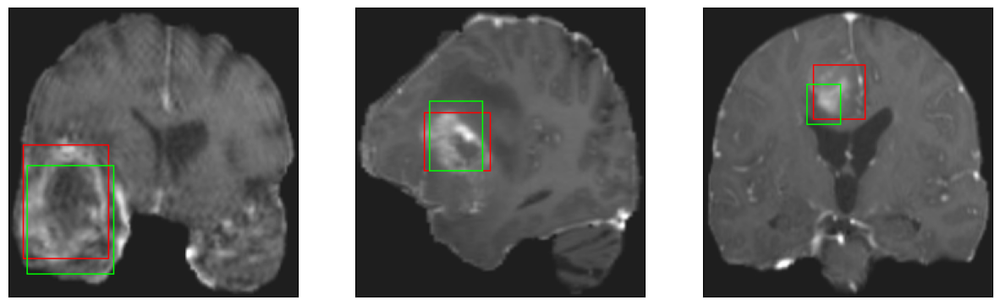

26/26 [==============================] - 8s 296ms/step - loss: 5.9724 - IoU: 0.5626 - val_loss: 8.7977 - val_IoU: 0.5045
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.0326 - IoU: 0.5505
Epoch 110: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


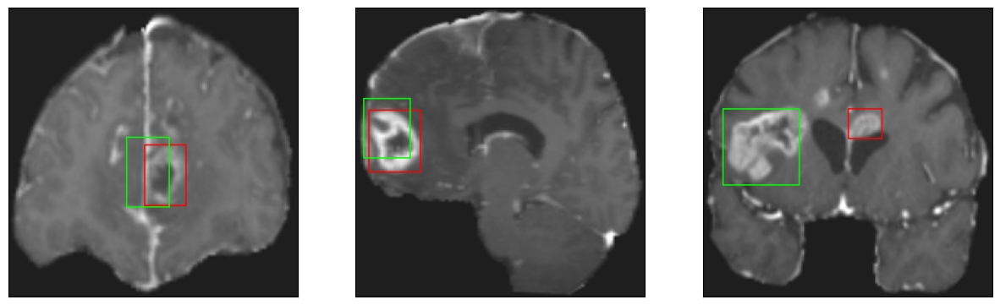

26/26 [==============================] - 8s 326ms/step - loss: 6.0326 - IoU: 0.5505 - val_loss: 9.2826 - val_IoU: 0.4840
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 5.8351 - IoU: 0.5631
Epoch 111: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


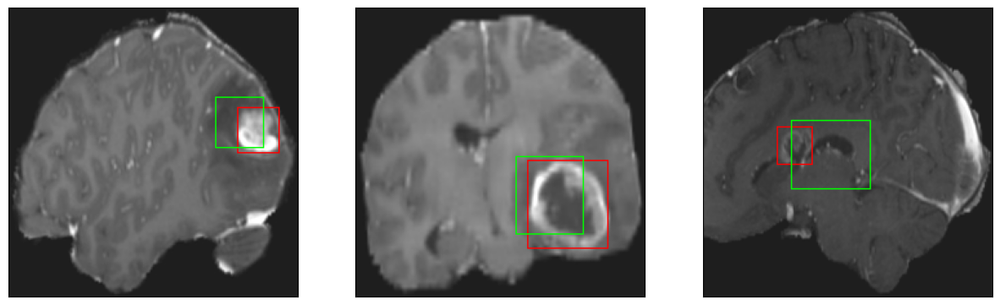

26/26 [==============================] - 8s 310ms/step - loss: 5.8351 - IoU: 0.5631 - val_loss: 11.0490 - val_IoU: 0.4031
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.1957 - IoU: 0.5456
Epoch 112: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 47ms/step
4


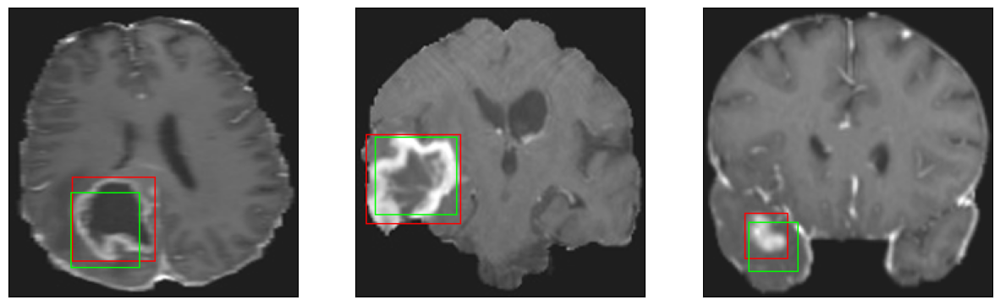

26/26 [==============================] - 8s 301ms/step - loss: 6.1957 - IoU: 0.5456 - val_loss: 8.9827 - val_IoU: 0.4906
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.1813 - IoU: 0.5450
Epoch 113: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


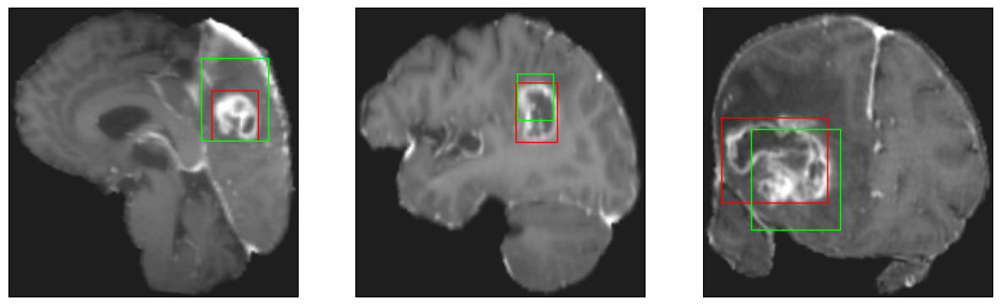

26/26 [==============================] - 8s 304ms/step - loss: 6.1813 - IoU: 0.5450 - val_loss: 9.1398 - val_IoU: 0.4849
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 5.9435 - IoU: 0.5589
Epoch 114: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


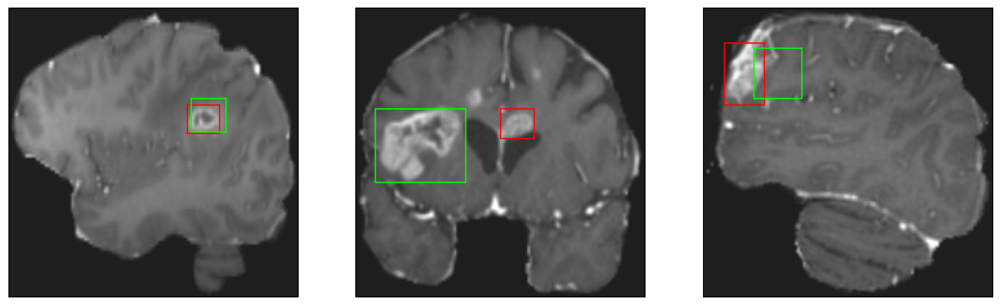

26/26 [==============================] - 8s 299ms/step - loss: 5.9435 - IoU: 0.5589 - val_loss: 8.8451 - val_IoU: 0.5121
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 5.7406 - IoU: 0.5699
Epoch 115: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


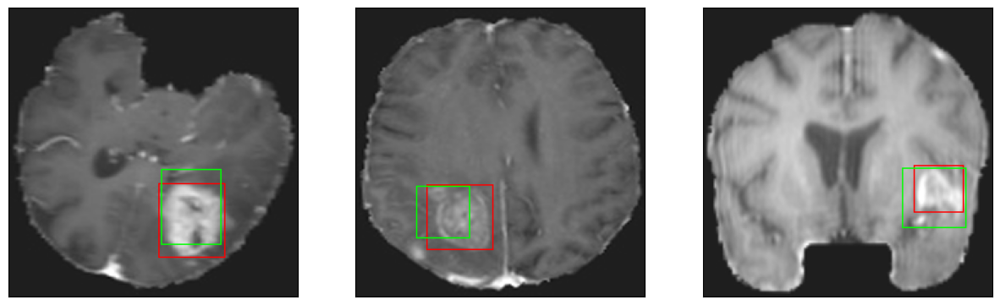

26/26 [==============================] - 8s 301ms/step - loss: 5.7406 - IoU: 0.5699 - val_loss: 9.0969 - val_IoU: 0.4949
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 5.9632 - IoU: 0.5478
Epoch 116: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


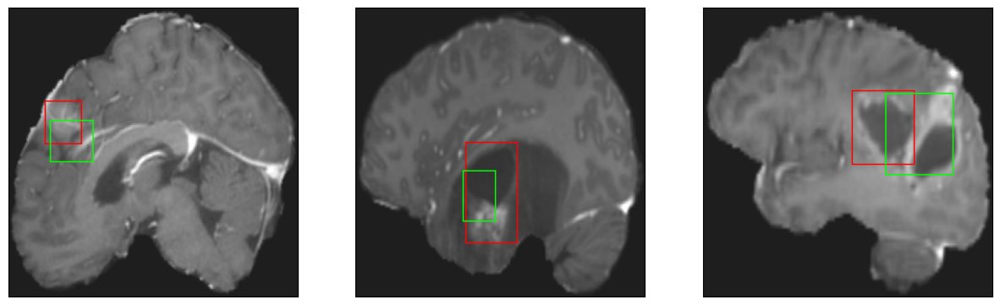

26/26 [==============================] - 7s 275ms/step - loss: 5.9632 - IoU: 0.5478 - val_loss: 8.4065 - val_IoU: 0.5249
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 6.0652 - IoU: 0.5482
Epoch 117: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


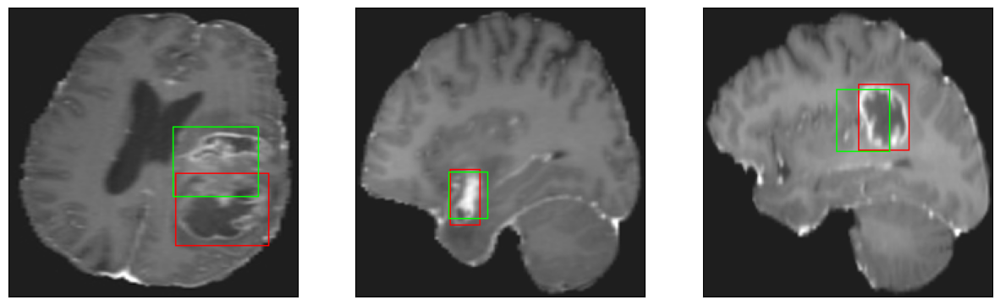

26/26 [==============================] - 8s 306ms/step - loss: 6.0652 - IoU: 0.5482 - val_loss: 8.4375 - val_IoU: 0.5296
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.1606 - IoU: 0.5429
Epoch 118: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


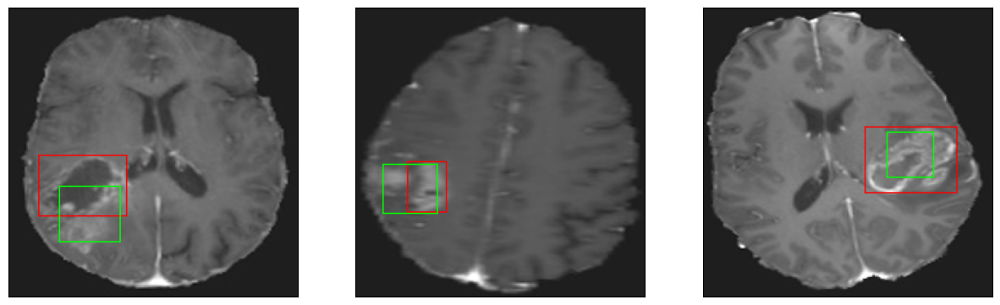

26/26 [==============================] - 8s 306ms/step - loss: 6.1606 - IoU: 0.5429 - val_loss: 9.9743 - val_IoU: 0.4327
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 6.0265 - IoU: 0.5454
Epoch 119: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


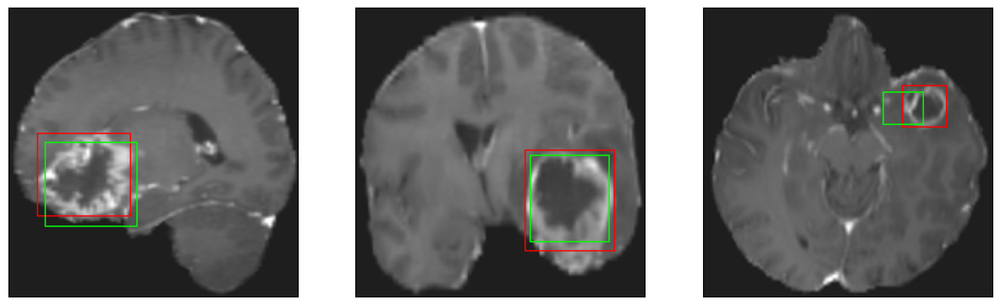

26/26 [==============================] - 7s 288ms/step - loss: 6.0265 - IoU: 0.5454 - val_loss: 8.6491 - val_IoU: 0.5213
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 5.9607 - IoU: 0.5632
Epoch 120: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


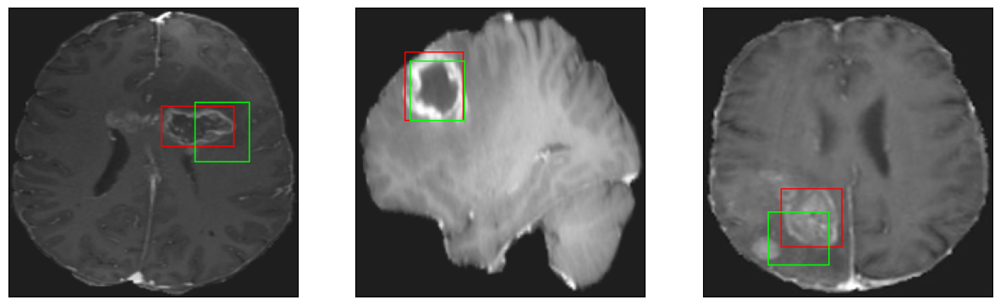

26/26 [==============================] - 7s 287ms/step - loss: 5.9607 - IoU: 0.5632 - val_loss: 8.6288 - val_IoU: 0.5162
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 5.8989 - IoU: 0.5623
Epoch 121: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


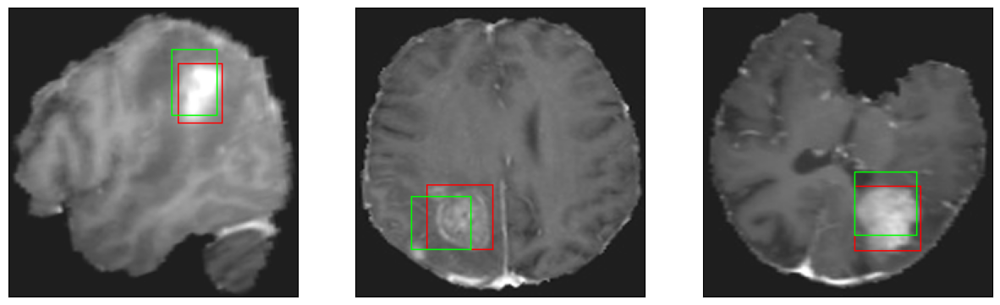

26/26 [==============================] - 8s 316ms/step - loss: 5.8989 - IoU: 0.5623 - val_loss: 9.3021 - val_IoU: 0.4596
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 5.9181 - IoU: 0.5550
Epoch 122: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


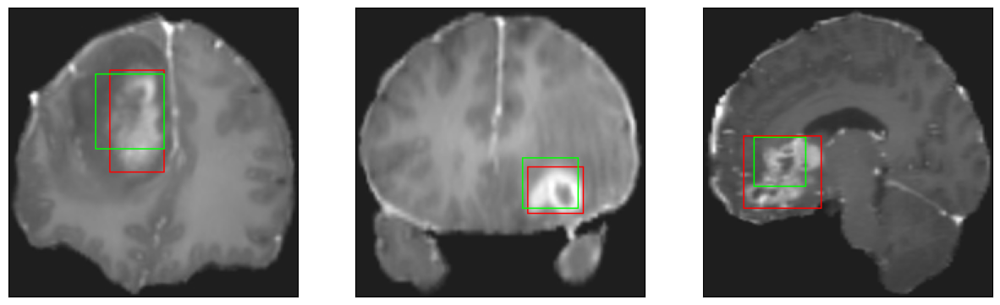

26/26 [==============================] - 8s 300ms/step - loss: 5.9181 - IoU: 0.5550 - val_loss: 9.6038 - val_IoU: 0.4626
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.2659 - IoU: 0.5387
Epoch 123: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


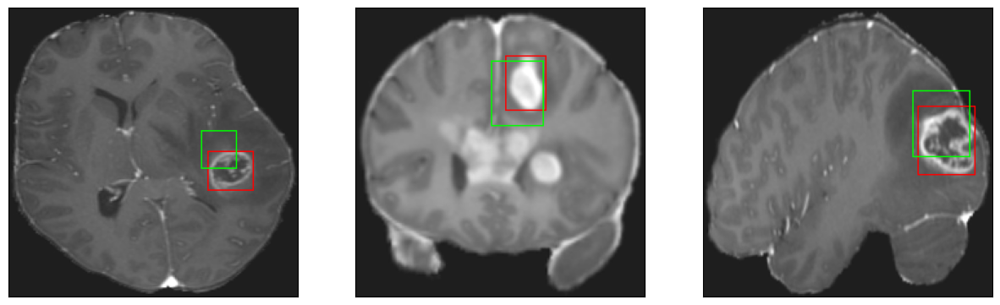

26/26 [==============================] - 8s 305ms/step - loss: 6.2659 - IoU: 0.5387 - val_loss: 9.7387 - val_IoU: 0.4379
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 5.7957 - IoU: 0.5611
Epoch 124: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


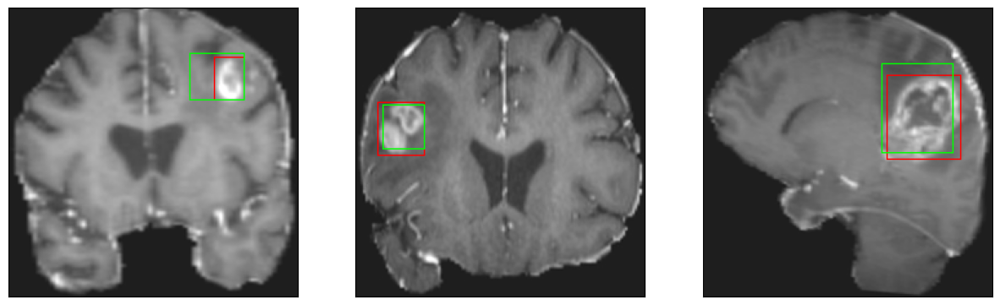

26/26 [==============================] - 7s 282ms/step - loss: 5.7957 - IoU: 0.5611 - val_loss: 8.3910 - val_IoU: 0.5210
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 5.6207 - IoU: 0.5689
Epoch 125: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


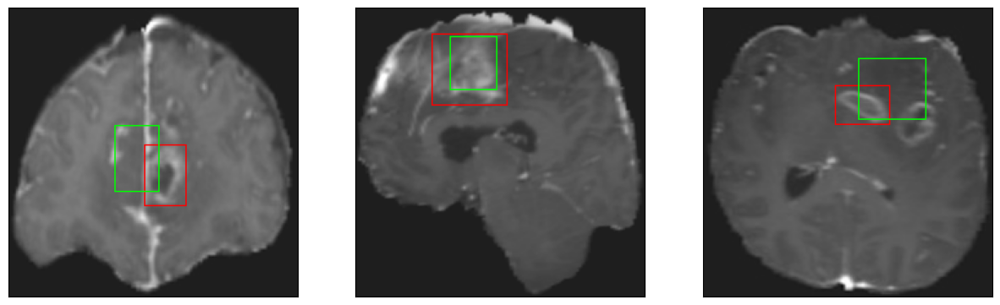

26/26 [==============================] - 7s 272ms/step - loss: 5.6207 - IoU: 0.5689 - val_loss: 9.0254 - val_IoU: 0.4988
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 5.5588 - IoU: 0.5759
Epoch 126: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


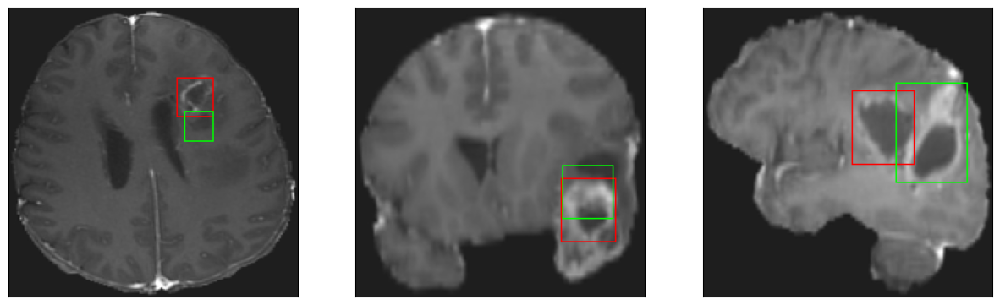

26/26 [==============================] - 8s 307ms/step - loss: 5.5588 - IoU: 0.5759 - val_loss: 9.0502 - val_IoU: 0.4874
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 6.0921 - IoU: 0.5470
Epoch 127: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


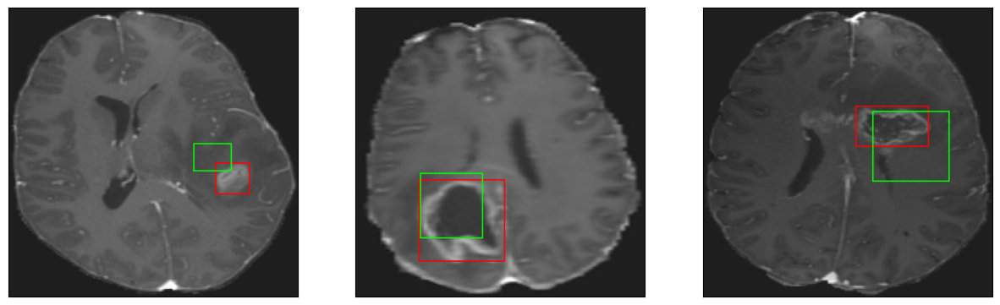

26/26 [==============================] - 8s 299ms/step - loss: 6.0921 - IoU: 0.5470 - val_loss: 9.4939 - val_IoU: 0.4540
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 6.1391 - IoU: 0.5390
Epoch 128: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


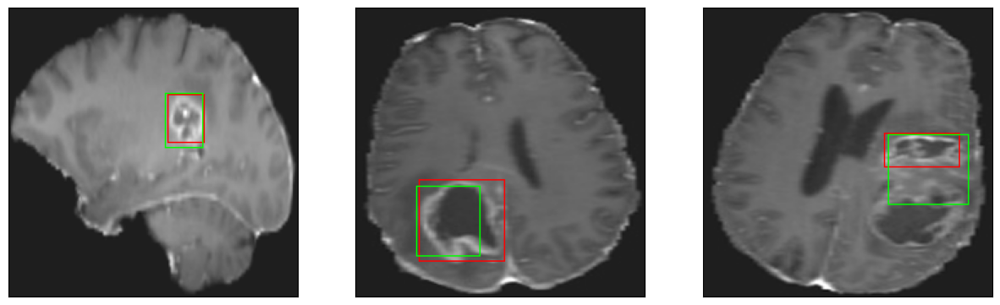

26/26 [==============================] - 8s 311ms/step - loss: 6.1391 - IoU: 0.5390 - val_loss: 8.7534 - val_IoU: 0.4827
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 6.0067 - IoU: 0.5492
Epoch 129: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


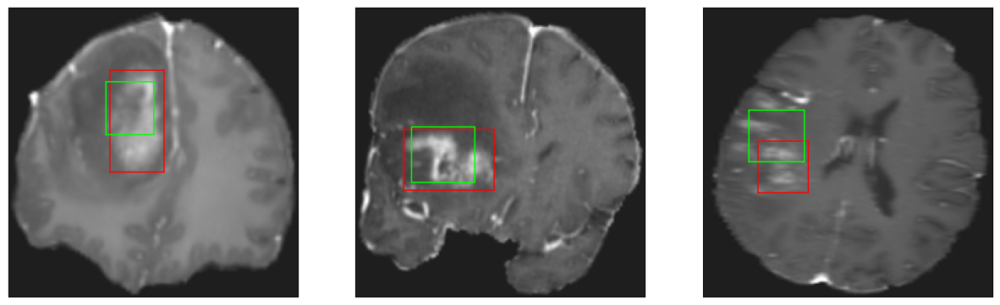

26/26 [==============================] - 8s 300ms/step - loss: 6.0067 - IoU: 0.5492 - val_loss: 9.7986 - val_IoU: 0.4654
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 5.7616 - IoU: 0.5661
Epoch 130: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


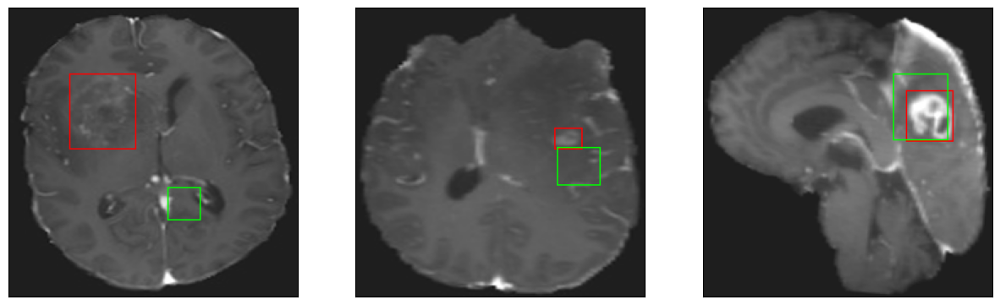

26/26 [==============================] - 8s 298ms/step - loss: 5.7616 - IoU: 0.5661 - val_loss: 10.0350 - val_IoU: 0.4594
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 5.8417 - IoU: 0.5707
Epoch 131: val_IoU did not improve from 0.53437
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4


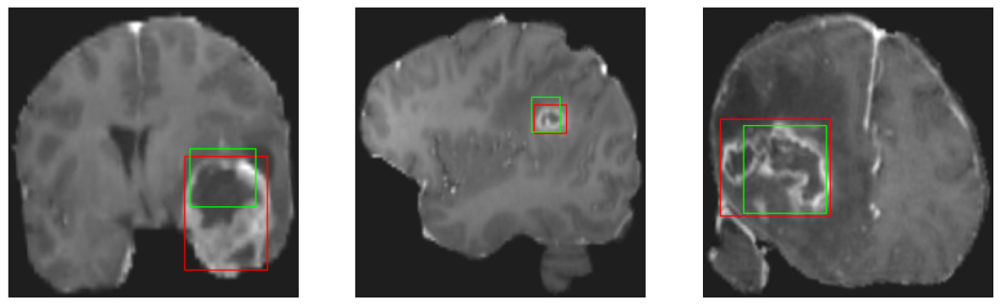

26/26 [==============================] - 8s 303ms/step - loss: 5.8417 - IoU: 0.5707 - val_loss: 10.8224 - val_IoU: 0.3706
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 6.0518 - IoU: 0.5491
Epoch 132: val_IoU improved from 0.53437 to 0.55125, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


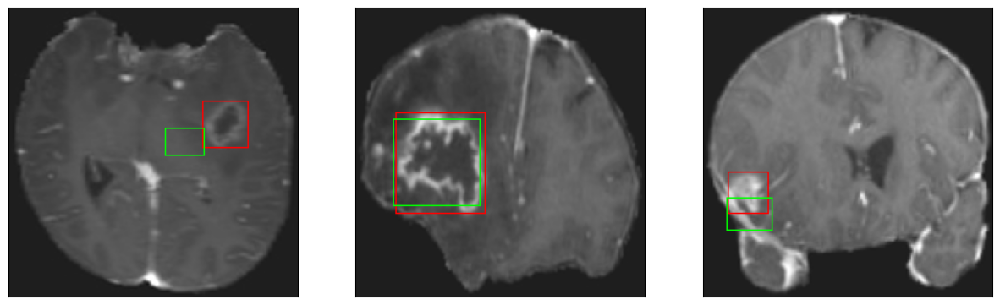

26/26 [==============================] - 29s 1s/step - loss: 6.0518 - IoU: 0.5491 - val_loss: 8.0327 - val_IoU: 0.5512
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 5.6740 - IoU: 0.5790
Epoch 133: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


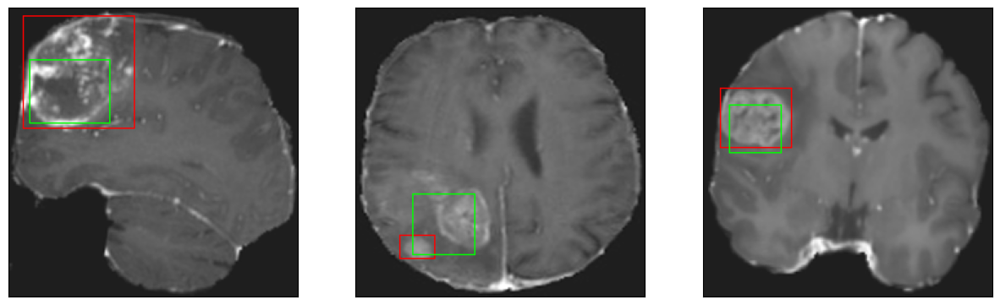

26/26 [==============================] - 8s 305ms/step - loss: 5.6740 - IoU: 0.5790 - val_loss: 8.9862 - val_IoU: 0.4809
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.7434 - IoU: 0.5721
Epoch 134: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


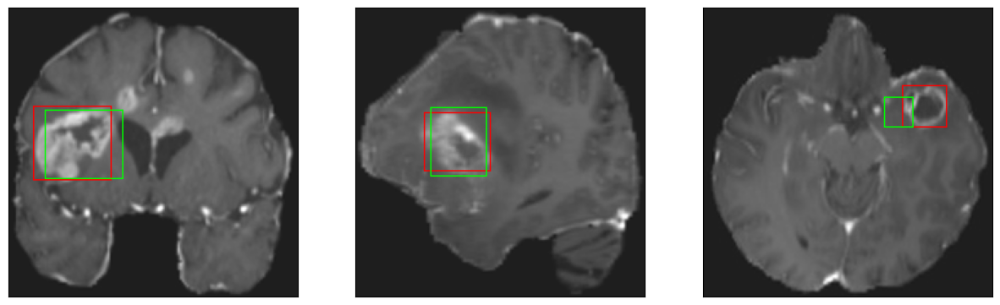

26/26 [==============================] - 8s 304ms/step - loss: 5.7434 - IoU: 0.5721 - val_loss: 9.1471 - val_IoU: 0.5058
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 6.0013 - IoU: 0.5599
Epoch 135: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


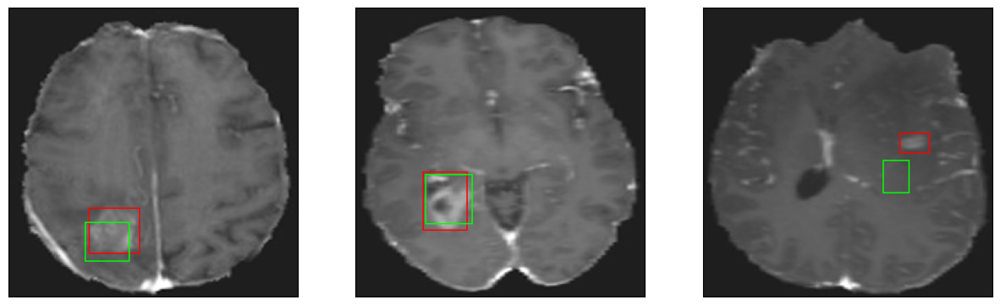

26/26 [==============================] - 8s 310ms/step - loss: 6.0013 - IoU: 0.5599 - val_loss: 8.9307 - val_IoU: 0.5095
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.6833 - IoU: 0.5688
Epoch 136: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


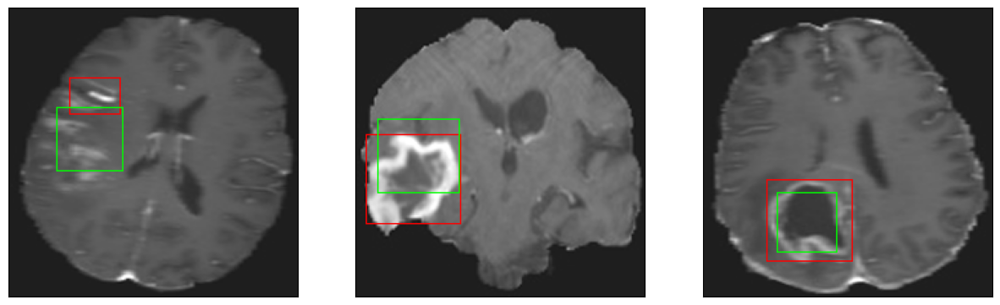

26/26 [==============================] - 7s 278ms/step - loss: 5.6833 - IoU: 0.5688 - val_loss: 8.7704 - val_IoU: 0.5058
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 5.6289 - IoU: 0.5771
Epoch 137: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


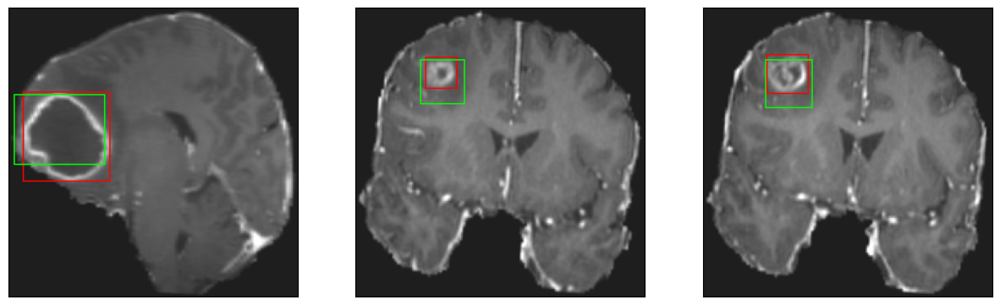

26/26 [==============================] - 7s 281ms/step - loss: 5.6289 - IoU: 0.5771 - val_loss: 9.6753 - val_IoU: 0.4457
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.5491 - IoU: 0.5779
Epoch 138: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


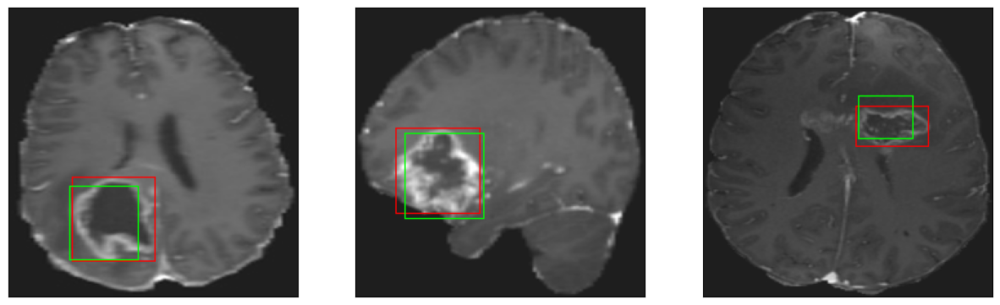

26/26 [==============================] - 7s 275ms/step - loss: 5.5491 - IoU: 0.5779 - val_loss: 9.0493 - val_IoU: 0.5111
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 5.5277 - IoU: 0.5779
Epoch 139: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


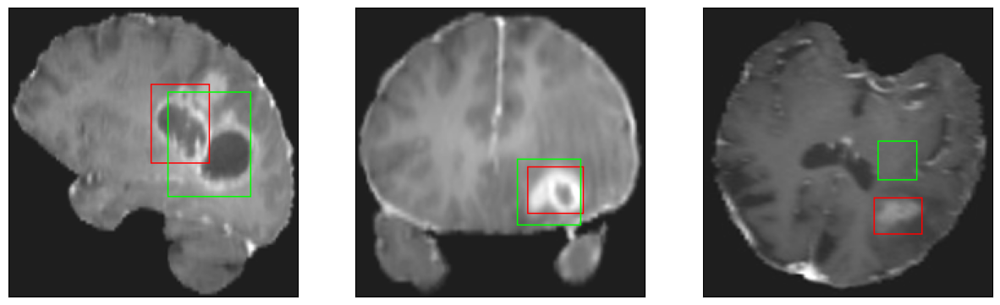

26/26 [==============================] - 8s 308ms/step - loss: 5.5277 - IoU: 0.5779 - val_loss: 8.6820 - val_IoU: 0.5161
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 5.3588 - IoU: 0.5983
Epoch 140: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


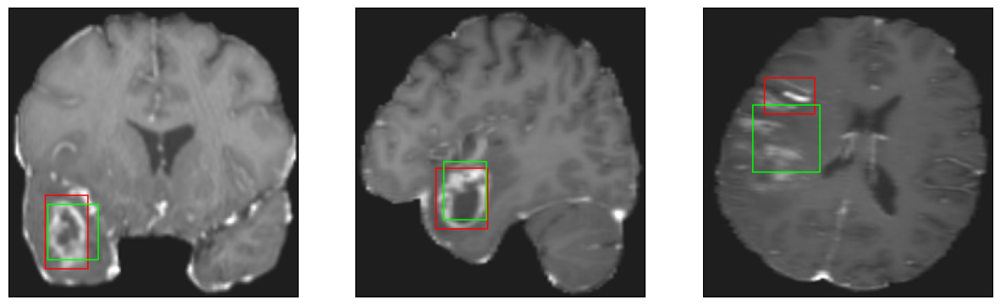

26/26 [==============================] - 8s 300ms/step - loss: 5.3588 - IoU: 0.5983 - val_loss: 8.6824 - val_IoU: 0.4992
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.5564 - IoU: 0.5712
Epoch 141: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


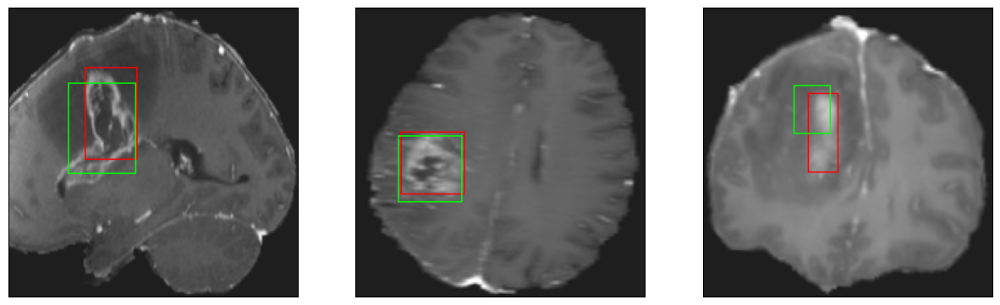

26/26 [==============================] - 8s 304ms/step - loss: 5.5564 - IoU: 0.5712 - val_loss: 8.6396 - val_IoU: 0.5145
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.5503 - IoU: 0.5797
Epoch 142: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


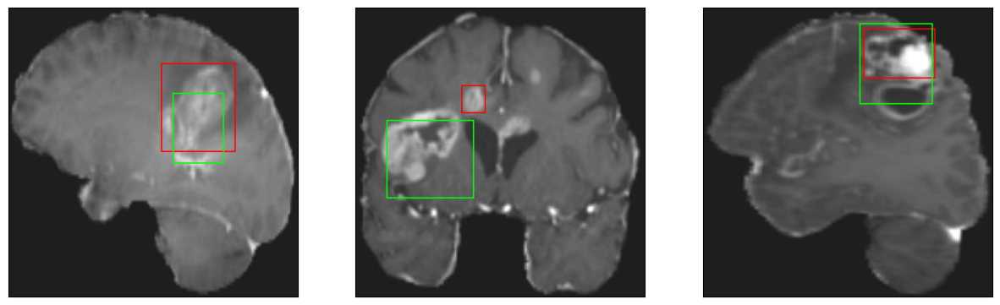

26/26 [==============================] - 8s 290ms/step - loss: 5.5503 - IoU: 0.5797 - val_loss: 8.4001 - val_IoU: 0.5384
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 5.8103 - IoU: 0.5710
Epoch 143: val_IoU did not improve from 0.55125
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


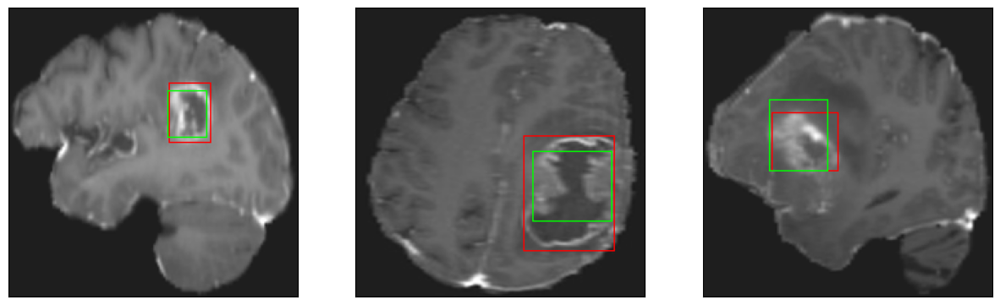

26/26 [==============================] - 7s 280ms/step - loss: 5.8103 - IoU: 0.5710 - val_loss: 8.2886 - val_IoU: 0.5347
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.6150 - IoU: 0.5761
Epoch 144: val_IoU improved from 0.55125 to 0.55174, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


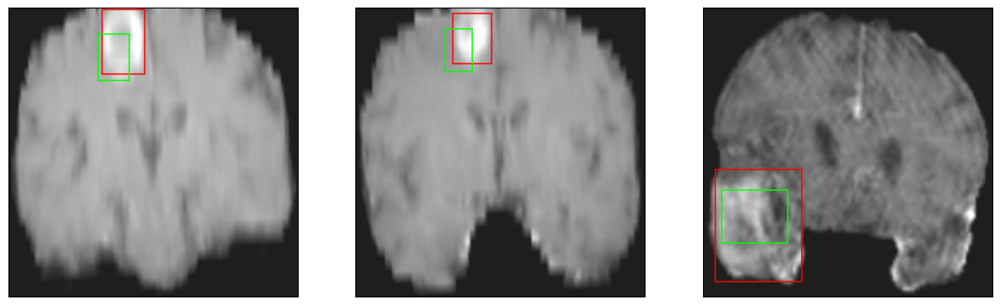

26/26 [==============================] - 25s 971ms/step - loss: 5.6150 - IoU: 0.5761 - val_loss: 8.1368 - val_IoU: 0.5517
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 5.7568 - IoU: 0.5648
Epoch 145: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


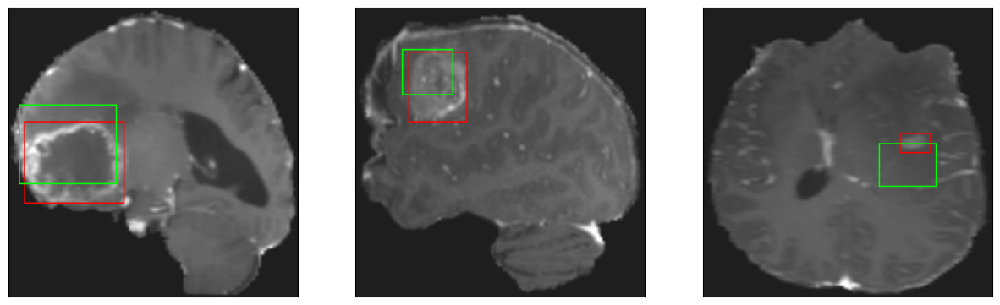

26/26 [==============================] - 8s 298ms/step - loss: 5.7568 - IoU: 0.5648 - val_loss: 9.3925 - val_IoU: 0.4895
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.4774 - IoU: 0.5816
Epoch 146: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


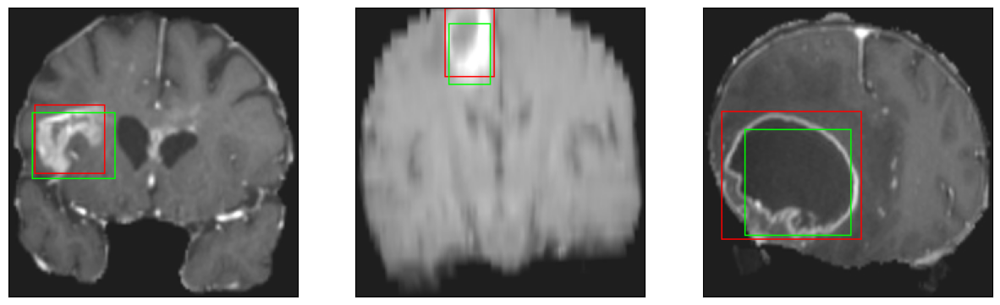

26/26 [==============================] - 7s 288ms/step - loss: 5.4774 - IoU: 0.5816 - val_loss: 8.5422 - val_IoU: 0.5067
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 6.1185 - IoU: 0.5439
Epoch 147: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


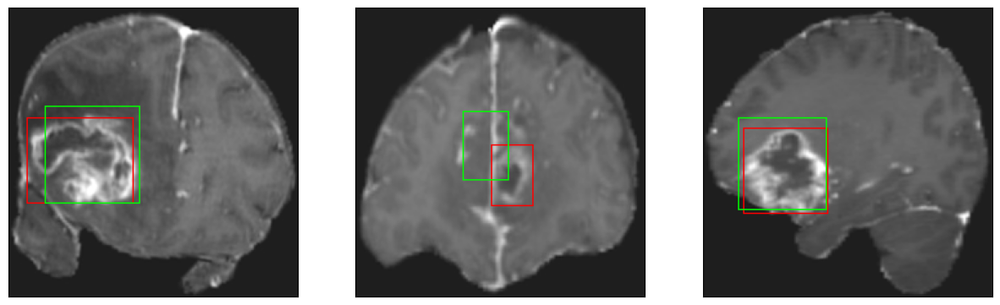

26/26 [==============================] - 8s 293ms/step - loss: 6.1185 - IoU: 0.5439 - val_loss: 9.4355 - val_IoU: 0.4438
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 5.7557 - IoU: 0.5578
Epoch 148: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


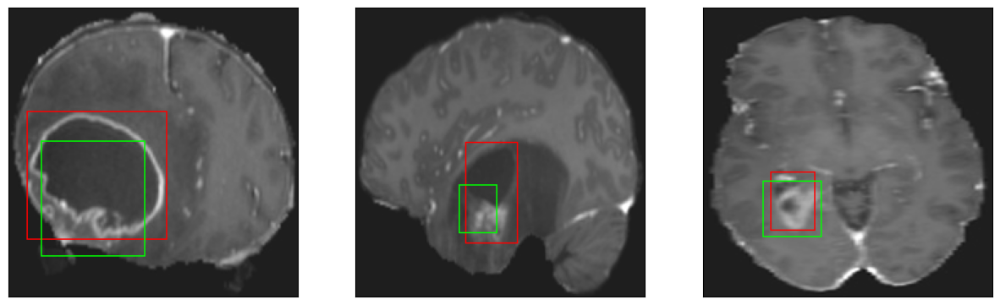

26/26 [==============================] - 8s 297ms/step - loss: 5.7557 - IoU: 0.5578 - val_loss: 8.0964 - val_IoU: 0.5401
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.5653 - IoU: 0.5730
Epoch 149: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


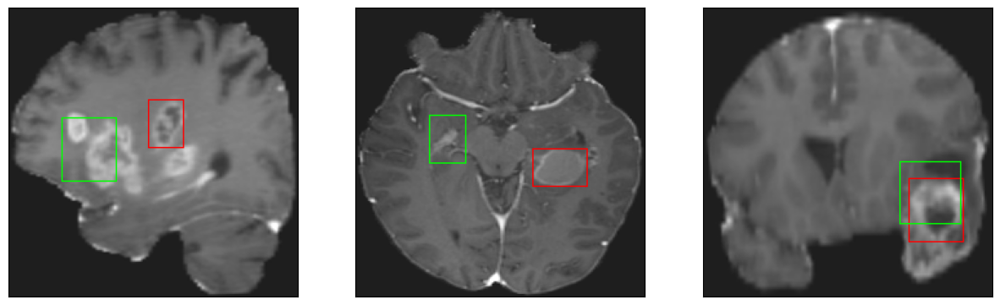

26/26 [==============================] - 8s 301ms/step - loss: 5.5653 - IoU: 0.5730 - val_loss: 8.9373 - val_IoU: 0.4998
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.7398 - IoU: 0.5726
Epoch 150: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


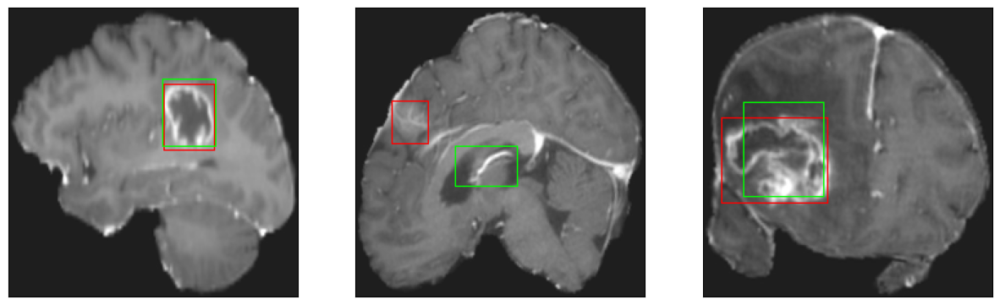

26/26 [==============================] - 8s 317ms/step - loss: 5.7398 - IoU: 0.5726 - val_loss: 8.6461 - val_IoU: 0.4962
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.2985 - IoU: 0.5916
Epoch 151: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


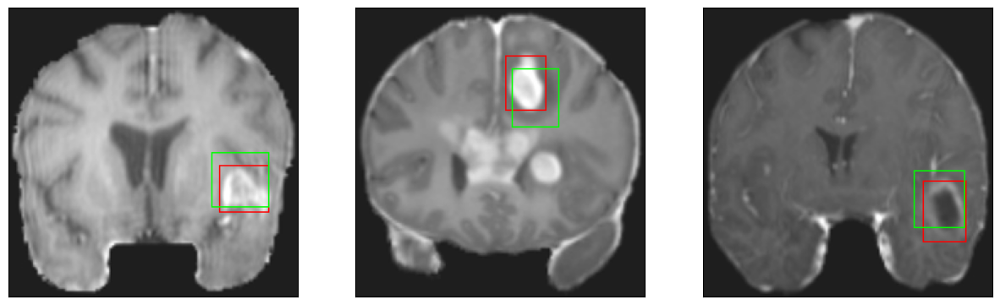

26/26 [==============================] - 8s 303ms/step - loss: 5.2985 - IoU: 0.5916 - val_loss: 8.9329 - val_IoU: 0.5080
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.6192 - IoU: 0.5796
Epoch 152: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


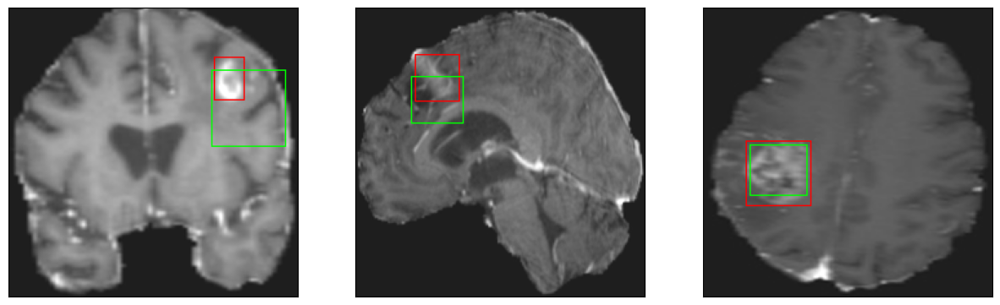

26/26 [==============================] - 7s 285ms/step - loss: 5.6192 - IoU: 0.5796 - val_loss: 9.5365 - val_IoU: 0.4970
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 5.6134 - IoU: 0.5790
Epoch 153: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


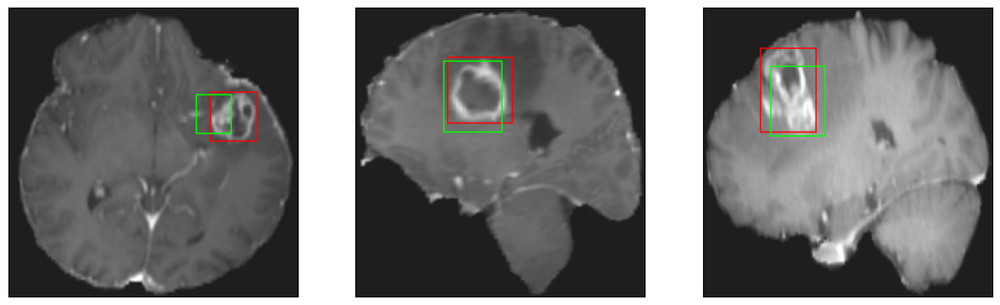

26/26 [==============================] - 8s 293ms/step - loss: 5.6134 - IoU: 0.5790 - val_loss: 9.2259 - val_IoU: 0.5083
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.6838 - IoU: 0.5749
Epoch 154: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


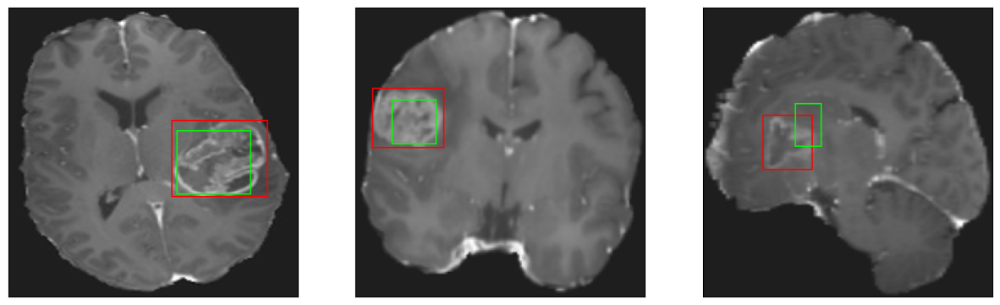

26/26 [==============================] - 8s 299ms/step - loss: 5.6838 - IoU: 0.5749 - val_loss: 8.8063 - val_IoU: 0.4931
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.5351 - IoU: 0.5791
Epoch 155: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


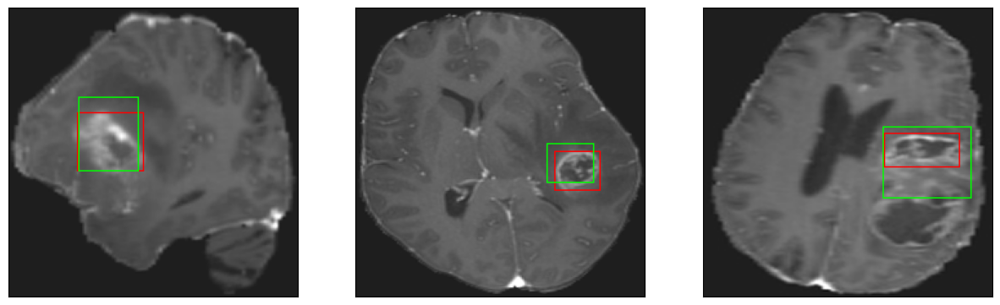

26/26 [==============================] - 7s 287ms/step - loss: 5.5351 - IoU: 0.5791 - val_loss: 8.4588 - val_IoU: 0.5046
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.4793 - IoU: 0.5798
Epoch 156: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


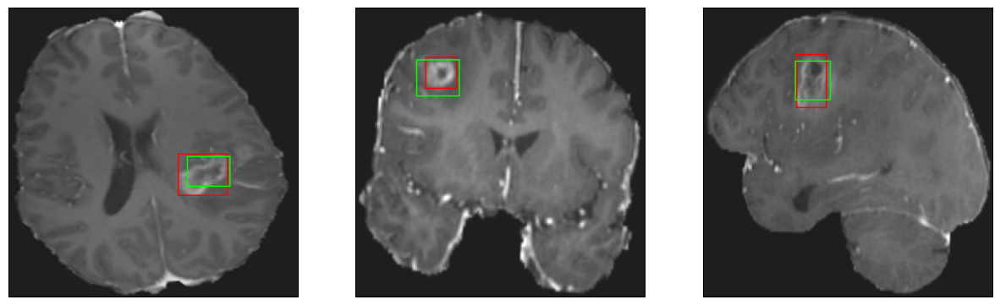

26/26 [==============================] - 8s 307ms/step - loss: 5.4793 - IoU: 0.5798 - val_loss: 8.6648 - val_IoU: 0.5135
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.3598 - IoU: 0.5903
Epoch 157: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


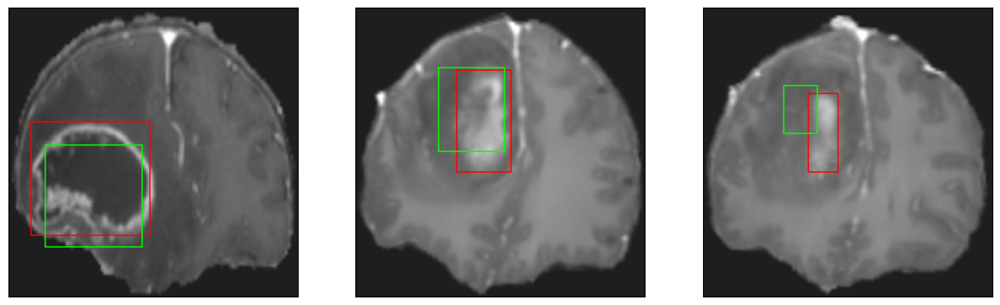

26/26 [==============================] - 8s 295ms/step - loss: 5.3598 - IoU: 0.5903 - val_loss: 8.7444 - val_IoU: 0.4952
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.3490 - IoU: 0.5868
Epoch 158: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


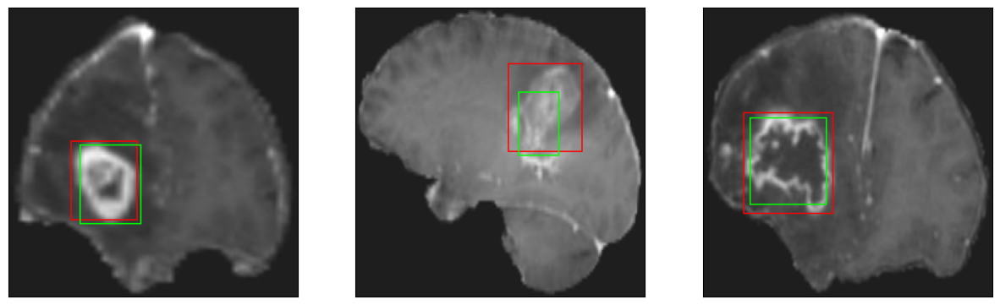

26/26 [==============================] - 8s 297ms/step - loss: 5.3490 - IoU: 0.5868 - val_loss: 8.2534 - val_IoU: 0.5406
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.5429 - IoU: 0.5747
Epoch 159: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


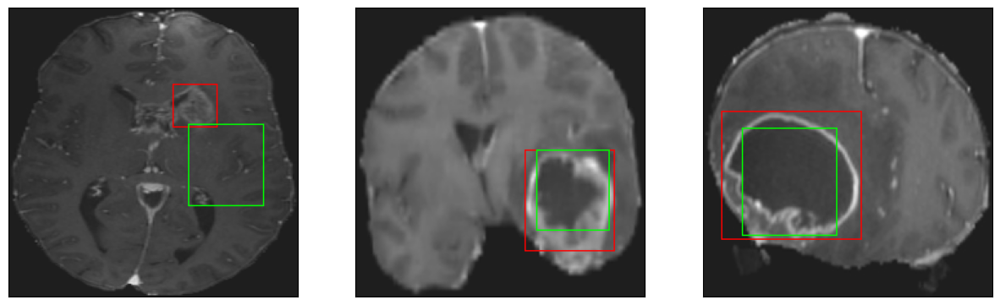

26/26 [==============================] - 7s 273ms/step - loss: 5.5429 - IoU: 0.5747 - val_loss: 8.3657 - val_IoU: 0.5443
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.5229 - IoU: 0.5733
Epoch 160: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


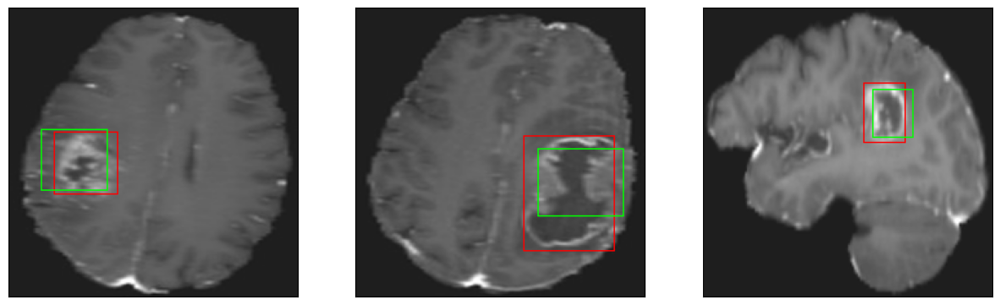

26/26 [==============================] - 8s 293ms/step - loss: 5.5229 - IoU: 0.5733 - val_loss: 9.3611 - val_IoU: 0.4619
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.4449 - IoU: 0.5836
Epoch 161: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


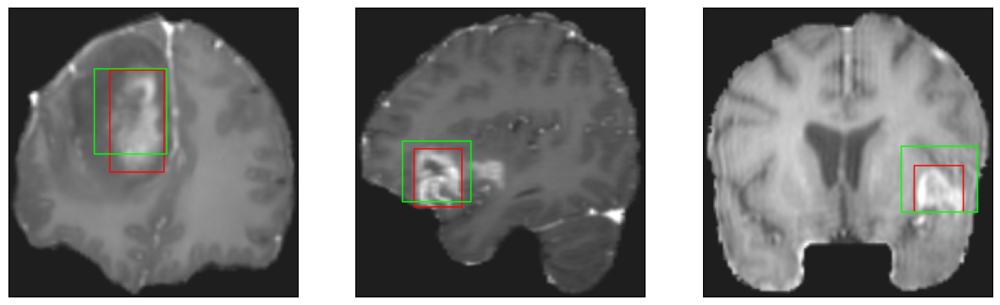

26/26 [==============================] - 7s 280ms/step - loss: 5.4449 - IoU: 0.5836 - val_loss: 9.1777 - val_IoU: 0.4931
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.5236 - IoU: 0.5842
Epoch 162: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


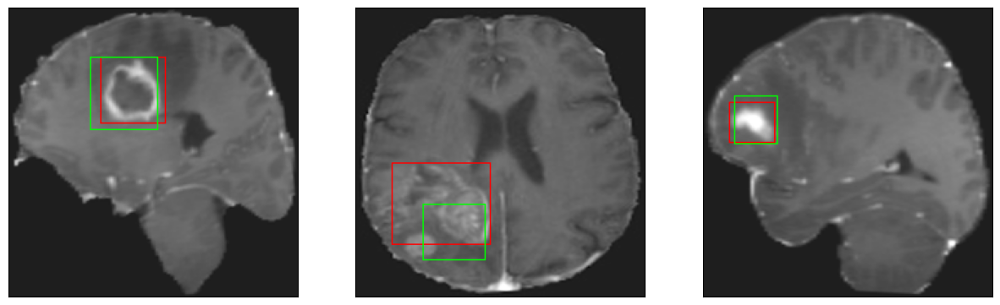

26/26 [==============================] - 7s 286ms/step - loss: 5.5236 - IoU: 0.5842 - val_loss: 8.6185 - val_IoU: 0.5205
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.6384 - IoU: 0.5674
Epoch 163: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


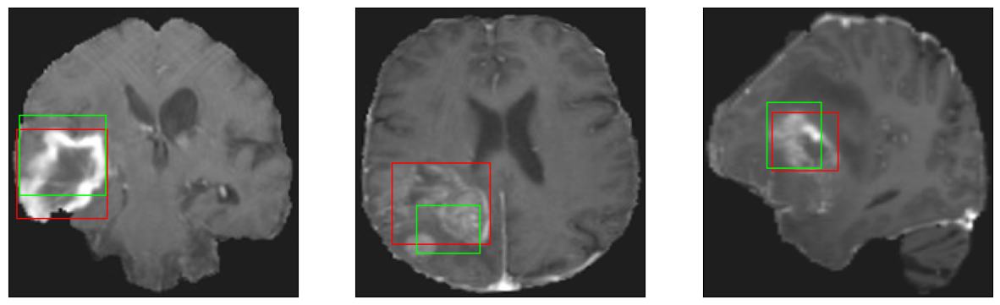

26/26 [==============================] - 7s 270ms/step - loss: 5.6384 - IoU: 0.5674 - val_loss: 9.0664 - val_IoU: 0.5002
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.2017 - IoU: 0.5878
Epoch 164: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


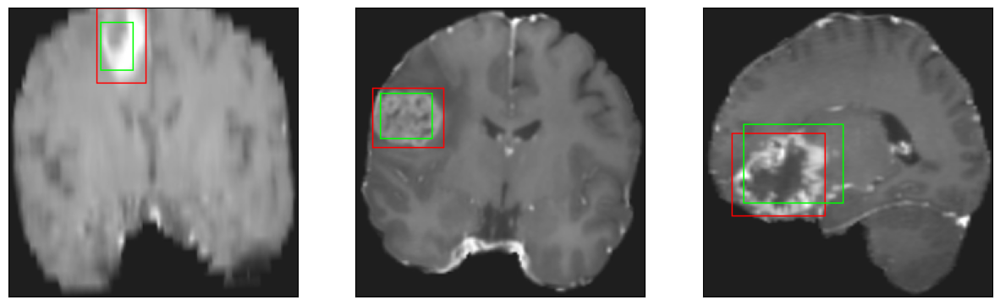

26/26 [==============================] - 8s 293ms/step - loss: 5.2017 - IoU: 0.5878 - val_loss: 8.4735 - val_IoU: 0.5302
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.9213 - IoU: 0.5688
Epoch 165: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


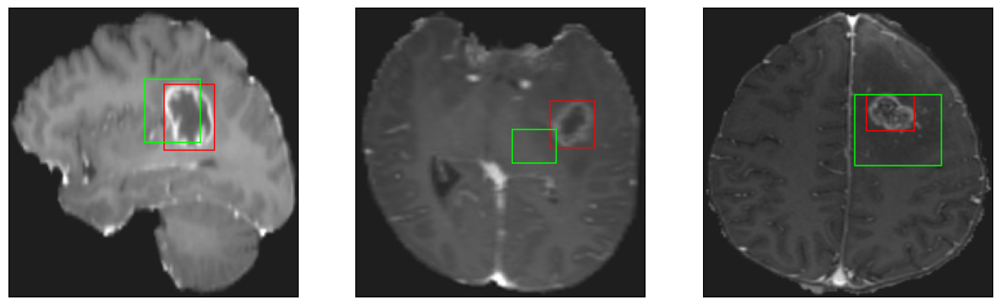

26/26 [==============================] - 7s 270ms/step - loss: 5.9213 - IoU: 0.5688 - val_loss: 8.2739 - val_IoU: 0.5268
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.4725 - IoU: 0.5765
Epoch 166: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


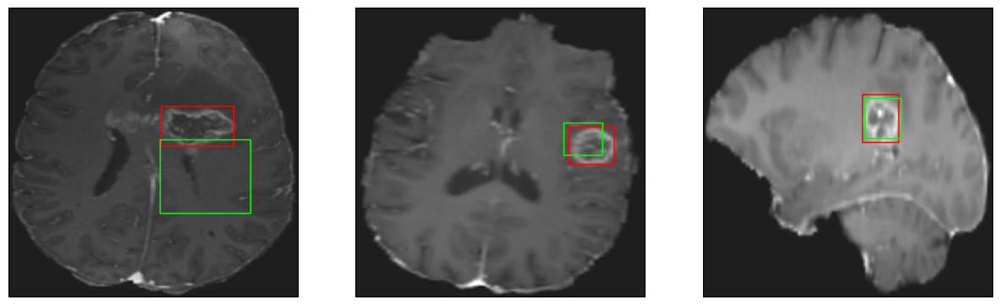

26/26 [==============================] - 8s 313ms/step - loss: 5.4725 - IoU: 0.5765 - val_loss: 8.2429 - val_IoU: 0.5348
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.5794 - IoU: 0.5761
Epoch 167: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4


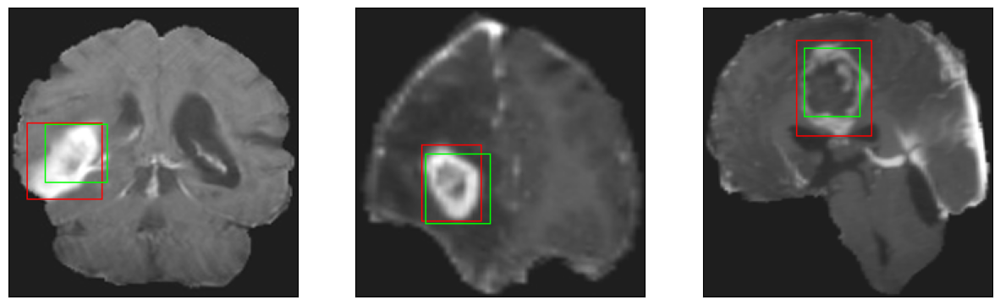

26/26 [==============================] - 8s 300ms/step - loss: 5.5794 - IoU: 0.5761 - val_loss: 8.2088 - val_IoU: 0.5424
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.6304 - IoU: 0.5647
Epoch 168: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


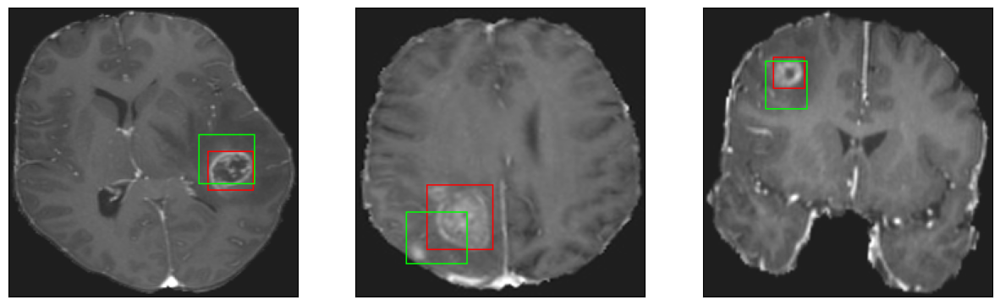

26/26 [==============================] - 7s 274ms/step - loss: 5.6304 - IoU: 0.5647 - val_loss: 9.9673 - val_IoU: 0.4858
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.5207 - IoU: 0.5747
Epoch 169: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


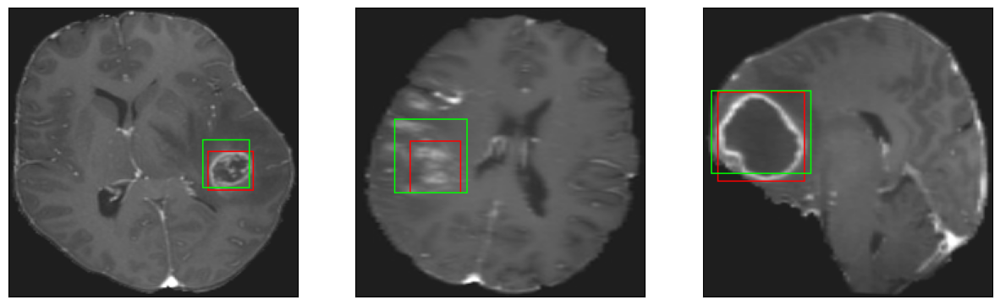

26/26 [==============================] - 7s 272ms/step - loss: 5.5207 - IoU: 0.5747 - val_loss: 8.2215 - val_IoU: 0.5426
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.4702 - IoU: 0.5789
Epoch 170: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


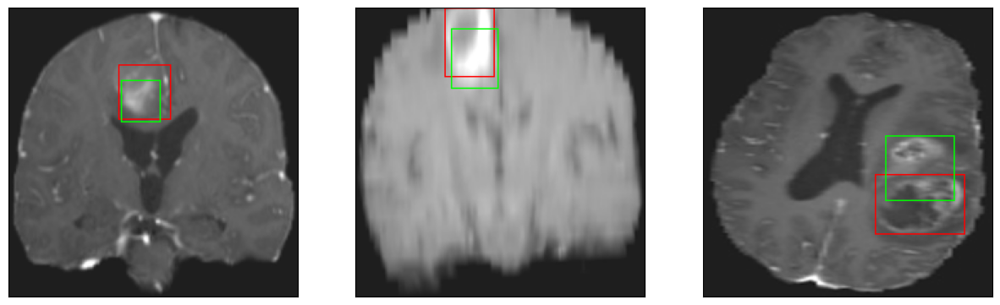

26/26 [==============================] - 7s 289ms/step - loss: 5.4702 - IoU: 0.5789 - val_loss: 9.7987 - val_IoU: 0.4728
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.6192 - IoU: 0.5659
Epoch 171: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


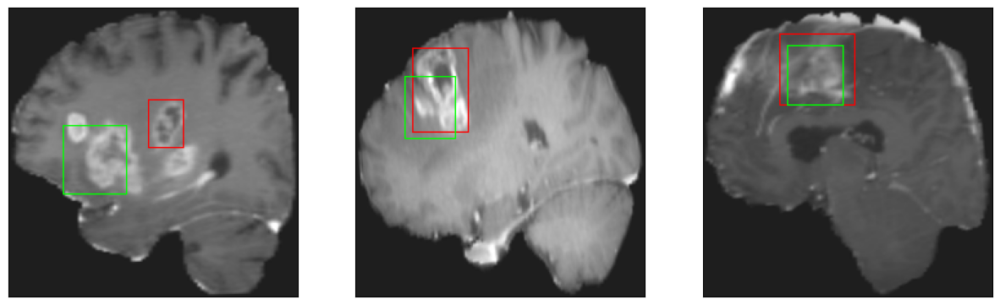

26/26 [==============================] - 8s 304ms/step - loss: 5.6192 - IoU: 0.5659 - val_loss: 8.7021 - val_IoU: 0.5279
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.2452 - IoU: 0.6003
Epoch 172: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


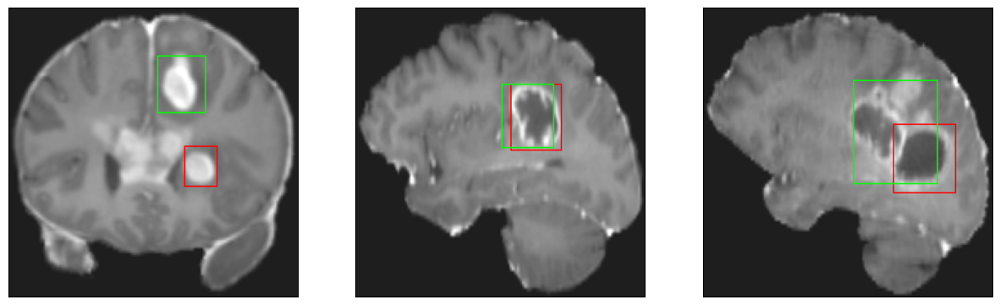

26/26 [==============================] - 8s 295ms/step - loss: 5.2452 - IoU: 0.6003 - val_loss: 9.2711 - val_IoU: 0.4808
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.1591 - IoU: 0.6061
Epoch 173: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


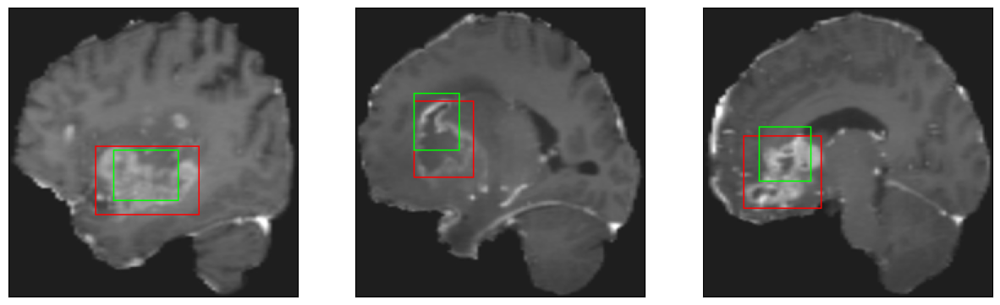

26/26 [==============================] - 7s 290ms/step - loss: 5.1591 - IoU: 0.6061 - val_loss: 9.4832 - val_IoU: 0.4976
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.3586 - IoU: 0.5854
Epoch 174: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


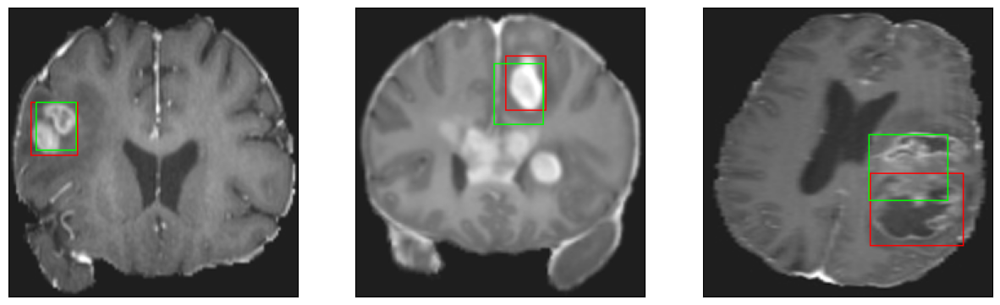

26/26 [==============================] - 7s 272ms/step - loss: 5.3586 - IoU: 0.5854 - val_loss: 8.1985 - val_IoU: 0.5327
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.2390 - IoU: 0.5857
Epoch 175: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


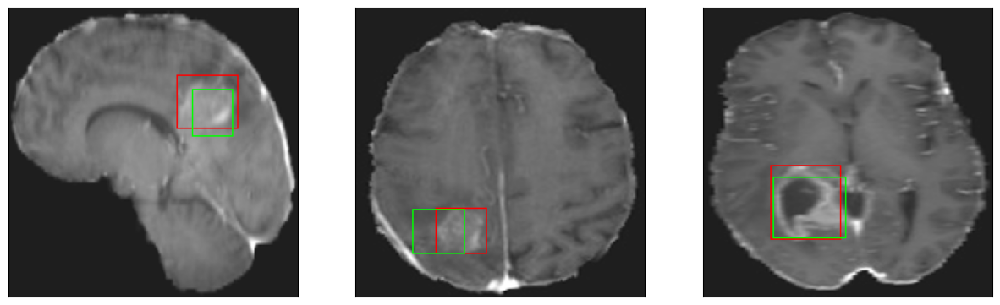

26/26 [==============================] - 7s 279ms/step - loss: 5.2390 - IoU: 0.5857 - val_loss: 9.0083 - val_IoU: 0.5095
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.4784 - IoU: 0.5915
Epoch 176: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


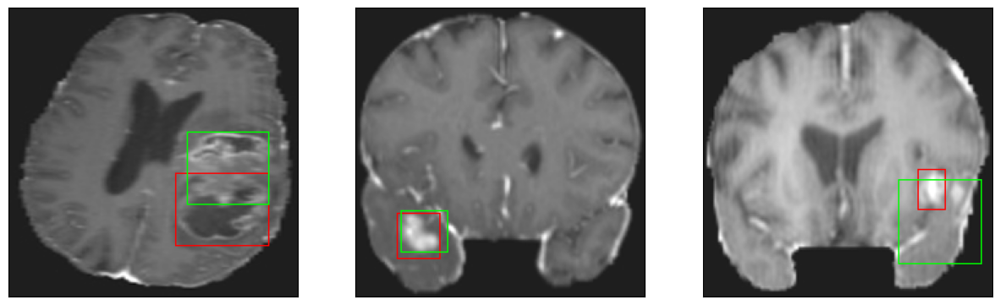

26/26 [==============================] - 8s 308ms/step - loss: 5.4784 - IoU: 0.5915 - val_loss: 8.2574 - val_IoU: 0.5365
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.0821 - IoU: 0.6062
Epoch 177: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


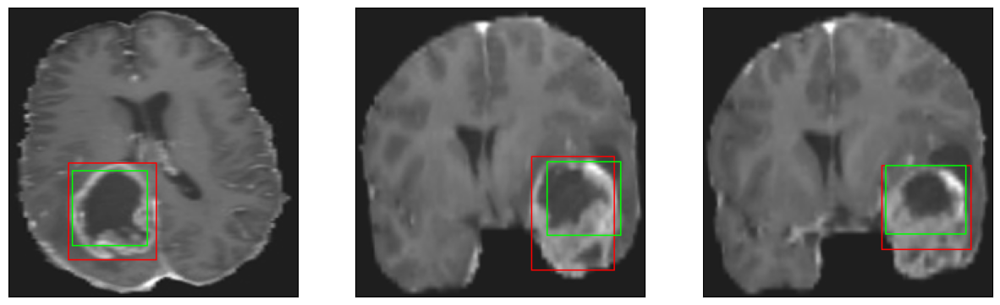

26/26 [==============================] - 8s 300ms/step - loss: 5.0821 - IoU: 0.6062 - val_loss: 8.3079 - val_IoU: 0.5466
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.2585 - IoU: 0.5920
Epoch 178: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


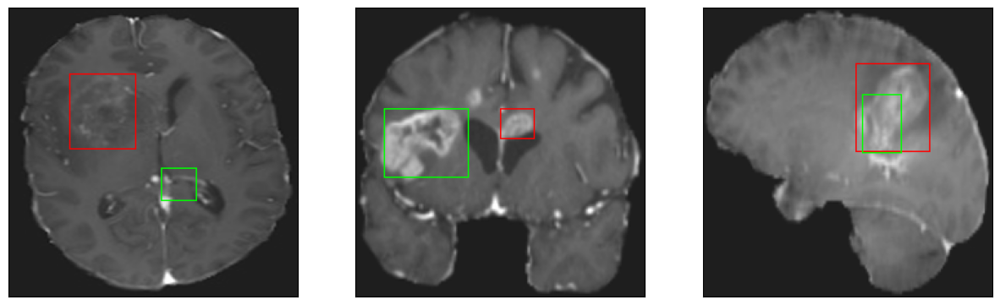

26/26 [==============================] - 7s 291ms/step - loss: 5.2585 - IoU: 0.5920 - val_loss: 9.1998 - val_IoU: 0.4812
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.5999 - IoU: 0.5776
Epoch 179: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


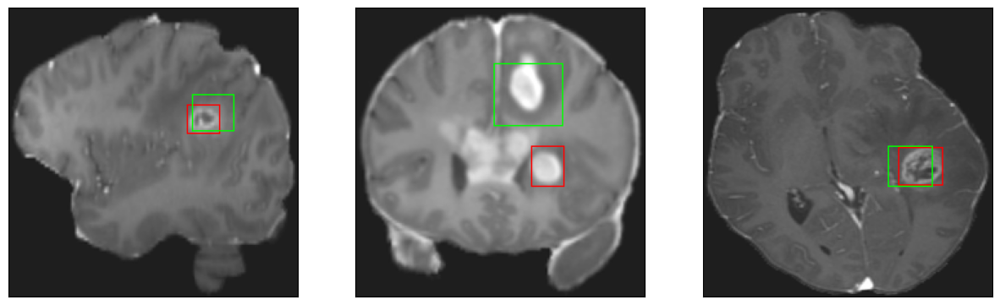

26/26 [==============================] - 8s 304ms/step - loss: 5.5999 - IoU: 0.5776 - val_loss: 9.7421 - val_IoU: 0.4624
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.0926 - IoU: 0.6059
Epoch 180: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


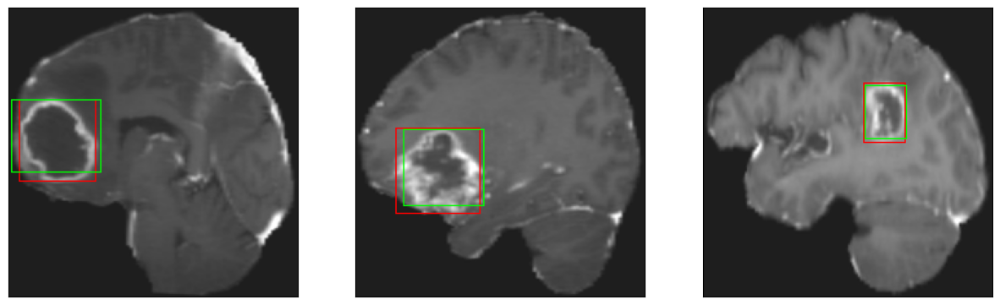

26/26 [==============================] - 8s 300ms/step - loss: 5.0926 - IoU: 0.6059 - val_loss: 8.4297 - val_IoU: 0.5157
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.3909 - IoU: 0.5868
Epoch 181: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


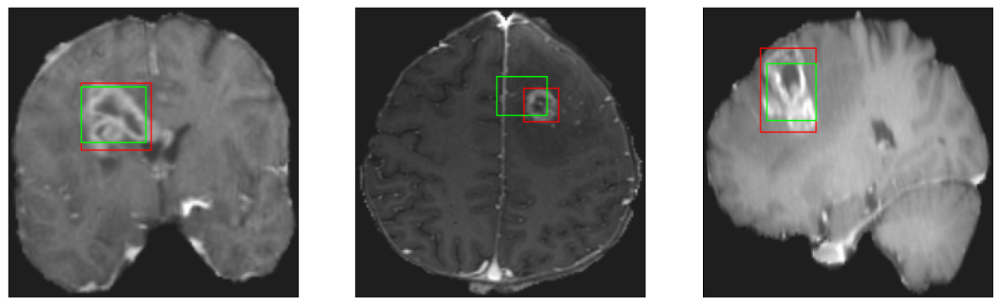

26/26 [==============================] - 8s 314ms/step - loss: 5.3909 - IoU: 0.5868 - val_loss: 8.9734 - val_IoU: 0.4738
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.1650 - IoU: 0.6052
Epoch 182: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


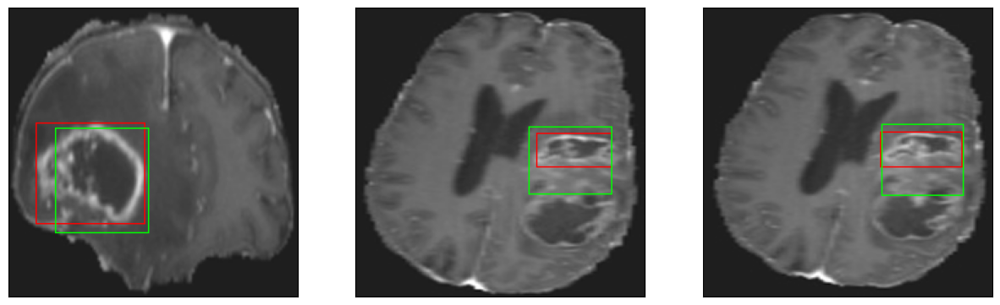

26/26 [==============================] - 8s 313ms/step - loss: 5.1650 - IoU: 0.6052 - val_loss: 7.8830 - val_IoU: 0.5437
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.4060 - IoU: 0.5841
Epoch 183: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


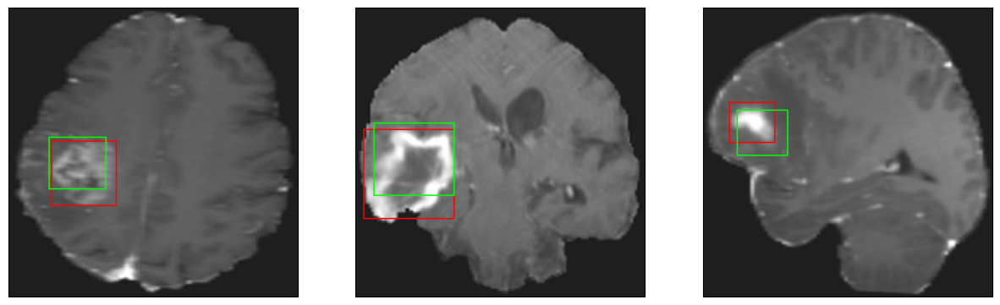

26/26 [==============================] - 8s 308ms/step - loss: 5.4060 - IoU: 0.5841 - val_loss: 8.6766 - val_IoU: 0.5183
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.3775 - IoU: 0.5858
Epoch 184: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


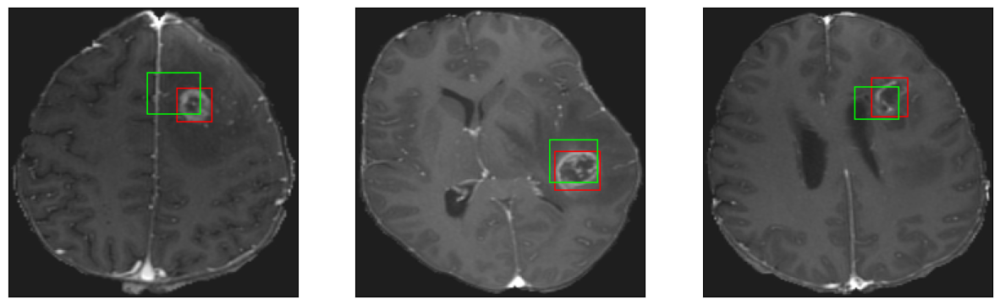

26/26 [==============================] - 8s 302ms/step - loss: 5.3775 - IoU: 0.5858 - val_loss: 8.7874 - val_IoU: 0.5066
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.2715 - IoU: 0.5970
Epoch 185: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


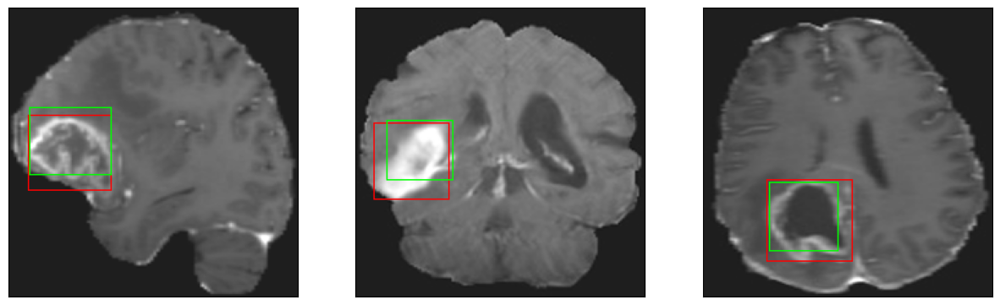

26/26 [==============================] - 8s 298ms/step - loss: 5.2715 - IoU: 0.5970 - val_loss: 8.1050 - val_IoU: 0.5468
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.1316 - IoU: 0.5915
Epoch 186: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


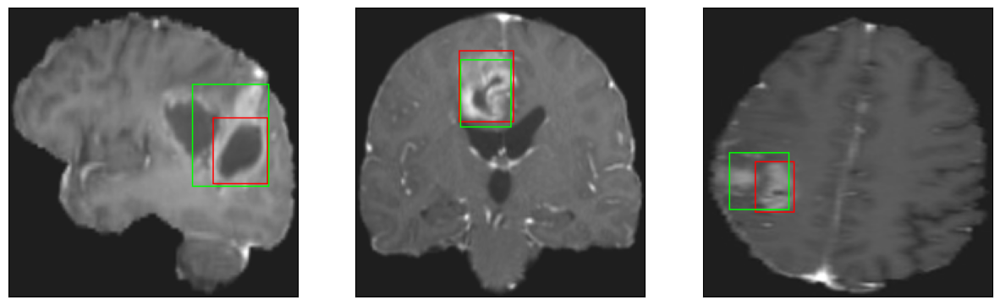

26/26 [==============================] - 8s 313ms/step - loss: 5.1316 - IoU: 0.5915 - val_loss: 9.5273 - val_IoU: 0.4796
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.7519 - IoU: 0.5605
Epoch 187: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


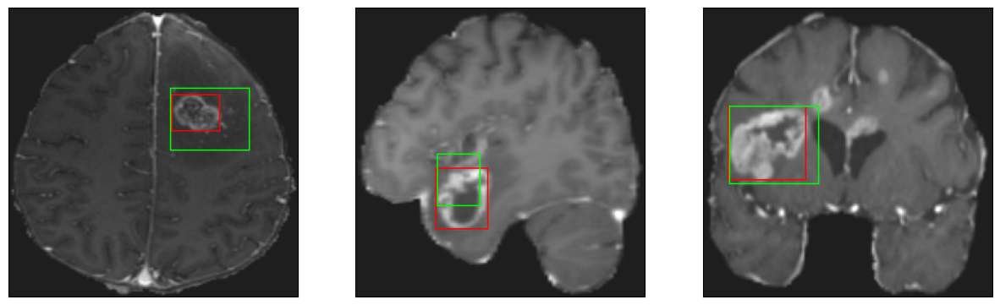

26/26 [==============================] - 8s 308ms/step - loss: 5.7519 - IoU: 0.5605 - val_loss: 9.0826 - val_IoU: 0.4836
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.3441 - IoU: 0.5844
Epoch 188: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


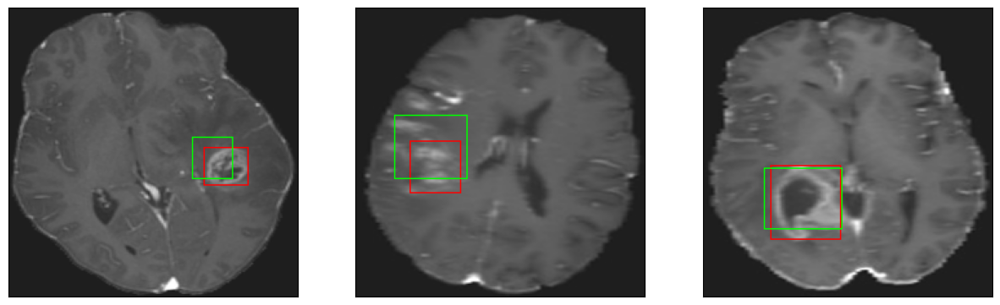

26/26 [==============================] - 8s 312ms/step - loss: 5.3441 - IoU: 0.5844 - val_loss: 8.5974 - val_IoU: 0.5204
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.9429 - IoU: 0.6189
Epoch 189: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


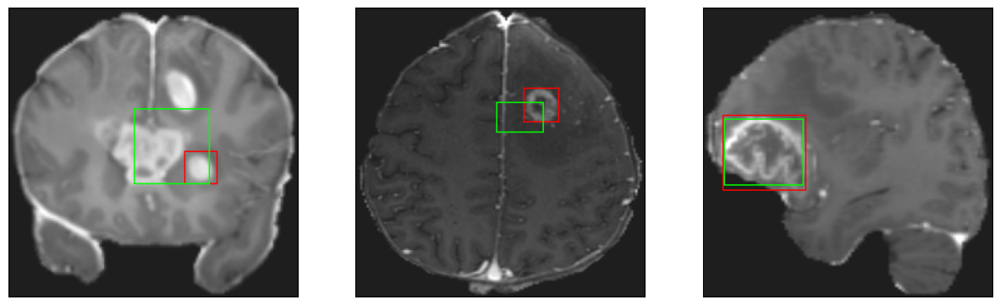

26/26 [==============================] - 8s 310ms/step - loss: 4.9429 - IoU: 0.6189 - val_loss: 8.4169 - val_IoU: 0.5263
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.2967 - IoU: 0.5999
Epoch 190: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


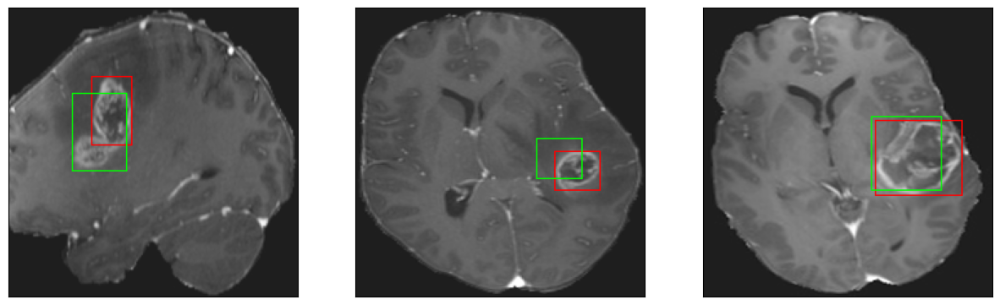

26/26 [==============================] - 8s 290ms/step - loss: 5.2967 - IoU: 0.5999 - val_loss: 9.0575 - val_IoU: 0.4943
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.0994 - IoU: 0.5975
Epoch 191: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


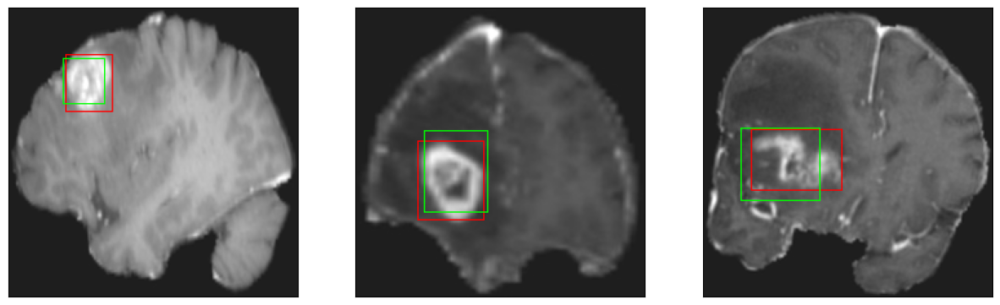

26/26 [==============================] - 7s 285ms/step - loss: 5.0994 - IoU: 0.5975 - val_loss: 8.4958 - val_IoU: 0.5213
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.4440 - IoU: 0.5896
Epoch 192: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


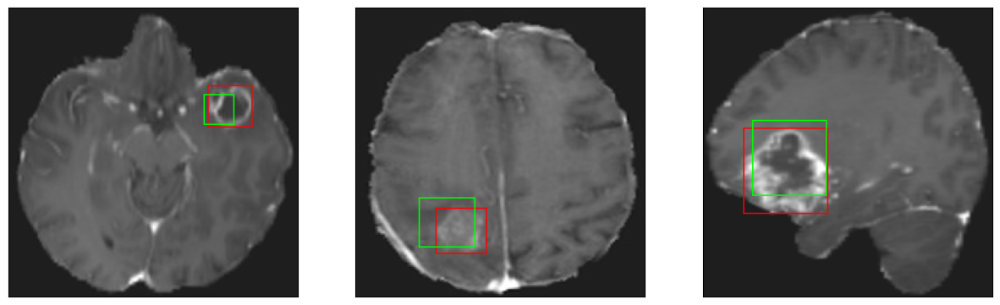

26/26 [==============================] - 8s 316ms/step - loss: 5.4440 - IoU: 0.5896 - val_loss: 9.5614 - val_IoU: 0.4548
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.4252 - IoU: 0.5886
Epoch 193: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


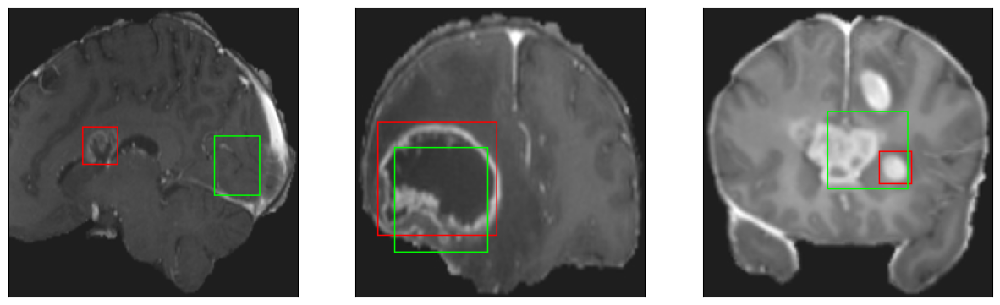

26/26 [==============================] - 7s 285ms/step - loss: 5.4252 - IoU: 0.5886 - val_loss: 8.2281 - val_IoU: 0.5336
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.0072 - IoU: 0.6120
Epoch 194: val_IoU did not improve from 0.55174
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


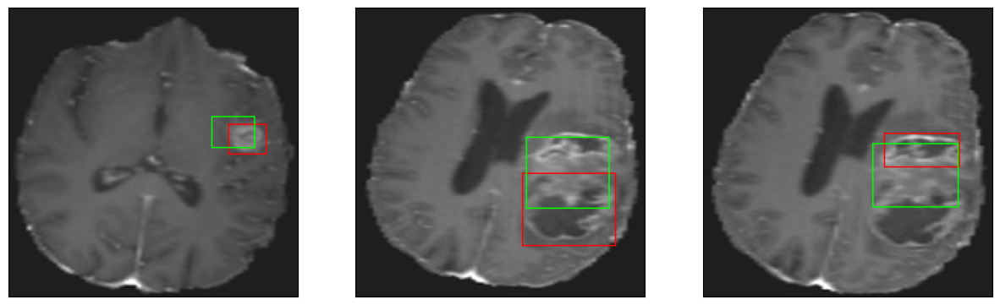

26/26 [==============================] - 8s 313ms/step - loss: 5.0072 - IoU: 0.6120 - val_loss: 8.1371 - val_IoU: 0.5302
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 4.9864 - IoU: 0.6139
Epoch 195: val_IoU improved from 0.55174 to 0.57050, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


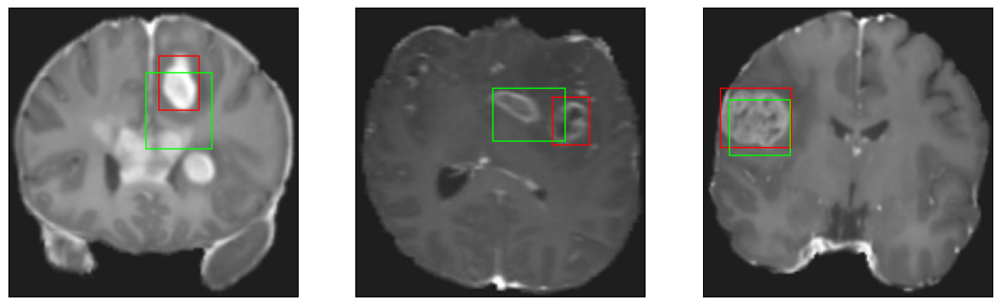

26/26 [==============================] - 23s 923ms/step - loss: 4.9864 - IoU: 0.6139 - val_loss: 7.8733 - val_IoU: 0.5705
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 5.2848 - IoU: 0.5967
Epoch 196: val_IoU did not improve from 0.57050
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


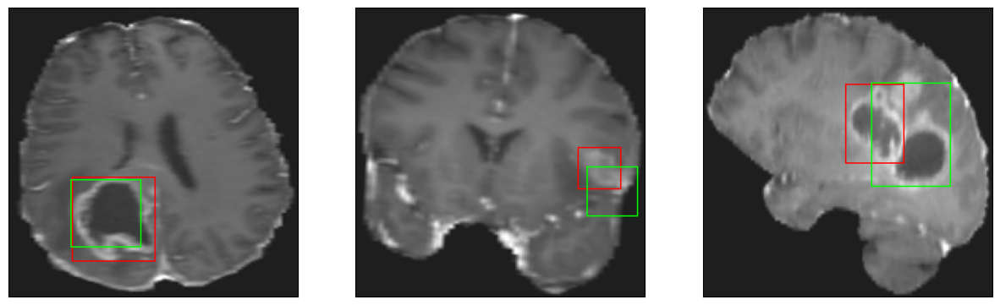

26/26 [==============================] - 8s 302ms/step - loss: 5.2848 - IoU: 0.5967 - val_loss: 8.6636 - val_IoU: 0.5122
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.2033 - IoU: 0.5891
Epoch 197: val_IoU did not improve from 0.57050
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


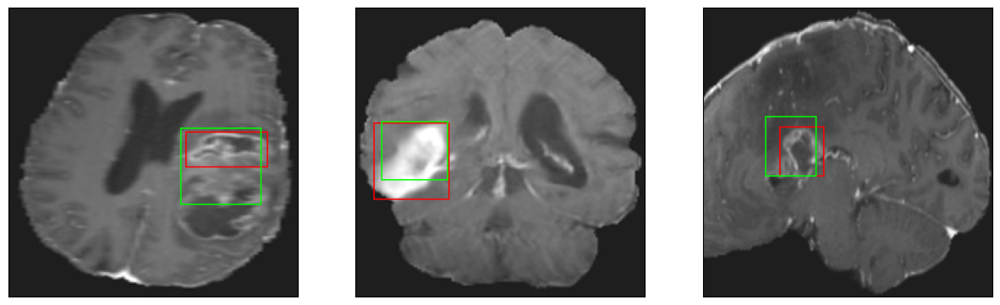

26/26 [==============================] - 8s 312ms/step - loss: 5.2033 - IoU: 0.5891 - val_loss: 8.4987 - val_IoU: 0.5261
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.7114 - IoU: 0.5719
Epoch 198: val_IoU did not improve from 0.57050
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 47ms/step
4


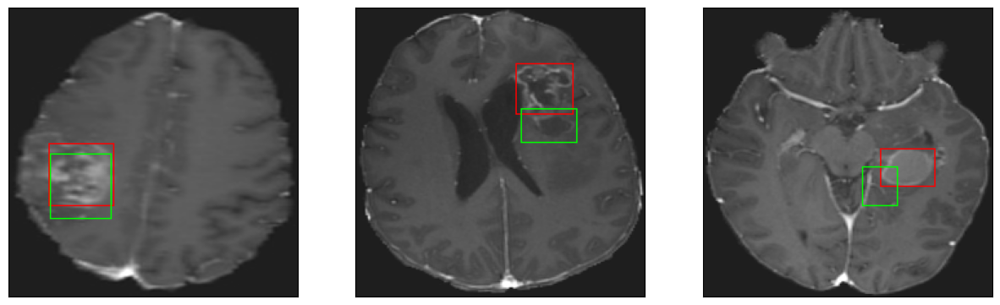

26/26 [==============================] - 8s 312ms/step - loss: 5.7114 - IoU: 0.5719 - val_loss: 8.7464 - val_IoU: 0.5253
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.3973 - IoU: 0.5766
Epoch 199: val_IoU did not improve from 0.57050
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


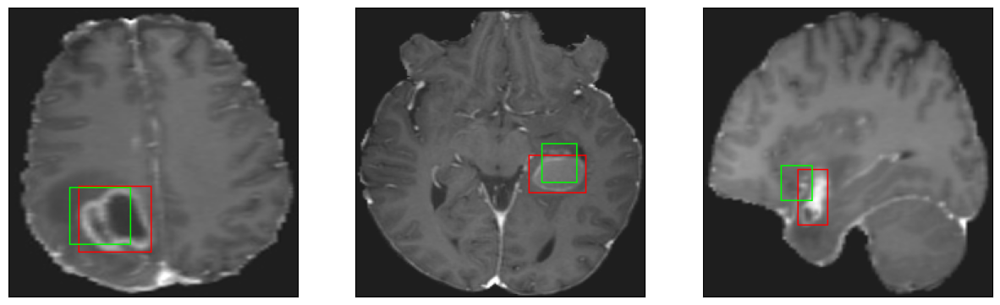

26/26 [==============================] - 8s 313ms/step - loss: 5.3973 - IoU: 0.5766 - val_loss: 8.8440 - val_IoU: 0.5113
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 4.9234 - IoU: 0.6077
Epoch 200: val_IoU did not improve from 0.57050
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


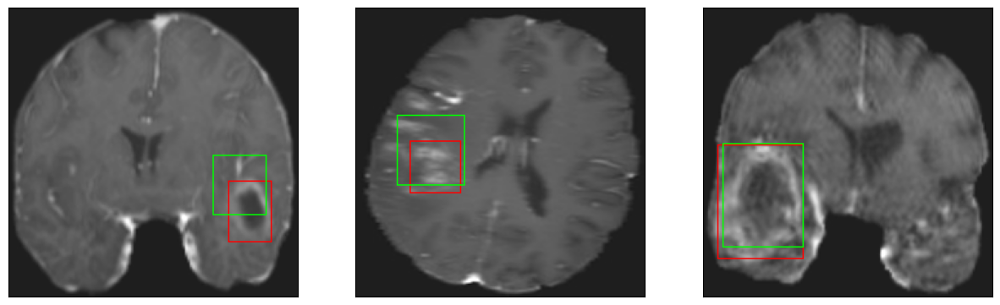

26/26 [==============================] - 8s 316ms/step - loss: 4.9234 - IoU: 0.6077 - val_loss: 9.0425 - val_IoU: 0.4817


In [ ]:
#Model fitting
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

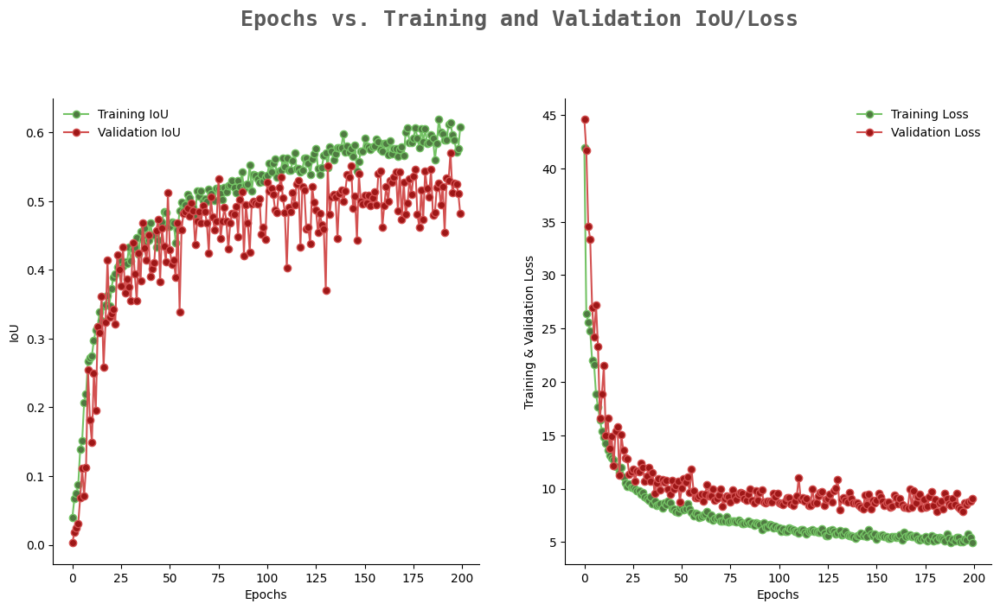

In [ ]:
#History plot
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [ ]:
%cd '../content/drive/MyDrive'

In [ ]:
#Load the model with better results
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [ ]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [ ]:
#Model evaluation in Loss and IoU for the test_dataset
model.evaluate(test_dataset)

8/8 [==============================] - 1s 56ms/step - loss: 9.2596 - IoU: 0.5125


[9.25959300994873, 0.5124812722206116]

In [ ]:
#Model evaluation in Loss and IoU for the val_dataset
model.evaluate(val_dataset)

In [ ]:
#Model evaluation in Loss and IoU for the train_dataset
model.evaluate(train_dataset)